In [1]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt

from config import Config
import utils
import model_101_crop as modellib
import visualize
from model import log
from dsb2018 import Dsb2018Dataset
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')


%matplotlib inline

def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

# Root directory of the project
ROOT_DIR = os.getcwd()

/home/keven/.virtualenvs/tensorflow/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "dsb2018_logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

In [3]:
import numpy as np
import pandas as pd
import cv2
import os
from glob import glob
from scipy.misc import imsave
from tqdm import tqdm


def combine_images(img_ids, source_dir):
    """
    Loads 4 images and combines a mosaic img usin them as follows:
        2 3
        0 1
    """
    images = [cv2.imread(os.path.join(source_dir, img_id, "images", img_id + ".png")) for img_id in img_ids]
    down = np.hstack([images[0], images[1]])
    up = np.hstack([images[2], images[3]])
    full = np.vstack([up,down])

    return full


def map_layers_left_to_right(mask, center, left_half_idx, right_half_idx):
    """
    Selects two adjacent 1-pixel stripes on the edges of left and right halves, then calculates
    how many pixels touch each other for each layer pair. Returns a map of scores.
    """
    result = np.zeros((left_half_idx.shape[0], right_half_idx.shape[0]))

    for left_i, left_id in enumerate(left_half_idx):
        for right_i, right_id in enumerate(right_half_idx):
            result[left_i, right_i] = \
                np.logical_and(
                    mask[:, center - 1, left_id],
                    mask[:, center, right_id]).sum()

    return result


def map_layers_top_to_bottom(mask, center, top_half_idx, bottom_half_idx):
    """
    Same as `map_layers_left_to_right`, but top to bottom.
    """
    result = np.zeros((top_half_idx.shape[0], bottom_half_idx.shape[0]))

    for top_i, top_id in enumerate(top_half_idx):
        for bottom_i, bottom_id in enumerate(bottom_half_idx):
            result[top_i, bottom_i] = \
                np.logical_and(
                    mask[center - 1, :, top_id],
                    mask[center, :, bottom_id]).sum()

    return result


def merge_layers(mask, intersection_map, survivor_half_idx, merged_half_idx):
    """
    Merges `merged_half_idx` channels of the mask into `survivor_half_idx`. If no intersection
    was found between layers, layers are kept.
    """
    if intersection_map.shape[0] == 0 or intersection_map.shape[1] == 0:
        return mask, 0

    merged_idx = []

    for i in range(survivor_half_idx.shape[0]):
        if intersection_map[i].max() == 0:
            continue

        survivor_id = survivor_half_idx[i]
        merged_id = merged_half_idx[intersection_map[i].argmax()]

        mask[:, :, survivor_id] = np.logical_or(mask[:, :, survivor_id], mask[:, :, merged_id])
        merged_idx.append(merged_id)

    return np.delete(mask, merged_idx, axis=-1), len(merged_idx)


def merge_layers_on_edges(mask):
    """
    First merges layers left halves to right halves, then top to bottom.
    """
    lr_center = mask.shape[1] // 2
    left_half_idx = np.argwhere(mask[:, lr_center - 1, :].sum(axis=0) > 0).flatten()
    right_half_idx = np.argwhere(mask[:, lr_center, :].sum(axis=0) > 0).flatten()
    lr_map = map_layers_left_to_right(mask, lr_center, left_half_idx, right_half_idx)
    mask, deleted_layers_count_ltr = merge_layers(mask, lr_map, left_half_idx, right_half_idx)

    tb_center = mask.shape[0] // 2
    top_half_idx = np.argwhere(mask[tb_center - 1, :, :].sum(axis=0) > 0).flatten()
    bottom_half_idx = np.argwhere(mask[tb_center, :, :].sum(axis=0) > 0).flatten()
    tb_map = map_layers_top_to_bottom(mask, tb_center, top_half_idx, bottom_half_idx)
    mask, deleted_layers_count_ttb = merge_layers(mask, tb_map, top_half_idx, bottom_half_idx)

    return mask, deleted_layers_count_ltr + deleted_layers_count_ttb


def combine_masks(img_ids, source_dir, mosaic_shape):
    """
    Loads 4 masks and combines a mosaic img using the following pattern:
        2 3
        0 1
    """
    mask_paths = [glob(os.path.join(source_dir, img_id, "masks", "**.png")) for img_id in img_ids]
    channels_count = sum([len(paths) for paths in mask_paths])
    h, w = mosaic_shape[0] // 2, mosaic_shape[1] // 2
    masks = np.zeros((*mosaic_shape, channels_count), dtype=np.bool)

    current_c = 0
    for section_i, mask_paths_section in enumerate(mask_paths):
        h_offset = h if section_i < 2 else 0
        w_offset = w if section_i == 1 or section_i == 3 else 0

        for mask_path in mask_paths_section:
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            mask = np.where(mask > 128, True, False)
            masks[h_offset:h + h_offset,
                  w_offset:w + w_offset,
                  current_c] = mask
            current_c += 1

    return masks


def combine_non_mosaic_masks(img_id, source_dir, shape):
    """
    Loads all mask related to `img_id` and stacks them together.
    """
    mask_paths = glob(os.path.join(source_dir, img_id, "masks", "**.png"))
    channels_count = len(mask_paths)
    h, w = shape
    masks = np.zeros((h, w, channels_count), dtype=np.bool)

    for i, mask_path in enumerate(mask_paths):
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        masks[:, :, i] = np.where(mask > 128, True, False)

    return masks

def extract_mosaic_ids_from_df(df):
    """
    Regroups Emil's df in a way to be used with `combine_masks` and `combine_images` (watch the order!)
    """
    mosaics = \
        df[~df.mosaic_position.isnull()] \
            .sort_values(["mosaic_idx", "mosaic_position"]) \
            .groupby("mosaic_idx") \
            .agg({ "img_id": lambda x: list(x) }) \
            .reset_index()
    non_mosaics = df[df.mosaic_position.isnull()]

    return mosaics, non_mosaics



TRAIN_DIR = "data/stage1_train"
TEST_DIR = "data/stage1_test"
TRAIN_MOSAICS_DIR = os.path.join(TRAIN_DIR, "mosaics")
TEST_MOSAICS_DIR = os.path.join(TEST_DIR, "mosaics")



In [ ]:
if not os.path.exists(TRAIN_MOSAICS_DIR):
    os.mkdir(TRAIN_MOSAICS_DIR)

if not os.path.exists(TEST_MOSAICS_DIR):
    os.mkdir(TEST_MOSAICS_DIR)

train_df = pd.read_csv("data/share_train_df.csv")
test_df = pd.read_csv('data/share_test_df.csv')

mosaics, non_mosaics = extract_mosaic_ids_from_df(train_df)
test_mosaics, test_non_mosaics = extract_mosaic_ids_from_df(test_df)

print("Generating train mosaics:")
for i, row in tqdm(mosaics.iterrows()):
    mosaic = combine_images(row["img_id"], TRAIN_DIR)
    cv2.imwrite(os.path.join(TRAIN_MOSAICS_DIR, str(row["mosaic_idx"]) + ".png"), mosaic)
    mask_mosaic = combine_masks(row["img_id"], TRAIN_DIR, mosaic.shape[:-1])
    mask_mosaic, deleted_layers_count = merge_layers_on_edges(mask_mosaic)
    np.save(os.path.join(TRAIN_MOSAICS_DIR, str(row["mosaic_idx"]) + ".npy"), mask_mosaic)

print("Copying non-mosaic train images to the same place:")
for i, row in tqdm(non_mosaics.iterrows()):
    non_mosaic = cv2.imread(os.path.join(TRAIN_DIR, row["img_id"], "images", row["img_id"] + ".png"))
    cv2.imwrite(os.path.join(TRAIN_MOSAICS_DIR, str(row["mosaic_idx"]) + ".png"), non_mosaic)
    non_mosaic_mask = combine_non_mosaic_masks(row["img_id"], TRAIN_DIR, non_mosaic.shape[:-1])
    np.save(os.path.join(TRAIN_MOSAICS_DIR, str(row["mosaic_idx"]) + ".npy"), non_mosaic_mask)

print("Generating test mosaics:")
for i, row in tqdm(test_mosaics.iterrows()):
    mosaic = combine_images(row["img_id"], TEST_DIR)
    cv2.imwrite(os.path.join(TEST_MOSAICS_DIR, str(row["mosaic_idx"]) + ".png"), mosaic)

print("Copying non-mosaic test images to the same place:")
for i, row in tqdm(test_non_mosaics.iterrows()):
    non_mosaic = cv2.imread(os.path.join(TEST_DIR, row["img_id"], "images", row["img_id"] + ".png"))
    cv2.imwrite(os.path.join(TEST_MOSAICS_DIR, str(row["mosaic_idx"]) + ".png"), non_mosaic)

In [4]:
class BowlDataset(utils.Dataset):  
    def load_bowl(self, base_path):
        """Generate the requested number of synthetic images.
        count: number of images to generate.
        height, width: the size of the generated images.
        """
        self.add_class("bowl", 1, "nuclei")
        
        masks = dict()
        # id_extractor = re.compile(base_path + "\/(?P<image_id>.*)\/masks\/(?P<mask_id>.*)\.png")
        for mask_path in glob(os.path.join(base_path, "*.npy")):
#             filter out image with too many masks
#             mask = np.load(mask_path)
#             if mask.shape[-1]>600:
#                 print("too many masks:{}".format(mask.shape[-1]))
#                 continue
            image_id=os.path.splitext(os.path.basename(mask_path))[0]
            image_path = os.path.join(base_path, image_id + ".png")
            if image_path in masks:
                masks[image_path].append(image_path)
            else:
                masks[image_path] = mask_path
        for i, (image_path, mask_paths) in enumerate(masks.items()):
            self.add_image("bowl", image_id=i, path=image_path, mask_paths=mask_paths)

    def load_image(self, image_id):
        info = self.image_info[image_id]
        return cv2.imread(info["path"])

    def load_mask(self, image_id):
        info = self.image_info[image_id]
        mask = np.load(info["mask_paths"])
        class_ids = np.ones(mask.shape[-1])
        return mask, class_ids.astype(np.int32)


Size of train data:436
Size of val data:67


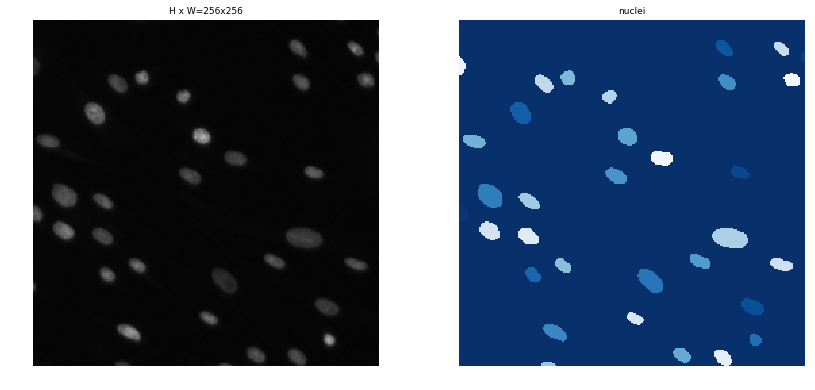

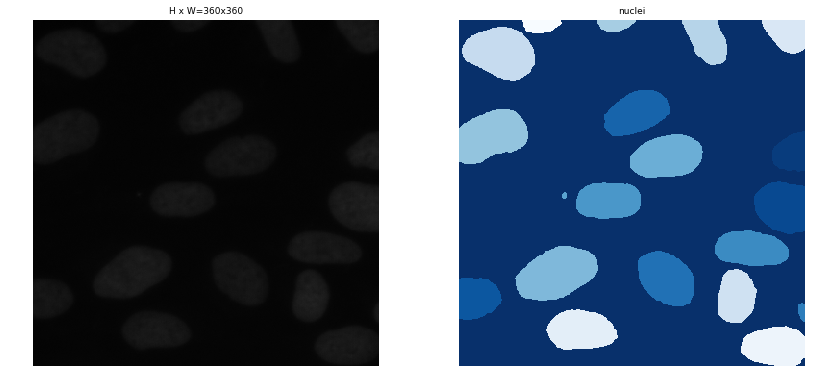

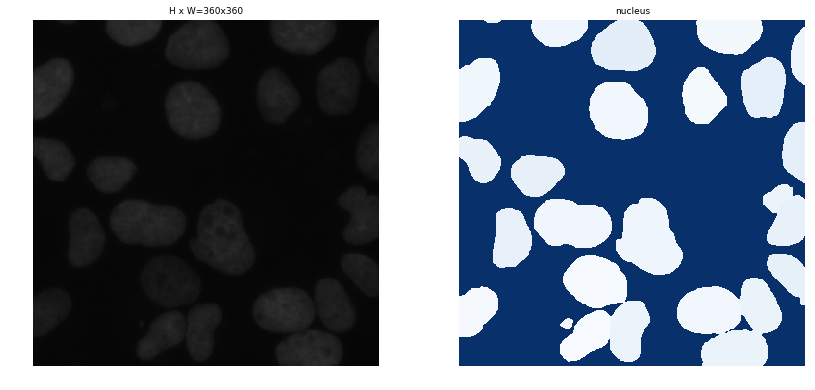

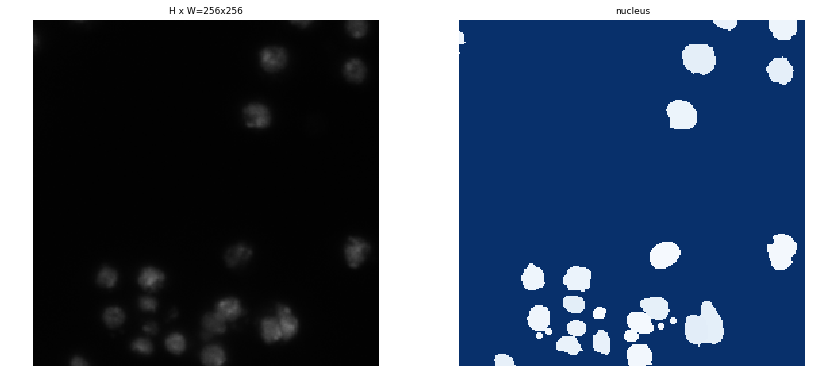

In [5]:
# Training dataset
train_data = BowlDataset()
train_data.load_bowl('data/stage1_train/mosaics')
train_data.prepare()

val_data = Dsb2018Dataset()
val_data.load_dsb2018('../DSB2018', is_trainset=False)
val_data.prepare()
print("Size of train data:{}".format(len(train_data.image_ids)))
print("Size of val data:{}".format(len(val_data.image_ids)))


#Load and display random samples
image_ids = np.random.choice(train_data.image_ids, 2)
for image_id in image_ids:
    image = train_data.load_image(image_id)
    mask, class_ids = train_data.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, train_data.class_names, limit=1)
    
    
#Load and display random samples
image_ids = np.random.choice(val_data.image_ids, 2)
for image_id in image_ids:
    image = val_data.load_image(image_id)
    mask, class_ids = val_data.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, val_data.class_names, limit=1)


In [5]:
class Dsb2018Config(Config):
    """Configuration for training on the toy shapes dataset.
    Derives from the base Config class and overrides values specific
    to the toy shapes dataset.
    """
    # Give the configuration a recognizable name
    NAME = "crop_hflip_all_mosaic_0.496_final"

    # Train on 1 GPU and 8 images per GPU. We can put multiple images on each
    # GPU because the images are small. Batch size is 8 (GPUs * images/GPU).
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

    # Number of classes (including background)
    NUM_CLASSES = 1 + 1  # background + 3 shapes

    # Use small images for faster training. Set the limits of the small side
    # the large side, and that determines the image shape.
    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512
    
    USE_MINI_MASK = True
    
    MINI_MASK_SHAPE = (256, 256)  # (height, width) of the mini-mask

    # Use smaller anchors because our image and objects are small
    RPN_ANCHOR_SCALES = (8, 16, 32, 64, 128)  # anchor side in pixels

    # Reduce training ROIs per image because the images are small and have
    # few objects. Aim to allow ROI sampling to pick 33% positive ROIs.
    
    #TODO: in trainning time, set both of these two as 100 and change to 200 during predication time!
    TRAIN_ROIS_PER_IMAGE = 720
    
    RPN_TRAIN_ANCHORS_PER_IMAGE = 768

    RPN_NMS_THRESHOLD = 0.7
    
    # changed from 300->256 for mini mask
    DETECTION_MAX_INSTANCES = 512
    
    # changed from 300->256 for mini mask
    MAX_GT_INSTANCES = 300
    
    RPN_ANCHOR_RATIOS = [0.5,1, 2]

    # Use a small epoch since the data is simple
    STEPS_PER_EPOCH = 436

    # use small validation steps since the epoch is small
    VALIDATION_STEPS = 67
    
    DETECTION_MIN_CONFIDENCE = 0.7

config = Dsb2018Config()

# Create model in training mode
model = modellib.MaskRCNN(mode="training", config=config,
                          model_dir=MODEL_DIR)

# Which weights to start with?
init_with = "coco"  # imagenet, coco, or last

if init_with == "imagenet":
    model.load_weights(model.get_imagenet_weights(), by_name=True)
elif init_with == "coco":
    # Load weights trained on MS COCO, but skip layers that
    # are different due to the different number of classes
    # See README for instructions to download the COCO weights
    model.load_weights(COCO_MODEL_PATH, by_name=True,
                       exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",
                                "mrcnn_bbox", "mrcnn_mask"])
elif init_with == "last":
    # Load the last model you trained and continue training
    model.load_weights(model.find_last()[1], by_name=True)

print("model ready!")

using architecture:resnet101
model ready!


val data:
15
{'channels': 3, 'r': 1024, 'c': 1024}


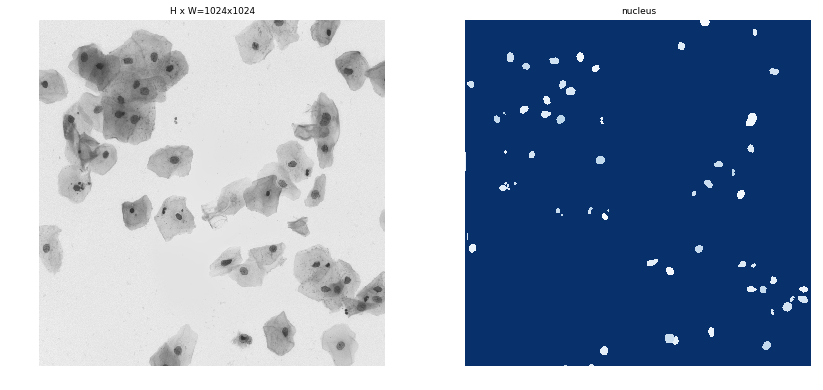

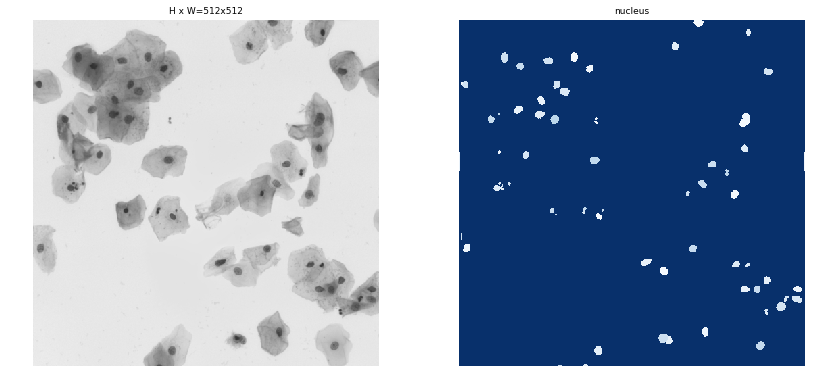

20
{'channels': 3, 'r': 256, 'c': 320}


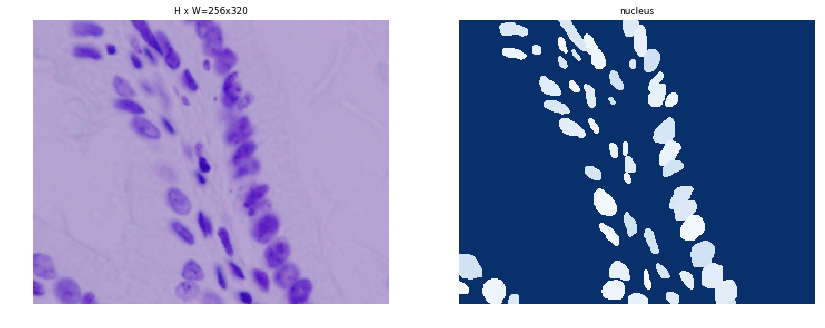

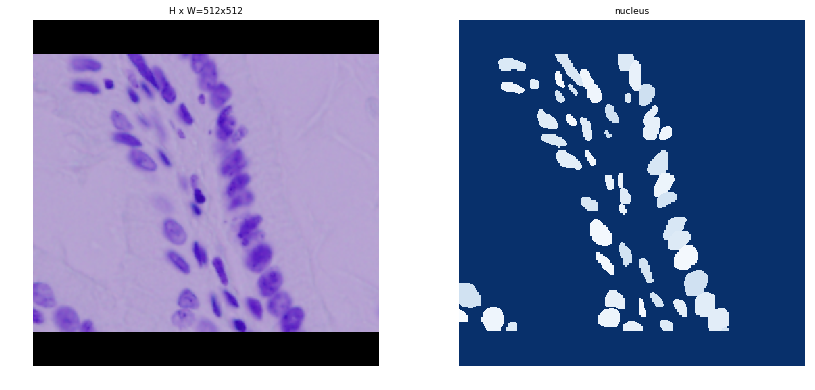

65
{'channels': 3, 'r': 360, 'c': 360}


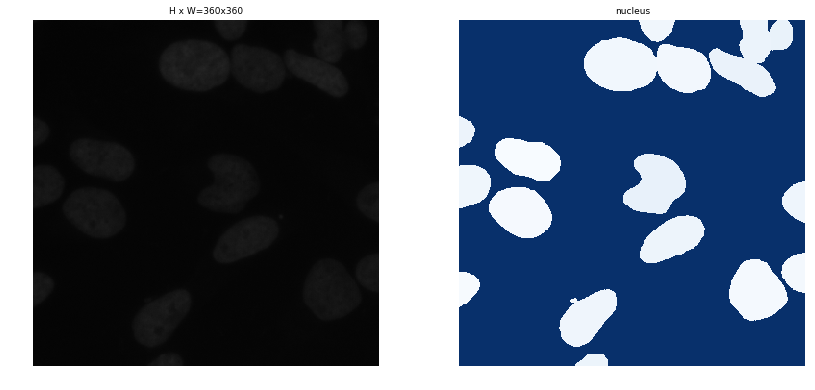

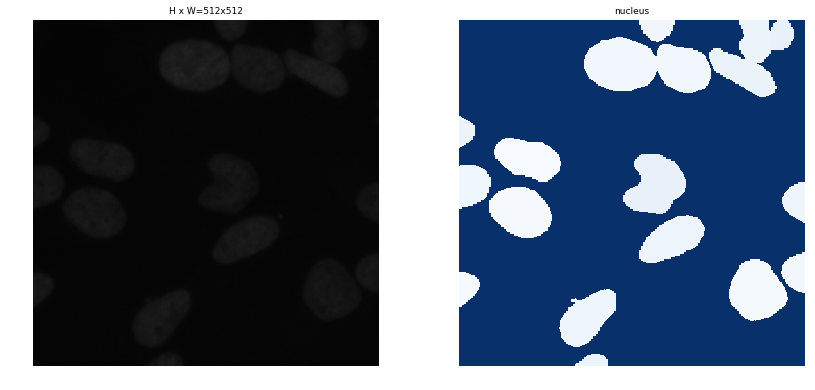

In [7]:
from skimage.io import imread, imshow, imread_collection, concatenate_images

# print("train data:")

# image_ids = np.random.choice(train_data.image_ids, 1)
# for image_id in image_ids:
#     image = train_data.load_image(image_id)
#     mask, class_ids = train_data.load_mask(image_id)
#     visualize.display_top_masks(image, mask, class_ids, train_data.class_names, limit=1)
#     output_image, _, class_ids, _, output_masks = modellib.load_image_gt(train_data, config, image_id, augment=True, use_mini_mask = False)
#     visualize.display_top_masks(output_image, output_masks, class_ids, train_data.class_names, limit=1)
  

print("val data:")
image_ids = np.random.choice(val_data.image_ids, 3)
for image_id in image_ids:
# for image_id in val_data.image_ids:
# for image_id in [37, 44, 48]:
    print(image_id)
    image = val_data.load_image(image_id)
    print(val_data.image_info[image_id]['shape'])
    mask, class_ids = val_data.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, val_data.class_names, limit=1)
    output_image, _, class_ids, _, output_masks = modellib.load_image_gt(val_data, config, image_id, augment=False, use_mini_mask = False)
    visualize.display_top_masks(output_image, output_masks, class_ids, val_data.class_names, limit=1)



In [8]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [ ]:
# Train the head branches
# Passing layers="heads" freezes all layers except the head
# layers. You can also pass a regular expression to select
# which layers to train by name pattern.

LEARNING_RATE=1e-5

# model.train(train_data, val_data,
#             learning_rate=config.LEARNING_RATE,
#             epochs=800,
#             layers='all')

model.train(train_data, val_data,
             learning_rate=config.LEARNING_RATE,
             epochs=200,
             layers='all')


Starting at epoch 0. LR=0.001

Checkpoint Path: /home/keven/data_science_bowl_2018/Mask_RCNN/dsb2018_logs/crop_hflip_all_mosaic_0.496_final20180410T0005/mask_rcnn_crop_hflip_all_mosaic_0.496_final_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (

Epoch 1/200
436/436 [==============================] - 333s 763ms/step - loss: 1.4424 - rpn_class_loss: 0.0835 - rpn_bbox_loss: 0.6585 - mrcnn_class_loss: 0.0918 - mrcnn_bbox_loss: 0.2674 - mrcnn_mask_loss: 0.3412 - val_loss: 0.9551 - val_rpn_class_loss: 0.0346 - val_rpn_bbox_loss: 0.4269 - val_mrcnn_class_loss: 0.0925 - val_mrcnn_bbox_loss: 0.1718 - val_mrcnn_mask_loss: 0.2293
Epoch 2/200
436/436 [==============================] - 2208s 5s/step - loss: 0.8677 - rpn_class_loss: 0.0357 - rpn_bbox_loss: 0.3405 - mrcnn_class_loss: 0.1117 - mrcnn_bbox_loss: 0.1636 - mrcnn_mask_loss: 0.2161 - val_loss: 0.8246 - val_rpn_class_loss: 0.0246 - val_rpn_bbox_loss: 0.3237 - val_mrcnn_class_loss: 0.0975 - val_mrcnn_bbox_loss: 0.1564 - val_mrcnn_mask_loss: 0.2224
Epoch 3/200
436/436 [==============================] - 2188s 5s/step - loss: 0.7806 - rpn_class_loss: 0.0281 - rpn_bbox_loss: 0.2781 - mrcnn_class_loss: 0.1109 - mrcnn_bbox_loss: 0.1518 - mrcnn_mask_loss: 0.2117 - val_loss: 0.7665 - val_rpn

In [6]:
import scipy.misc
        
import json
from skimage.io import imread, imshow, imread_collection, concatenate_images
import matplotlib.pyplot as plt
from utils import resize_image, resize_mask

class InferenceConfig(Dsb2018Config):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    DETECTION_MIN_CONFIDENCE = 0.7
    # changed from 300->256 for mini mask
    DETECTION_MAX_INSTANCES = 512

inference_config = InferenceConfig()

# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference", 
                          config=inference_config,
                          model_dir=MODEL_DIR)

# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, ".h5 file name here")
# model_path = model.find_last()[1]
model_path = '/home/keven/data_science_bowl_2018/Mask_RCNN/dsb2018_logs/crop_hflip_all_mosaic_0.493_valloss_fix_nominimask20180406T2259/mask_rcnn_crop_hflip_all_mosaic_0.493_valloss_fix_nominimask_0035.h5'
print(model_path)

# Load trained weights (fill in path to trained weights here)
assert model_path != "", "Provide path to trained weights"
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

def load_testset(pathname):
    dictionaries = []
    with open(pathname) as data:
        dictionaries = json.load(data)
    return dictionaries

base_dir = '../DSB2018'

test_set = load_testset(os.path.join(base_dir, 'test.json'))

using architecture:resnet101
/home/keven/data_science_bowl_2018/Mask_RCNN/dsb2018_logs/crop_hflip_all_mosaic_0.493_valloss_fix_nominimask20180406T2259/mask_rcnn_crop_hflip_all_mosaic_0.493_valloss_fix_nominimask_0035.h5
Loading weights from  /home/keven/data_science_bowl_2018/Mask_RCNN/dsb2018_logs/crop_hflip_all_mosaic_0.493_valloss_fix_nominimask20180406T2259/mask_rcnn_crop_hflip_all_mosaic_0.493_valloss_fix_nominimask_0035.h5


563
raw shape:(256, 256, 3)
original_image           shape: (512, 512, 3)         min:    2.00000  max:   90.00000
image_meta               shape: (10,)                 min:    0.00000  max:  563.00000
gt_class_id              shape: (11,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (11, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 11)        min:    0.00000  max:  255.00000


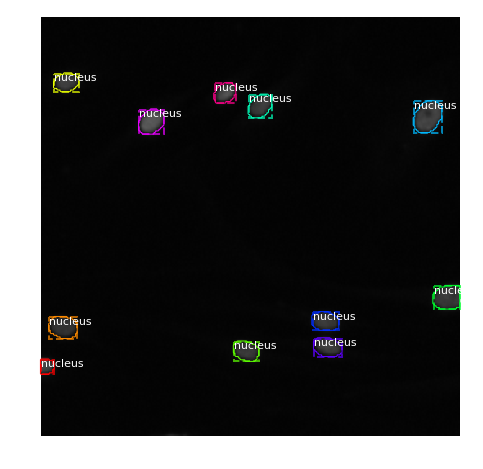

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:   90.00000
molded_images            shape: (1, 512, 512, 3)      min: -121.70000  max:  -13.90000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


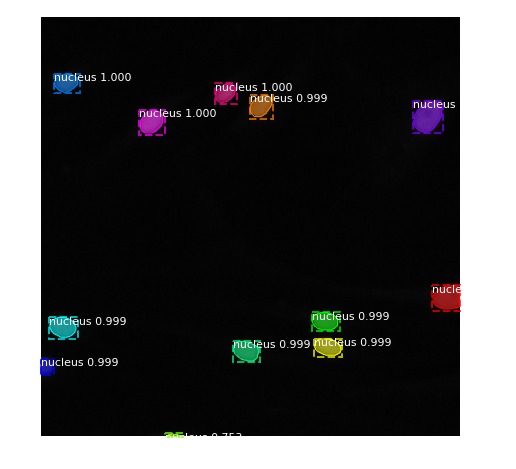

In [18]:
# Test on a random train image
# try 8
# image_id = random.choice(train_data.image_ids)
image_id=563
print(image_id)
image = train_data.load_image(image_id)
original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(train_data, inference_config, 
                           image_id, use_mini_mask=False)
print("raw shape:{}".format(image.shape))
log("original_image", original_image)
log("image_meta", image_meta)
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)


visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                            train_data.class_names, figsize=(8, 8))

# mask, class_ids = train_data.load_mask(image_id)
# visualize.display_top_masks(original_image, mask, class_ids, train_data.class_names, limit=1)

results = model.detect([original_image], verbose=1)

r = results[0]
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            train_data.class_names, r['scores'], ax=get_ax())

9
raw shape:(256, 320, 3)
original_image           shape: (512, 512, 3)         min:    0.00000  max:  237.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (45,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (45, 4)               min:    0.00000  max:  509.00000
gt_mask                  shape: (512, 512, 45)        min:    0.00000  max:  255.00000
img size:(512, 512, 3)
mask size:(512, 512, 45)


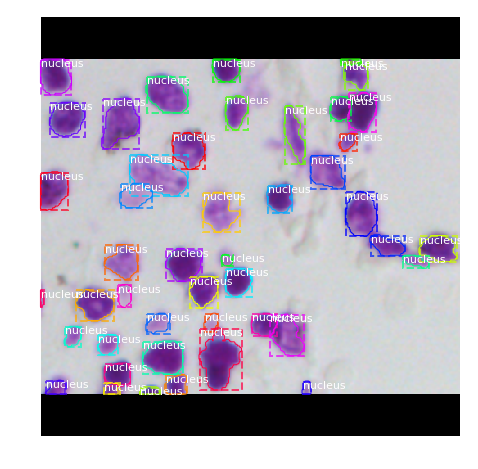

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  237.00000
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  133.10000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


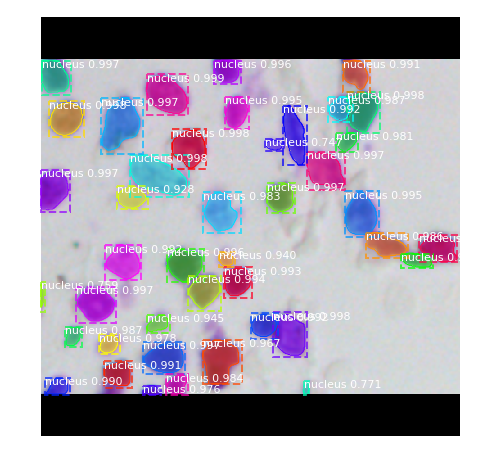

In [19]:
# Test on a random validation image
image_id = random.choice(val_data.image_ids)
# image_id=17, 29, 52
# image_id=18
print(image_id)
image = val_data.load_image(image_id)

original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(val_data, inference_config, 
                           image_id, use_mini_mask=False)

print("raw shape:{}".format(image.shape))
log("original_image", original_image)
log("image_meta", image_meta)
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

print("img size:{}".format(original_image.shape))
print("mask size:{}".format(gt_mask.shape))

visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                            val_data.class_names, figsize=(8, 8))


results = model.detect([original_image], verbose=1)

r = results[0]
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            val_data.class_names, r['scores'], ax=get_ax())



53
{'image': {'checksum': '60e58d0b01c10ce966f805e8ef879c09', 'pathname': '505bc0a3928d8aef5ce441c5a611fdd32e1e8eccdc15cc3a52b88030acb50f81.png', 'shape': {'r': 512, 'c': 640, 'channels': 3}}, 'objects': []}
original shape:(512, 640, 3)
resized shape:(512, 512, 3), scale:0.8, padding:[(51, 51), (0, 0), (0, 0)]


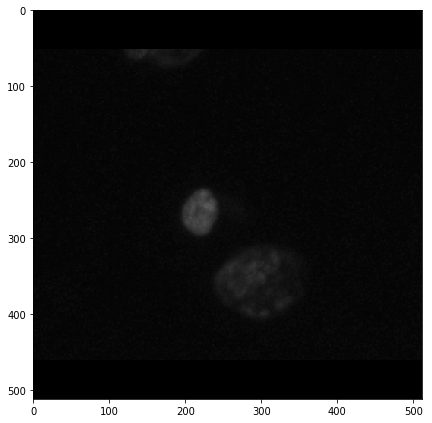

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:   97.00000
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   -6.90000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


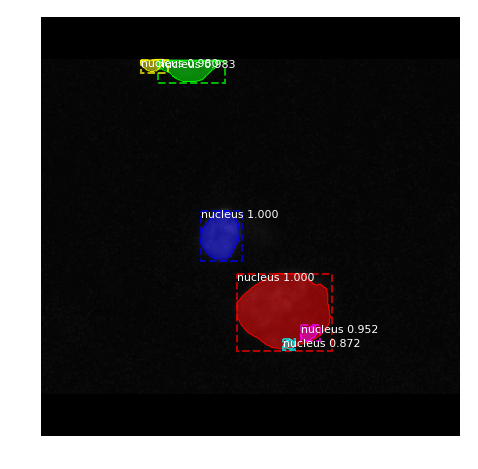

mask shape:(512, 512, 1)
(512, 410, 1)


In [18]:
# Test on a random test image

i = random.randint(0, len(test_set)-1)
print(i)
test = test_set[10]
print(test)
test_img = imread(os.path.join(base_dir, 'images', test['image']['pathname']))
print("original shape:{}".format(test_img.shape))
test_img,_, scale,padding = resize_image(test_img, min_dim=512,max_dim=512, padding=True)
print("resized shape:{}, scale:{}, padding:{}".format(test_img.shape,scale, padding))
plt.figure(figsize=(6,6))
imshow(test_img)
plt.show()

results = model.detect([test_img], verbose=1)
r = results[0]
visualize.display_instances(test_img, r['rois'], r['masks'], r['class_ids'], 
                            train_data.class_names, r['scores'], ax=get_ax())
first_mask = r['masks'][:,:,0]
first_mask = np.expand_dims(first_mask, axis=2)
print('mask shape:{}'.format(first_mask.shape))
print(resize_mask(first_mask, scale, padding).shape)

In [16]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

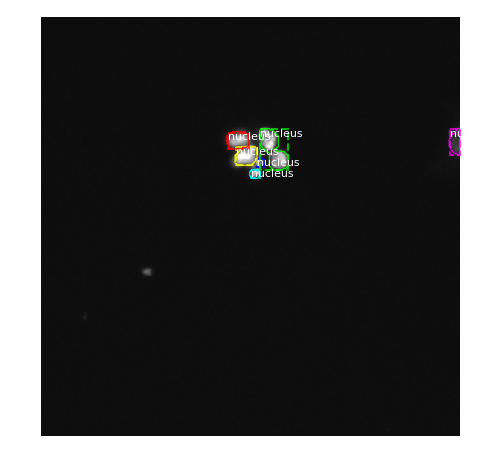

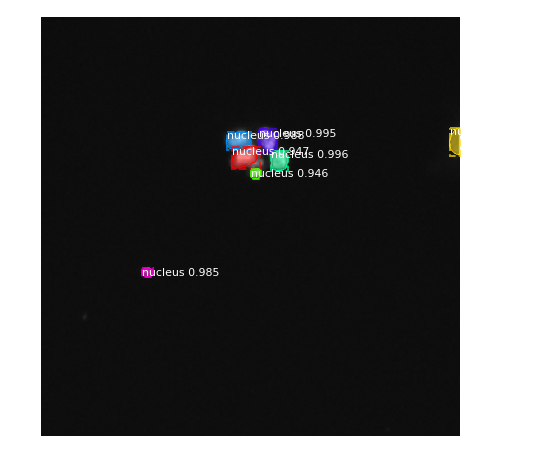

0.5 mAP: 0.45238096586295534, avg mAP:0.29285715158496584, instance_AP: [0.45238096586295534, 0.45238096586295534, 0.45238096586295534, 0.45238096586295534, 0.45238096586295534, 0.2500000074505806, 0.2500000074505806, 0.1666666716337204, 0.0, 0.0], shape:[256 256], lowest_score:0.9463711977005005, id:e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b


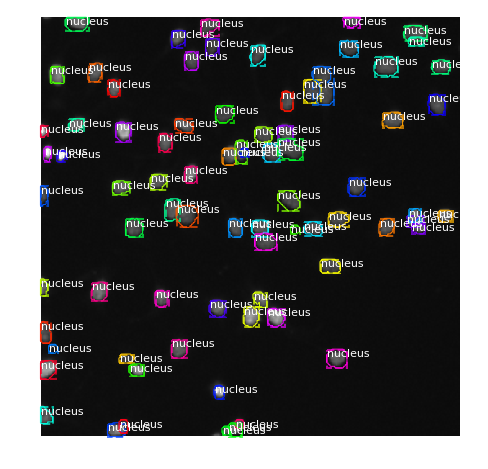

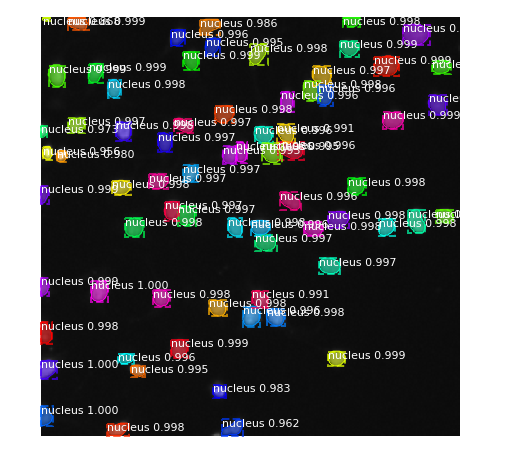

0.5 mAP: 0.8353937885451291, avg mAP:0.48948574580084714, instance_AP: [0.8353937885451291, 0.8107658741431284, 0.7628448153793906, 0.7628448153793906, 0.6823589405491206, 0.5336393971824482, 0.3391749751937836, 0.14151627242371634, 0.026318579212363278, 0.0], shape:[256 256], lowest_score:0.8683887720108032, id:1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5


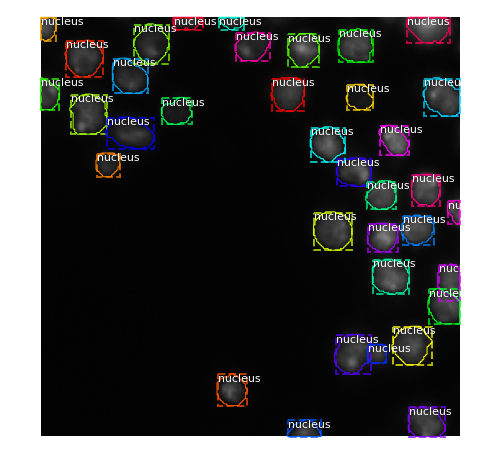

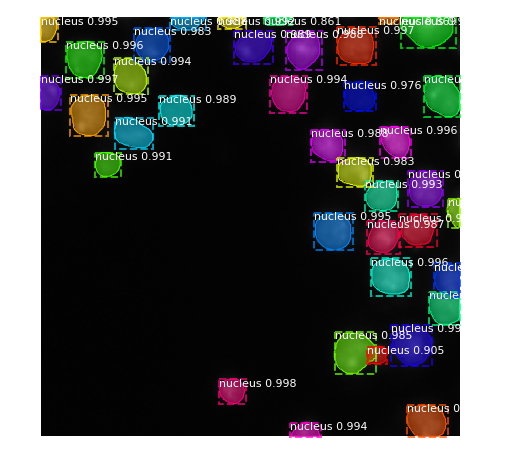

0.5 mAP: 1.0, avg mAP:0.6576584539153092, instance_AP: [1.0, 1.0, 1.0, 1.0, 0.9295734880548535, 0.7357519487539929, 0.5937328771482427, 0.29482323337684974, 0.022702991819152467, 0.0], shape:[256 256], lowest_score:0.8614873290061951, id:8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570


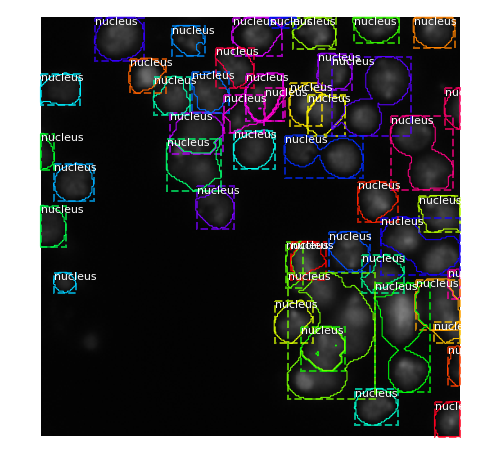

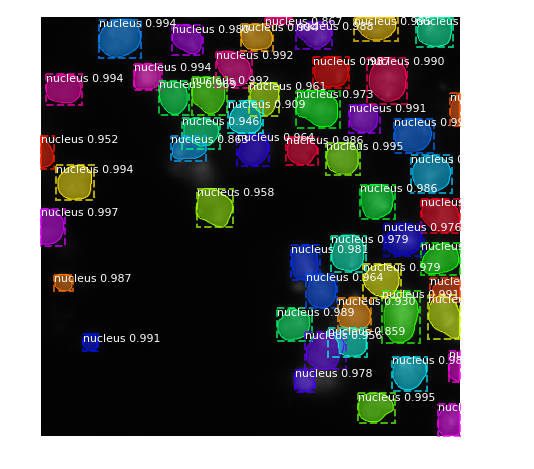

0.5 mAP: 0.43467519963442375, avg mAP:0.18903175746149578, instance_AP: [0.43467519963442375, 0.3865491689320117, 0.3865491689320117, 0.3001907452808014, 0.20795571761698473, 0.11033081602624313, 0.0640667581924815, 0.0, 0.0, 0.0], shape:[256 256], lowest_score:0.8594391345977783, id:e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0


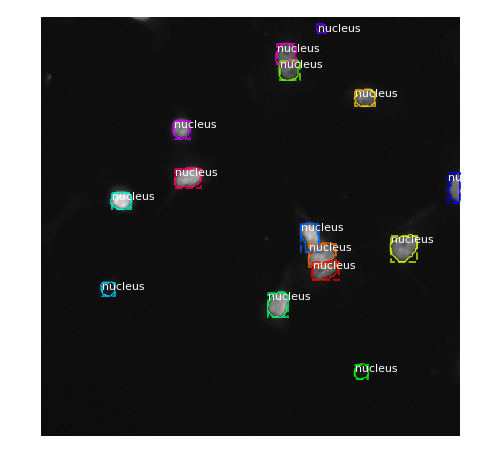

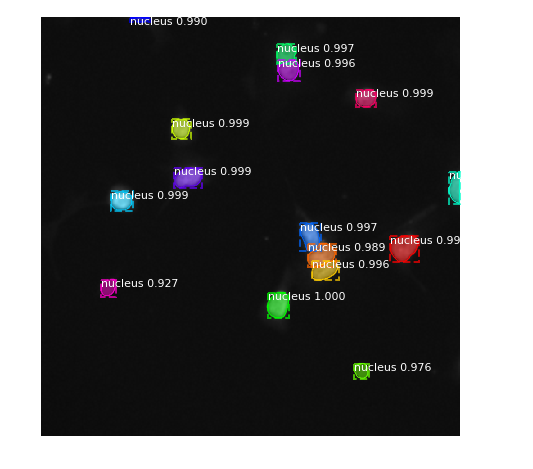

0.5 mAP: 0.9200000047683715, avg mAP:0.7309740329838612, instance_AP: [0.9200000047683715, 0.9200000047683715, 0.9200000047683715, 0.9200000047683715, 0.9200000047683715, 0.8571428656578064, 0.7904762029647827, 0.6363636553287505, 0.4090909145095132, 0.01666666753590107], shape:[256 256], lowest_score:0.9267196655273438, id:97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b


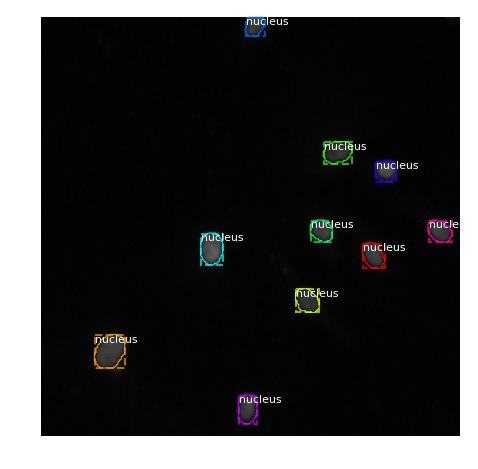

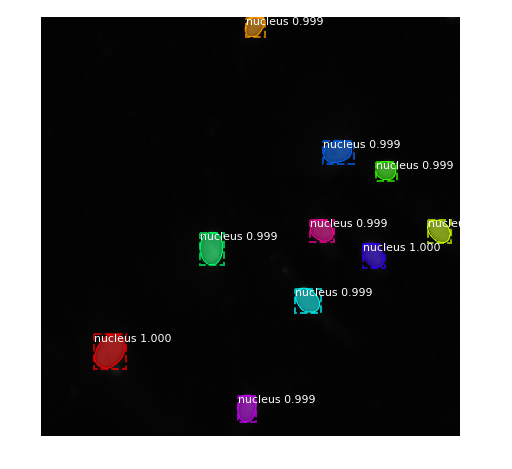

0.5 mAP: 1.0, avg mAP:0.8560000014305114, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5600000143051147, 0.0], shape:[256 256], lowest_score:0.9985153079032898, id:d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1


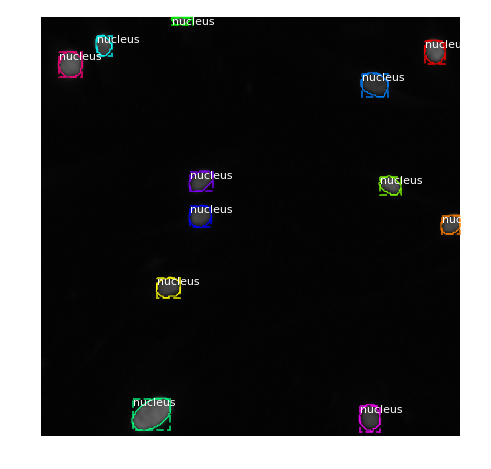

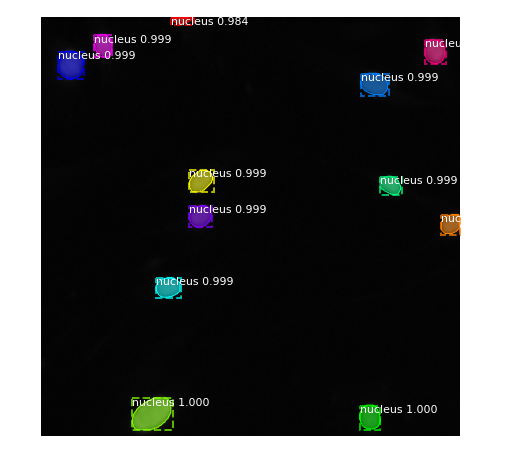

0.5 mAP: 1.0, avg mAP:0.7667658748229346, instance_AP: [1.0, 1.0, 1.0, 1.0, 0.909722238779068, 0.909722238779068, 0.7777777622143427, 0.7083333343267441, 0.3621031741301219, 0.0], shape:[256 256], lowest_score:0.9839136600494385, id:305a8baaf726d7c9e695bff31d3a6a61445999a4732f0a3e6174dc9dcbe43931


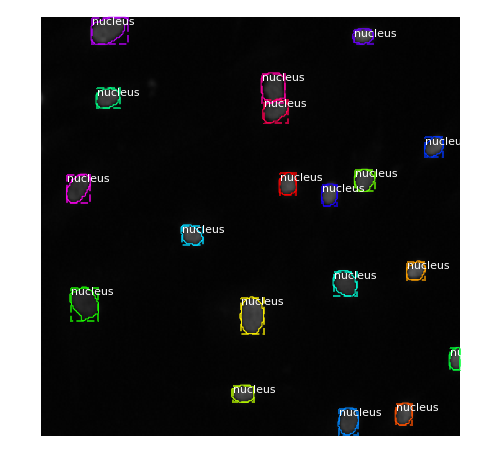

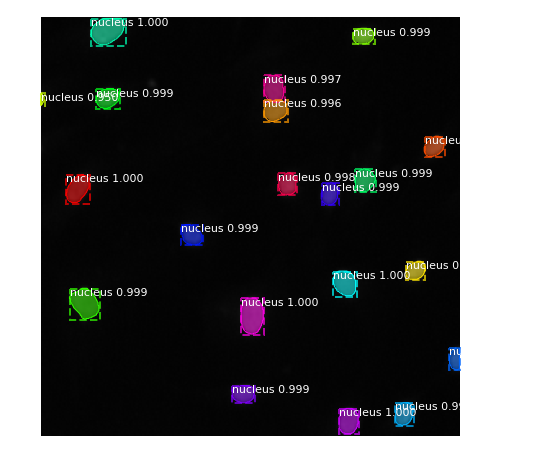

0.5 mAP: 1.0, avg mAP:0.8098984775265252, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 0.9445983579284266, 0.9445983579284266, 0.8390092954916113, 0.3707787639167873, 0.0], shape:[256 256], lowest_score:0.949510395526886, id:6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397


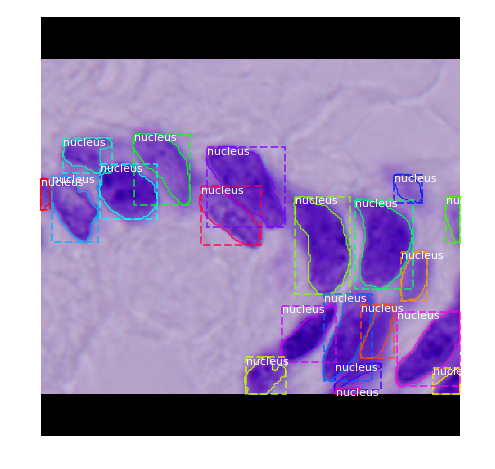

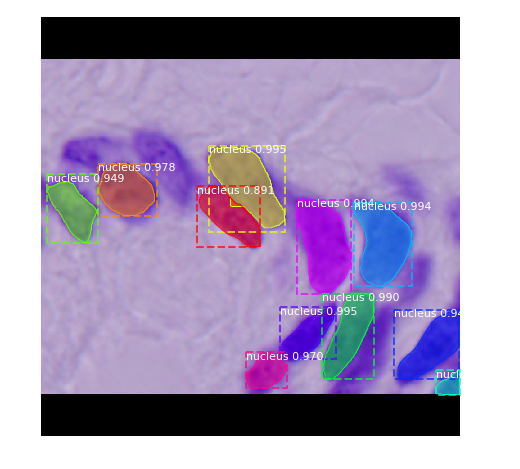

0.5 mAP: 0.550000011920929, avg mAP:0.40554545969109645, instance_AP: [0.550000011920929, 0.550000011920929, 0.550000011920929, 0.550000011920929, 0.4818181829019026, 0.4818181829019026, 0.4818181829019026, 0.33499999940395353, 0.07500000111758709, 0.0], shape:[256 320], lowest_score:0.8787277936935425, id:a90401357d50e1376354ae6e5f56a2e4dff3fdb5a4e8d50316673b2b8f1f293b


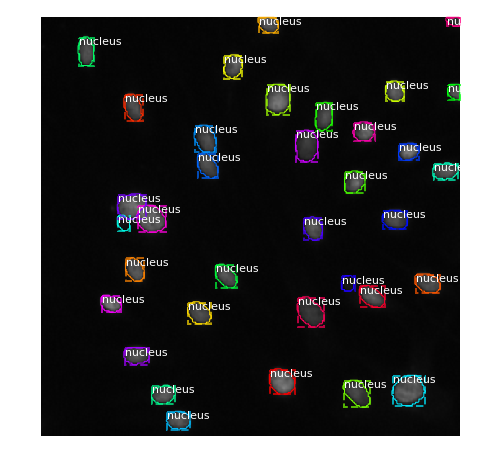

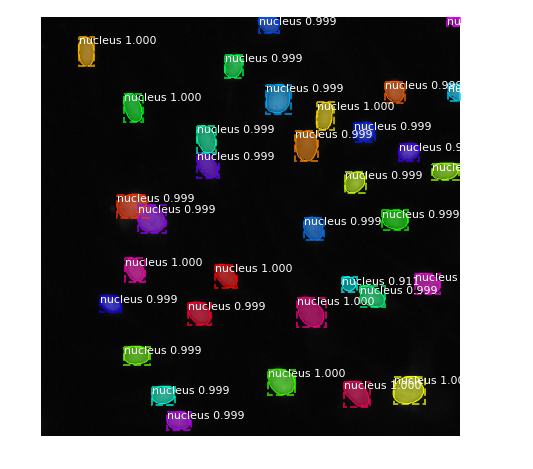

0.5 mAP: 0.9714285731315613, avg mAP:0.8225716348236622, instance_AP: [0.9714285731315613, 0.9714285731315613, 0.9714285731315613, 0.9714285731315613, 0.9714285731315613, 0.9714285731315613, 0.9428571462631226, 0.9428571462631226, 0.5095258550056043, 0.0019047619154055912], shape:[256 256], lowest_score:0.9112733006477356, id:d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28


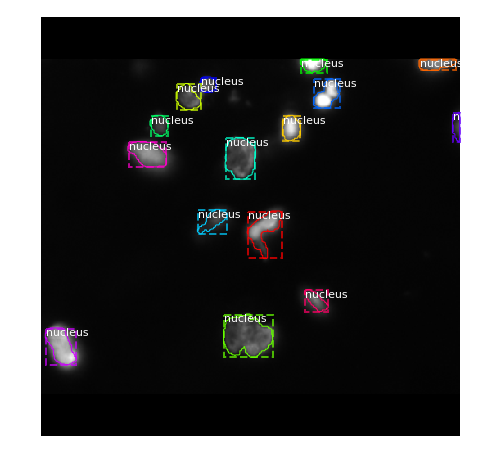

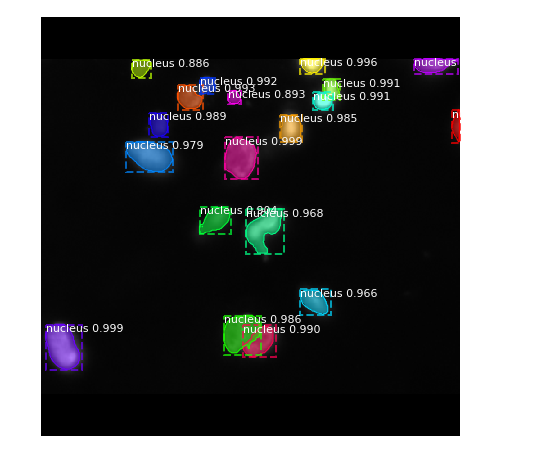

0.5 mAP: 0.8392156905987683, avg mAP:0.3787656455052918, instance_AP: [0.8392156905987683, 0.7709803998470308, 0.7200000107288362, 0.582222235451142, 0.30000000447034836, 0.30000000447034836, 0.1323809591787202, 0.07619048016411917, 0.06666667014360428, 0.0], shape:[256 320], lowest_score:0.885673999786377, id:a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380


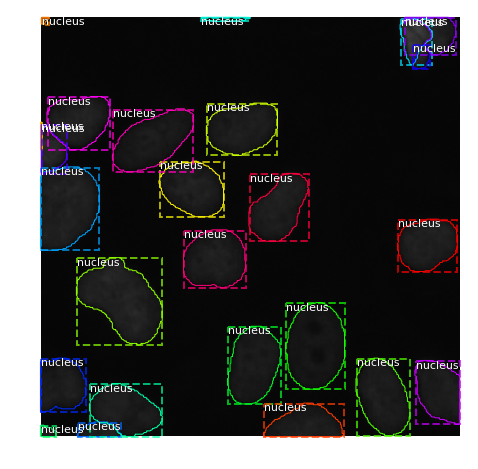

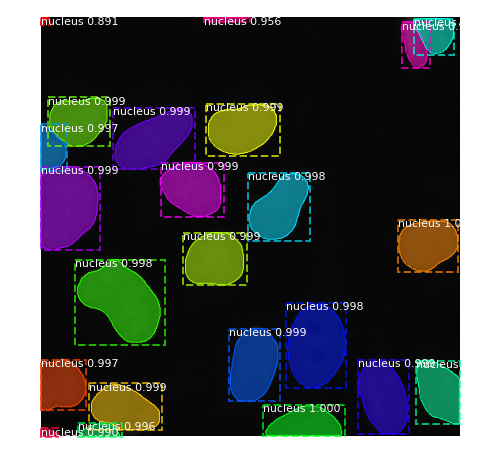

0.5 mAP: 0.9200000166893005, avg mAP:0.7006171735227558, instance_AP: [0.9200000166893005, 0.8695652122082917, 0.8695652122082917, 0.8695652122082917, 0.788516757590919, 0.788516757590919, 0.7503349216360795, 0.7503349216360795, 0.3524999972432852, 0.04727272621609948], shape:[360 360], lowest_score:0.8914750218391418, id:ac782d2cad7f515ce7276926209820e386248e3d619b2df81e22d5e3c160b7cb


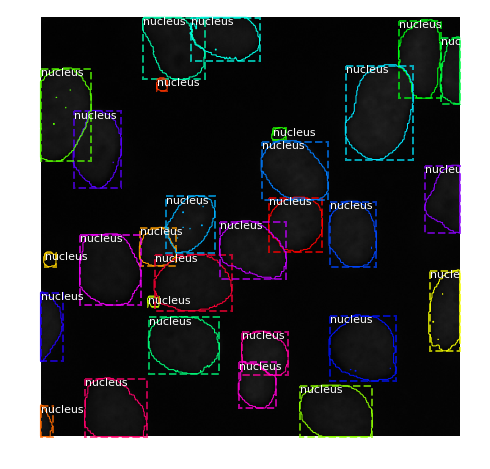

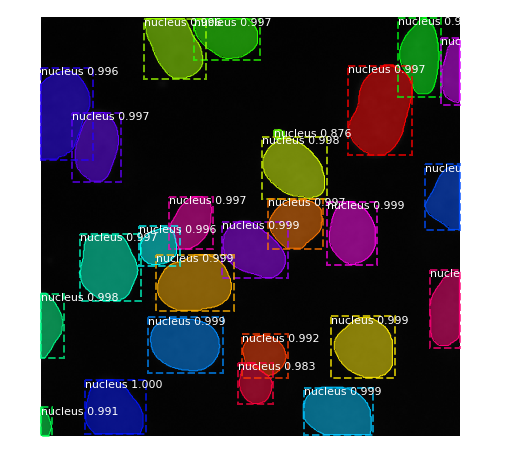

0.5 mAP: 0.8965517282485962, avg mAP:0.67989172458837, instance_AP: [0.8965517282485962, 0.8620689511299133, 0.8620689511299133, 0.8620689511299133, 0.8620689511299133, 0.8620689511299133, 0.7916666741172473, 0.5986299482052082, 0.19827586381385726, 0.003448275849223137], shape:[360 360], lowest_score:0.8764731287956238, id:b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313


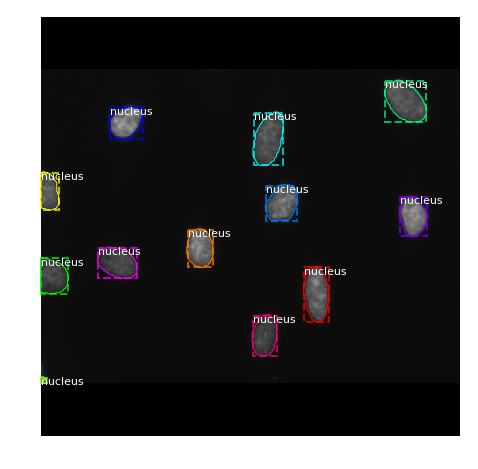

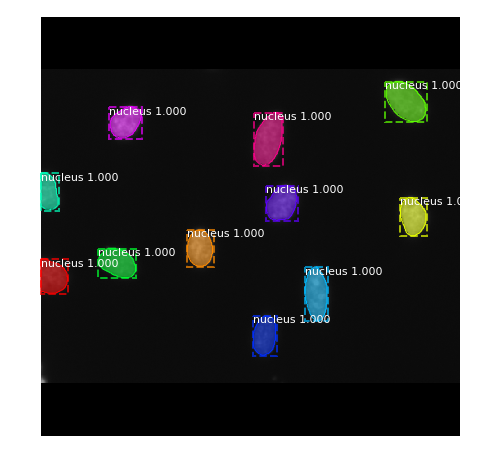

0.5 mAP: 0.9166666865348816, avg mAP:0.858371225033294, instance_AP: [0.9166666865348816, 0.9166666865348816, 0.9166666865348816, 0.9166666865348816, 0.9166666865348816, 0.9166666865348816, 0.9166666865348816, 0.9166666865348816, 0.7878787707198749, 0.462499987334013], shape:[520 696], lowest_score:0.9996374845504761, id:79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324


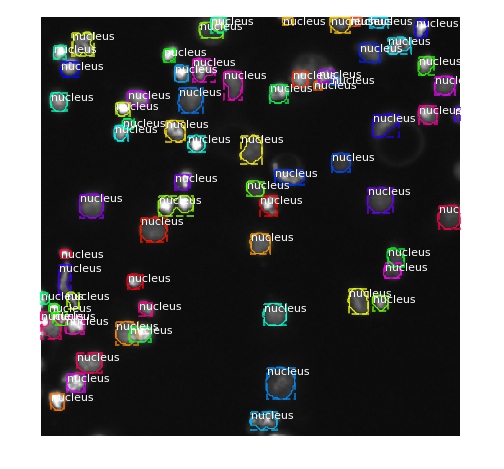

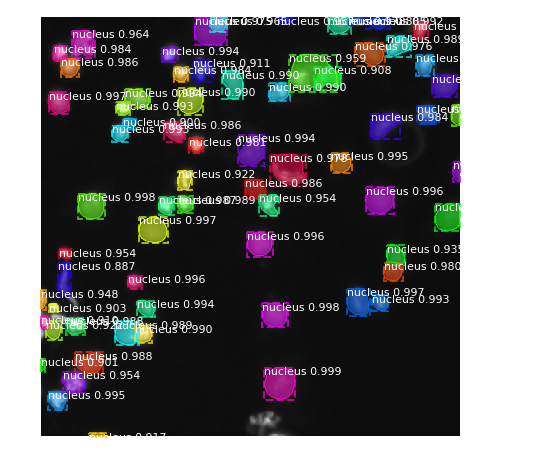

0.5 mAP: 0.7790766571614771, avg mAP:0.38767337315254297, instance_AP: [0.7790766571614771, 0.7790766571614771, 0.7649259142567125, 0.6653354975710066, 0.42261890510570577, 0.25731858174123934, 0.17316039425252386, 0.03522112427528724, 0.0, 0.0], shape:[256 256], lowest_score:0.8849068284034729, id:a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834


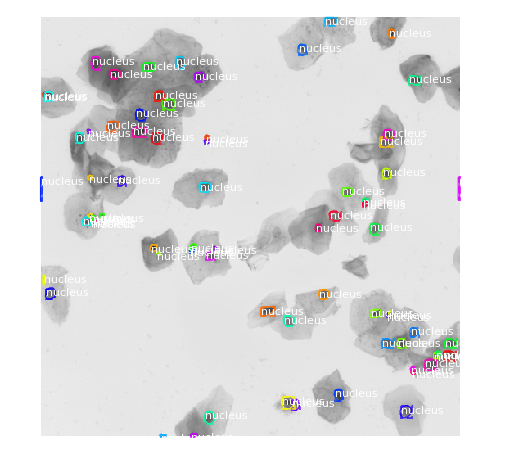

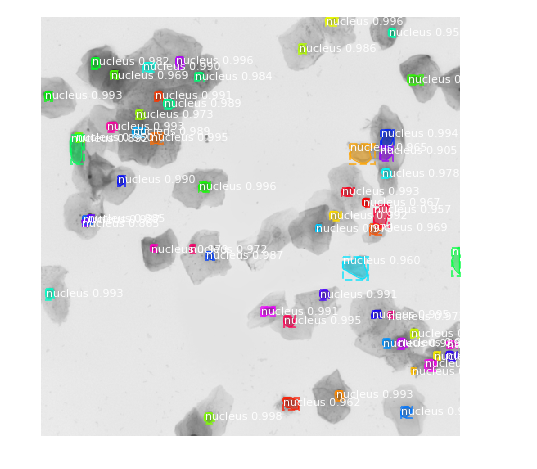

0.5 mAP: 0.5575134333002859, avg mAP:0.351248625654608, instance_AP: [0.5575134333002859, 0.5434781519834319, 0.5302629667687894, 0.5302629667687894, 0.4621921897719132, 0.404737169983965, 0.3444207084151424, 0.13885763455182312, 0.0007610350019401973, 0.0], shape:[1024 1024], lowest_score:0.864955484867096, id:54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12


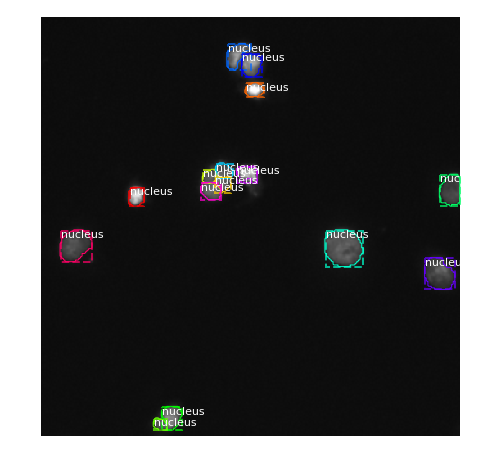

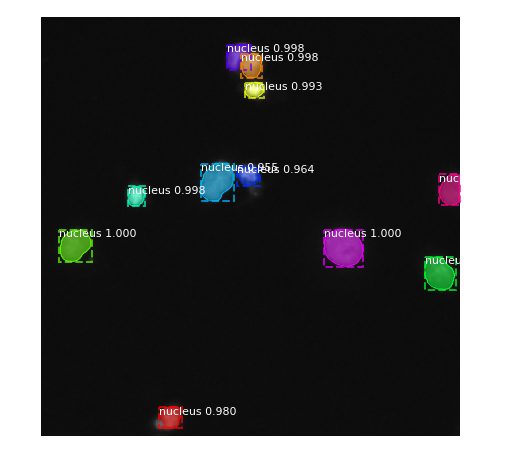

0.5 mAP: 0.6666666865348816, avg mAP:0.5025926107333766, instance_AP: [0.6666666865348816, 0.6666666865348816, 0.6666666865348816, 0.6666666865348816, 0.6000000238418579, 0.6000000238418579, 0.503703729973899, 0.3222222328186035, 0.2666666805744171, 0.06666667014360428], shape:[256 256], lowest_score:0.9553282260894775, id:3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186


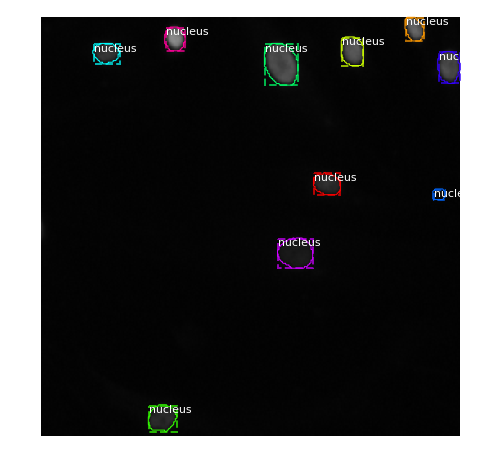

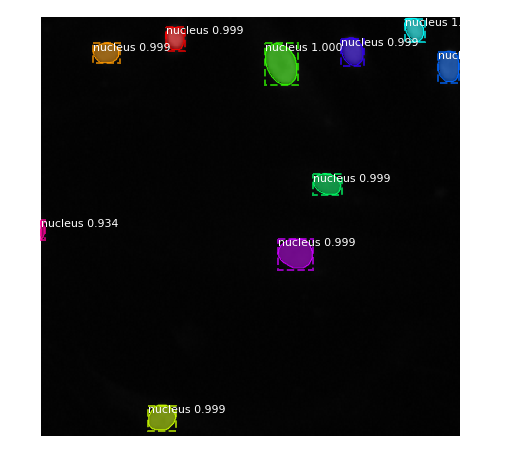

0.5 mAP: 0.8999999761581421, avg mAP:0.7845833134837449, instance_AP: [0.8999999761581421, 0.8999999761581421, 0.8999999761581421, 0.8999999761581421, 0.8999999761581421, 0.8999999761581421, 0.8999999761581421, 0.8999999761581421, 0.6333333253860474, 0.012500000186264515], shape:[256 256], lowest_score:0.9341261386871338, id:1ee4a111f0e0bb9b001121b94ff98ca736fad03797b25285fe33a47046b3e4b0


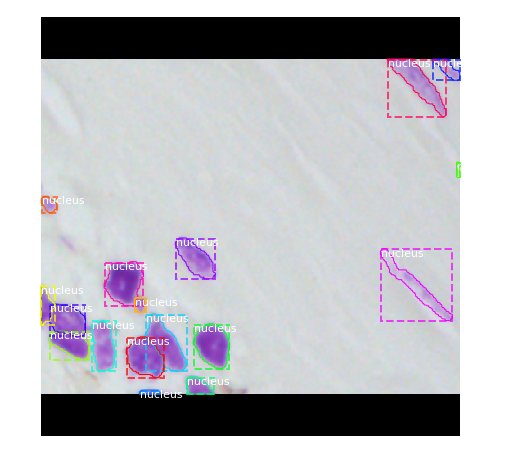

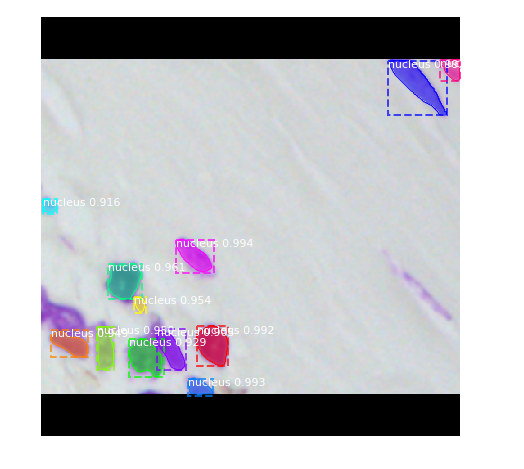

0.5 mAP: 0.7058823704719543, avg mAP:0.3332130218545596, instance_AP: [0.7058823704719543, 0.5775401294231415, 0.5775401294231415, 0.5775401294231415, 0.45147059112787247, 0.3303921620051066, 0.11176470667123795, 0.0, 0.0, 0.0], shape:[256 320], lowest_score:0.9045267105102539, id:1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e


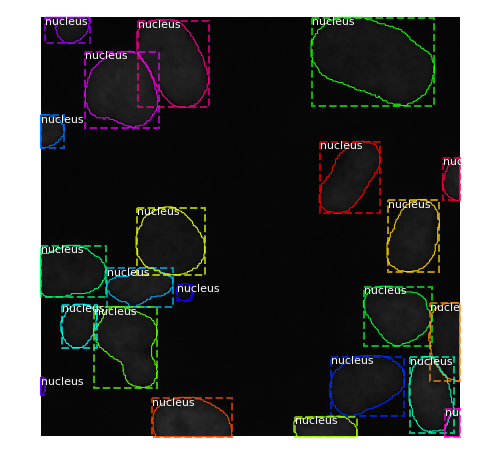

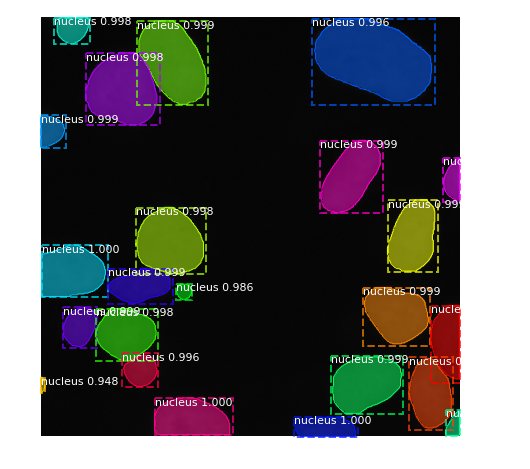

0.5 mAP: 0.9940711467162423, avg mAP:0.7979750986279426, instance_AP: [0.9940711467162423, 0.9940711467162423, 0.9940711467162423, 0.9940711467162423, 0.9355106987996832, 0.8862538650128001, 0.8862538650128001, 0.7794306678603394, 0.48571427152270363, 0.03030303120613098], shape:[360 360], lowest_score:0.9476449489593506, id:516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf


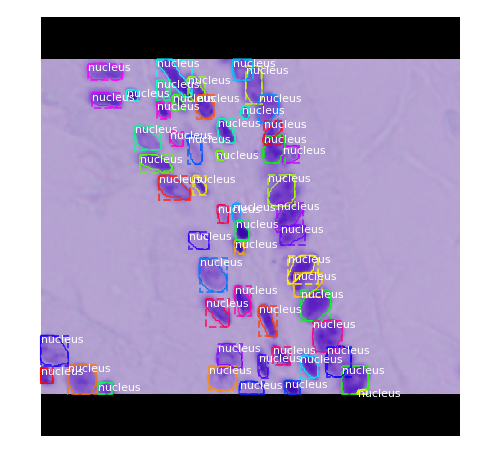

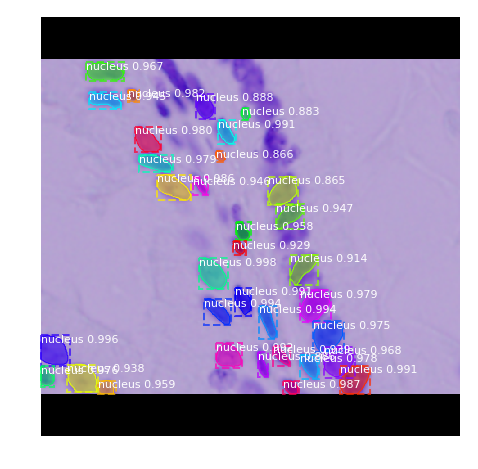

0.5 mAP: 0.6111111044883728, avg mAP:0.3751482905314044, instance_AP: [0.6111111044883728, 0.6111111044883728, 0.6111111044883728, 0.5681727822225464, 0.5032267023216593, 0.429516872208042, 0.28547162120212943, 0.11456584657066307, 0.017195767323885645, 0.0], shape:[256 320], lowest_score:0.8651249408721924, id:5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456


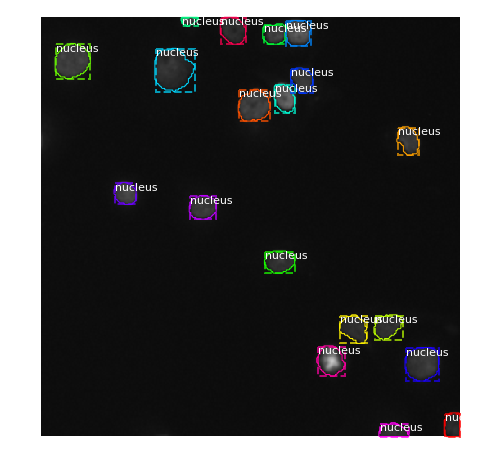

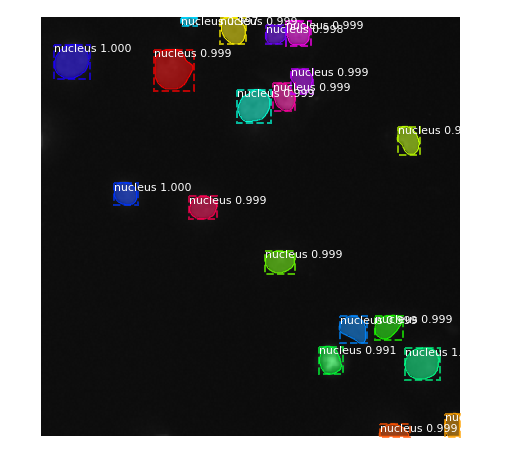

0.5 mAP: 1.0, avg mAP:0.8308553546162232, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9390581940349779, 0.8888888756434122, 0.48060647648384125, 0.0], shape:[256 256], lowest_score:0.9908087253570557, id:84e642d75ae6ece8147272418b6fe13d04db8d076fe306c4acedc329fceab564


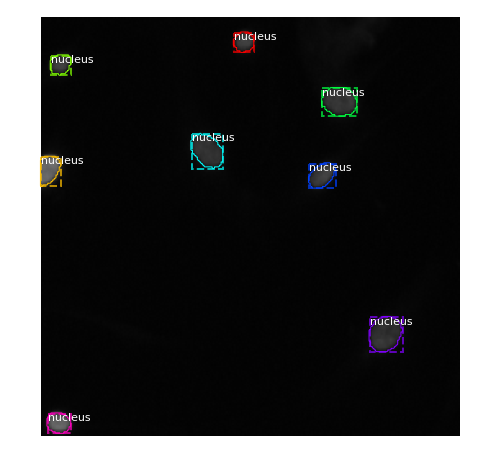

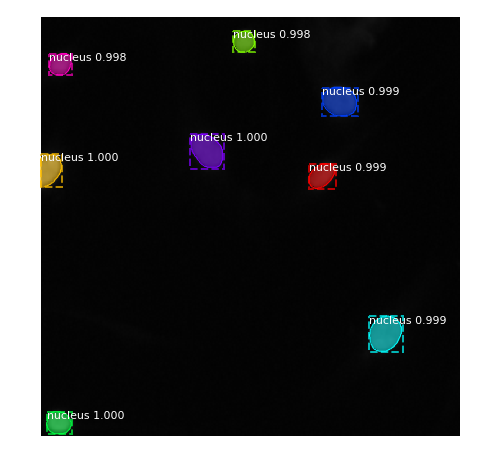

0.5 mAP: 1.0, avg mAP:0.7857142857142858, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.4821428571428572, 0.37499999999999994, 0.0], shape:[256 256], lowest_score:0.9976383447647095, id:52a4ac5a875be7a6c886035d54fb63f5f397dc43508c4831898f6b2f8debc7f3


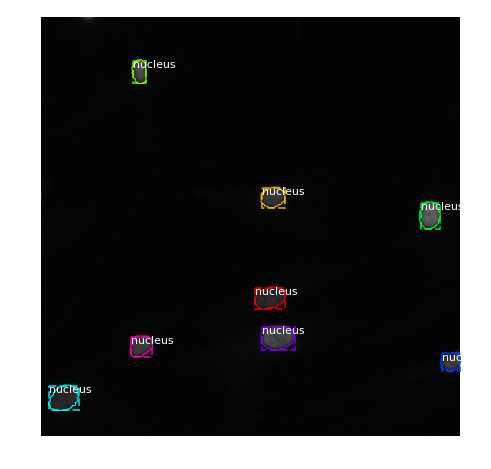

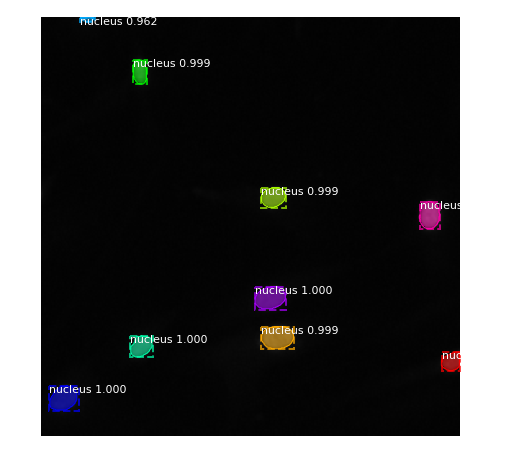

0.5 mAP: 1.0, avg mAP:0.8696428571428572, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.6964285714285714, 0.0], shape:[256 256], lowest_score:0.9615545868873596, id:3b75fc03a1d12b29bd2870eb1f6fdb44174dbd1118dfc11c31f127bd87bd27ef


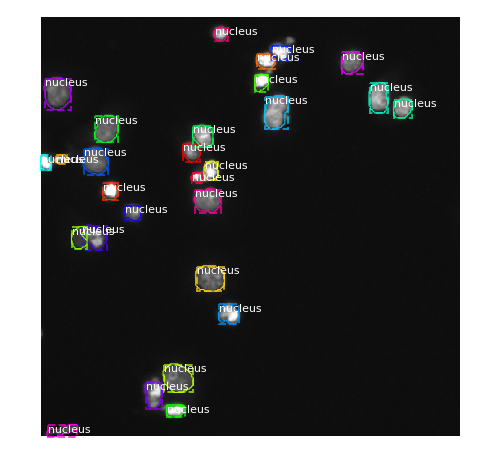

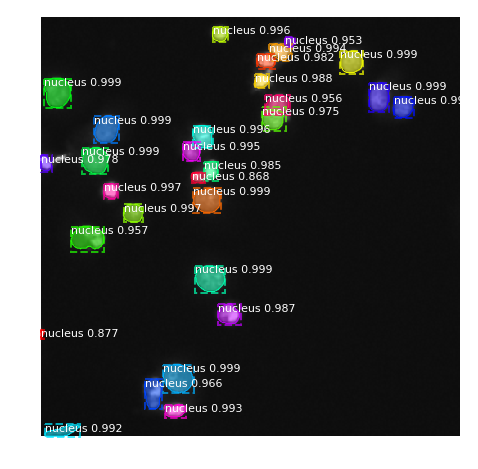

0.5 mAP: 0.9207559440591291, avg mAP:0.6070050277102716, instance_AP: [0.9207559440591291, 0.8494971361139725, 0.8494971361139725, 0.8494971361139725, 0.8494971361139725, 0.7159090907397595, 0.5496257158052741, 0.3302154223478976, 0.155555559694767, 0.0], shape:[256 256], lowest_score:0.8679704666137695, id:4d40de30a3db3bc4f241cb7f48e8497c11e8f20a99bf55788bdce17242029745


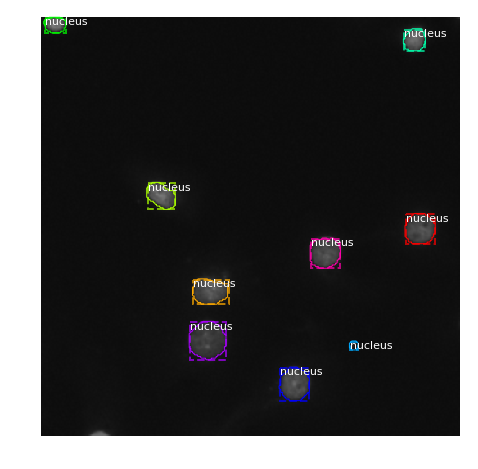

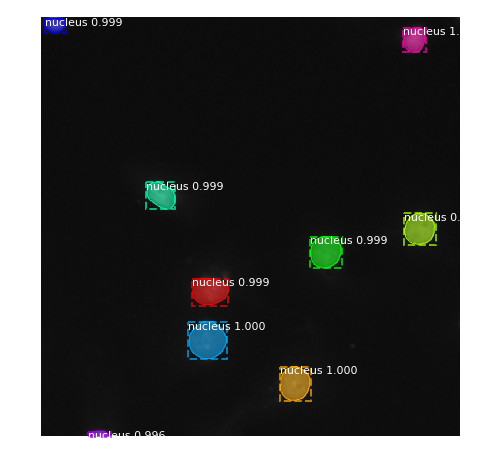

0.5 mAP: 0.8888888955116272, avg mAP:0.7484920713172427, instance_AP: [0.8888888955116272, 0.8888888955116272, 0.8888888955116272, 0.8888888955116272, 0.8888888955116272, 0.8888888955116272, 0.8888888955116272, 0.6944444561377168, 0.45714287651436675, 0.1111111119389534], shape:[256 256], lowest_score:0.9959297776222229, id:0acd2c223d300ea55d0546797713851e818e5c697d073b7f4091b96ce0f3d2fe


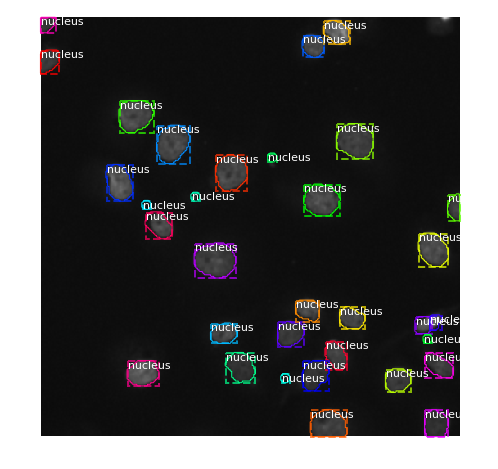

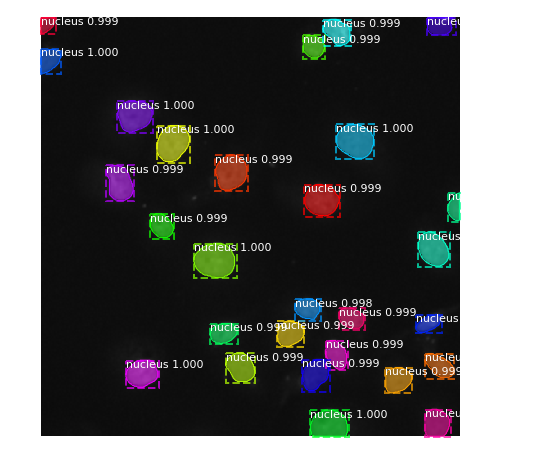

0.5 mAP: 0.7845118067882678, avg mAP:0.6451980170235505, instance_AP: [0.7845118067882678, 0.7845118067882678, 0.7845118067882678, 0.7845118067882678, 0.7845118067882678, 0.7389840377605672, 0.7389840377605672, 0.6816154799134436, 0.36983758085958834, 0.0], shape:[256 256], lowest_score:0.9690197110176086, id:75120baa6abcbfe750a4eb223b8c10ae6bc3bebdda7b00d9a78bc2472fa28625


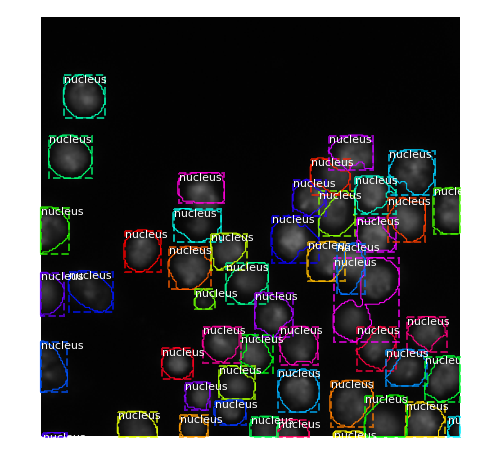

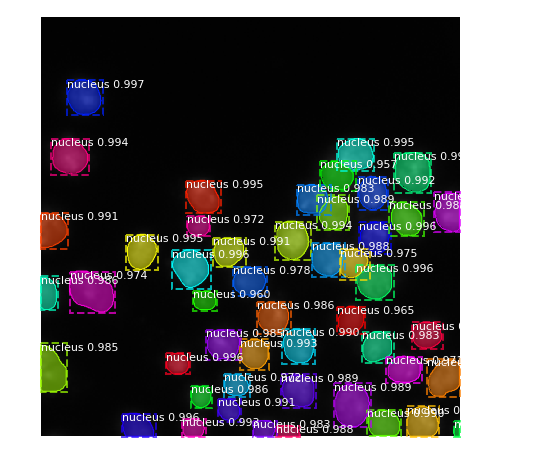

0.5 mAP: 0.7320634039336341, avg mAP:0.24592797829314944, instance_AP: [0.7320634039336341, 0.6063357861338962, 0.5291925217189521, 0.400973484579111, 0.16169932183082092, 0.024535424110093497, 0.0019910402777718337, 0.0019910402777718337, 0.0004977600694429584, 0.0], shape:[256 256], lowest_score:0.9574612379074097, id:edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8


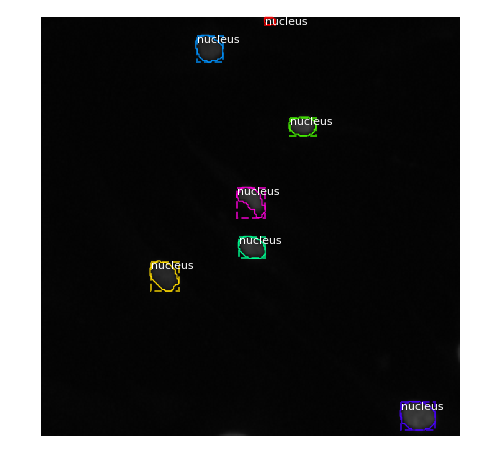

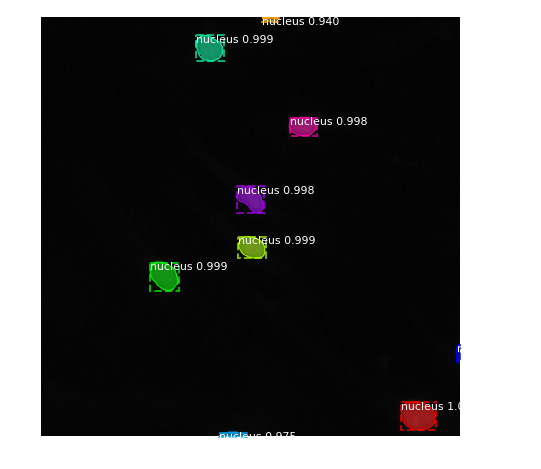

0.5 mAP: 0.8571428656578064, avg mAP:0.7523809626698494, instance_AP: [0.8571428656578064, 0.8571428656578064, 0.8571428656578064, 0.8571428656578064, 0.8571428656578064, 0.8571428656578064, 0.8571428656578064, 0.6904762089252472, 0.6904762089252472, 0.1428571492433548], shape:[256 256], lowest_score:0.9400625824928284, id:072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81


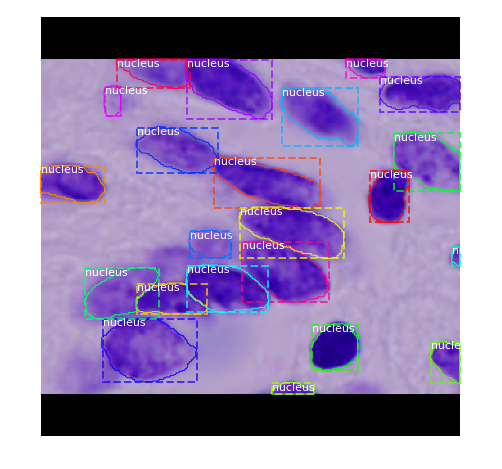

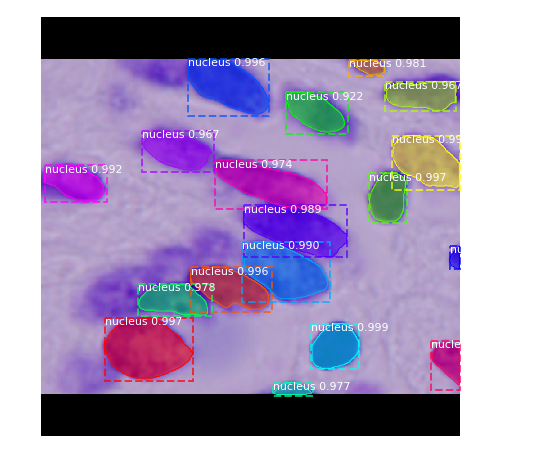

0.5 mAP: 0.8181818127632141, avg mAP:0.5179590041935445, instance_AP: [0.8181818127632141, 0.8181818127632141, 0.7727272510528564, 0.7139037637149587, 0.6550802202785716, 0.49545455873012545, 0.49545455873012545, 0.35606060773134235, 0.05454545617103577, 0.0], shape:[256 320], lowest_score:0.9222175478935242, id:709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7


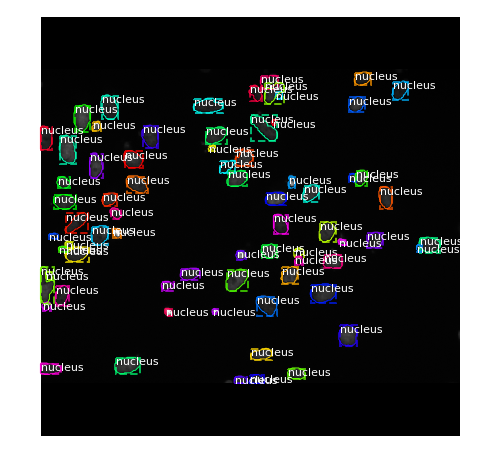

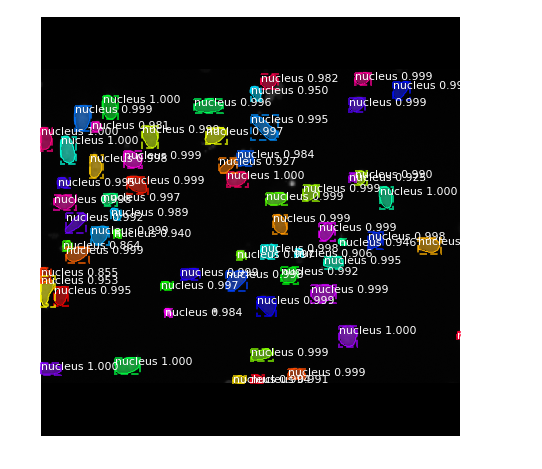

0.5 mAP: 0.8300469368696213, avg mAP:0.6613861824455258, instance_AP: [0.8300469368696213, 0.8300469368696213, 0.8161852248644424, 0.8006163582228732, 0.8006163582228732, 0.7869928180610872, 0.7282456180373371, 0.6508349032660008, 0.36020411367758814, 0.010072556363813804], shape:[520 696], lowest_score:0.8545771837234497, id:a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb


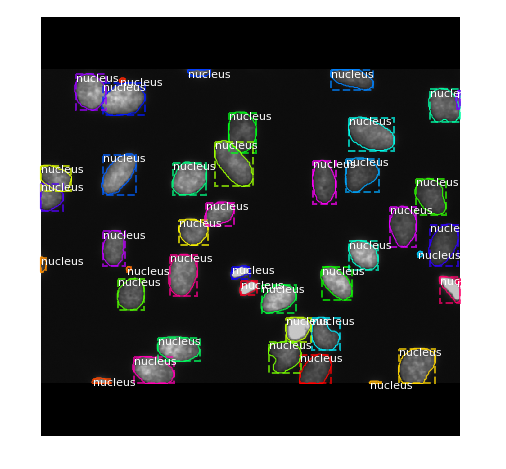

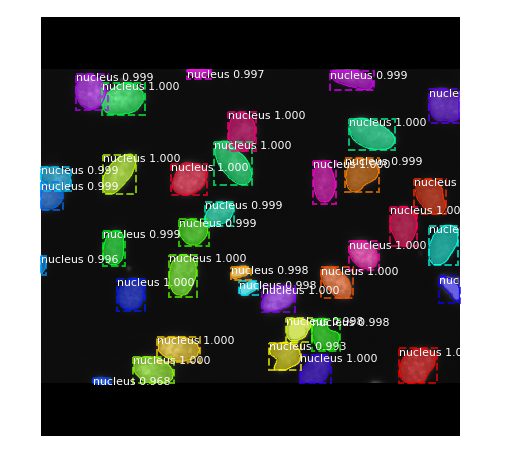

0.5 mAP: 0.8604651093482971, avg mAP:0.7621313529275626, instance_AP: [0.8604651093482971, 0.8604651093482971, 0.8604651093482971, 0.8604651093482971, 0.8604651093482971, 0.8372092843055725, 0.8372092843055725, 0.8126614706383811, 0.7173361402569395, 0.11457180302767526], shape:[520 696], lowest_score:0.9682084918022156, id:4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464


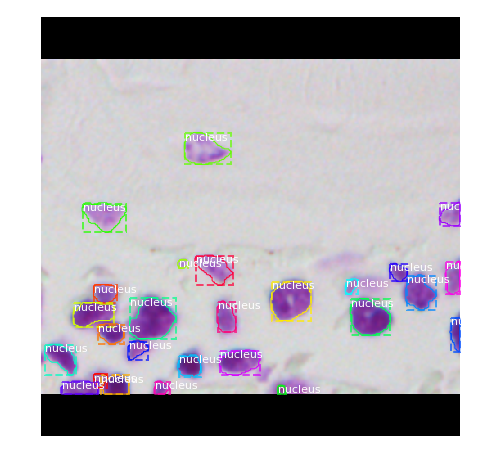

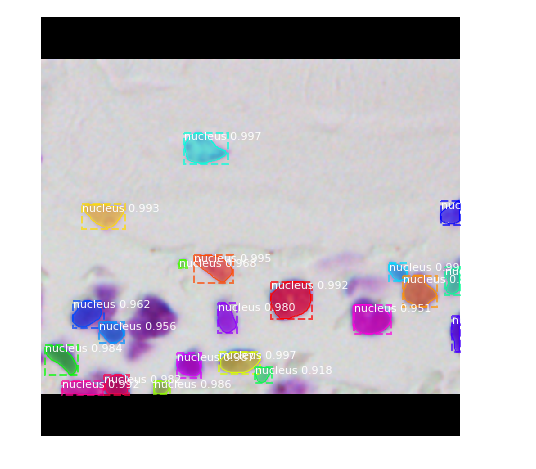

0.5 mAP: 0.7692307829856873, avg mAP:0.5230482510264898, instance_AP: [0.7692307829856873, 0.7692307829856873, 0.7692307829856873, 0.7692307829856873, 0.7249999880790711, 0.7249999880790711, 0.5503542712938629, 0.1467948742210865, 0.00641025664905707, 0.0], shape:[256 320], lowest_score:0.9182156324386597, id:1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72


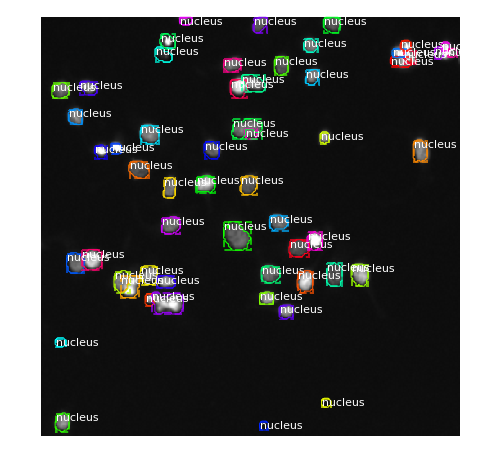

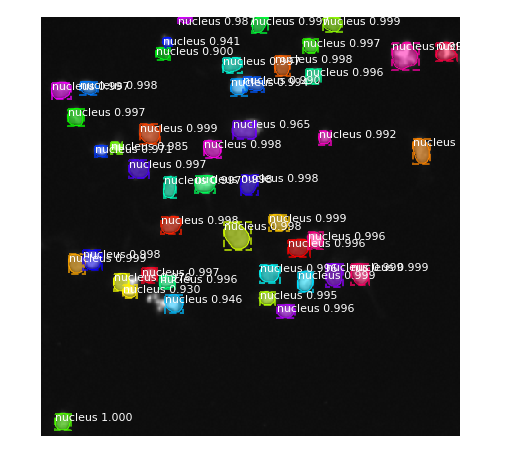

0.5 mAP: 0.7249581082842941, avg mAP:0.4365731615445667, instance_AP: [0.7249581082842941, 0.7074801550570823, 0.6919522121508269, 0.6544957273213197, 0.617519923793503, 0.5711755146997601, 0.2985361710696106, 0.09167729477797235, 0.007936508291297488, 0.0], shape:[256 256], lowest_score:0.8999898433685303, id:3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff


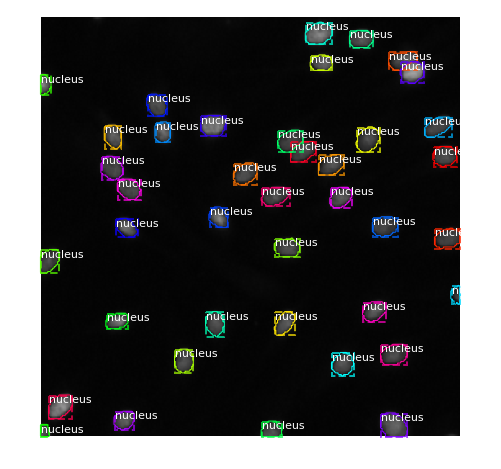

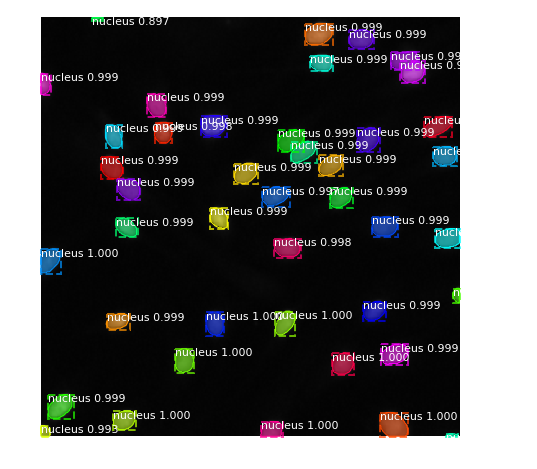

0.5 mAP: 1.0, avg mAP:0.8188142989817863, instance_AP: [1.0, 1.0, 1.0, 1.0, 0.9737500235438347, 0.9737500235438347, 0.9737500235438347, 0.9737500235438347, 0.29314289564252416, 0.0], shape:[256 256], lowest_score:0.8965224623680115, id:ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72


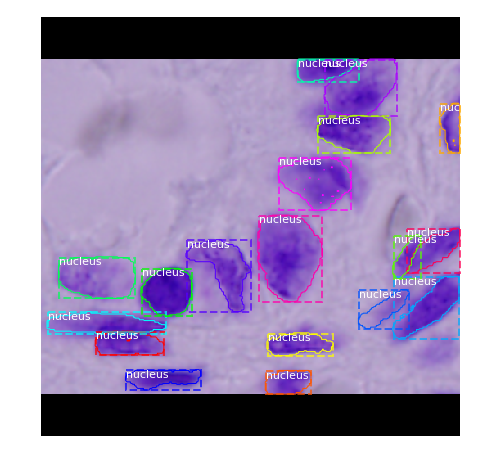

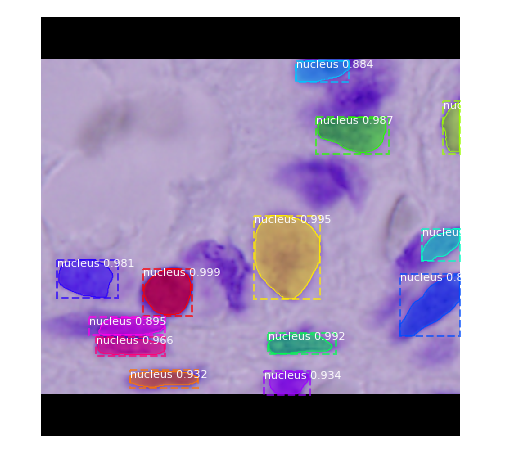

0.5 mAP: 0.6538461721860446, avg mAP:0.39641501332004353, instance_AP: [0.6538461721860446, 0.6538461721860446, 0.5669515629609425, 0.5185185422499975, 0.4475308673249351, 0.4475308673249351, 0.34259260197480523, 0.2777777910232544, 0.0555555559694767, 0.0], shape:[256 320], lowest_score:0.8807147145271301, id:be771d6831e3f8f1af4696bc08a582f163735db5baf9906e4729acc6a05e1187


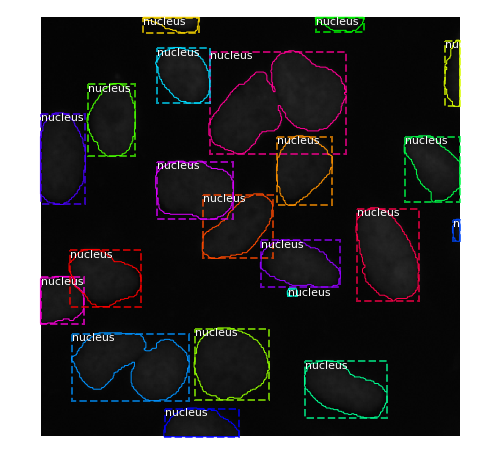

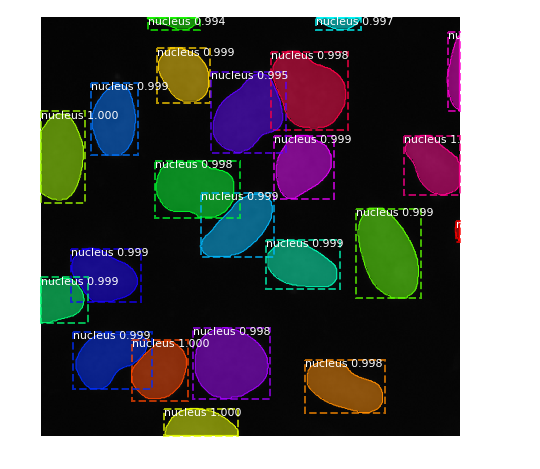

0.5 mAP: 0.6929705318950472, avg mAP:0.5589209118207881, instance_AP: [0.6929705318950472, 0.6929705318950472, 0.6929705318950472, 0.6929705318950472, 0.6929705318950472, 0.6521542077972775, 0.6097372435388111, 0.526210503918784, 0.33345338297741756, 0.002801120500354206], shape:[360 360], lowest_score:0.95384281873703, id:7d40ea6ead1bec903f26d9046d291aedcb12a584b4d3b337ea252b34c7d86072


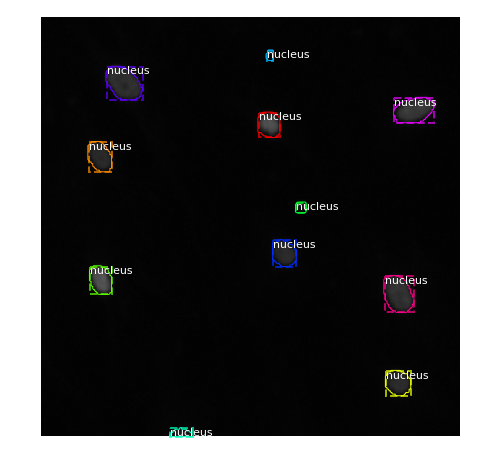

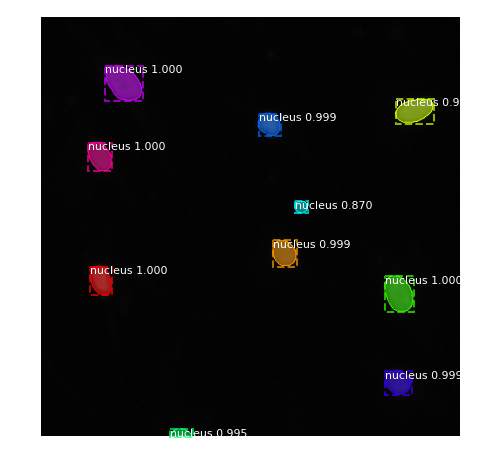

0.5 mAP: 0.9090909361839294, avg mAP:0.7099567281348365, instance_AP: [0.9090909361839294, 0.9090909361839294, 0.9090909361839294, 0.9090909361839294, 0.9090909361839294, 0.9090909361839294, 0.8181818127632141, 0.6969697177410126, 0.12987013374056133, 0.0], shape:[256 256], lowest_score:0.8701512813568115, id:abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62


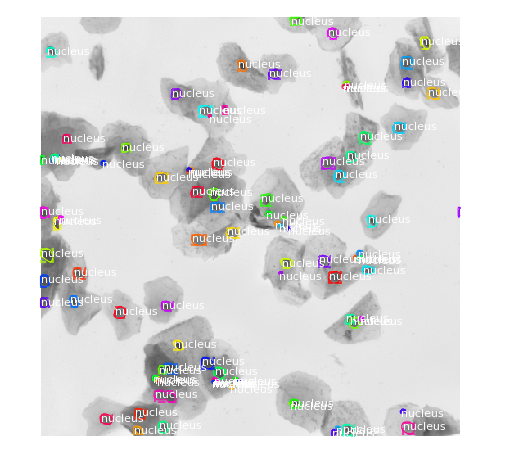

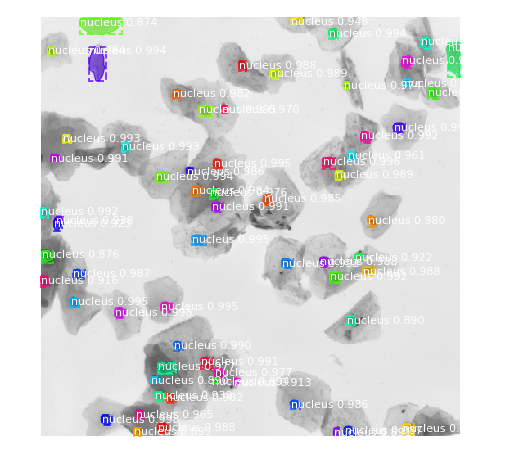

0.5 mAP: 0.48666965574213467, avg mAP:0.2887002491900275, instance_AP: [0.48666965574213467, 0.47827439899713653, 0.46731930723746384, 0.43727430172482806, 0.4069461493177882, 0.33232239393556556, 0.22308921752652333, 0.05302373402341337, 0.002083333395421505, 0.0], shape:[1024 1024], lowest_score:0.873821496963501, id:1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df


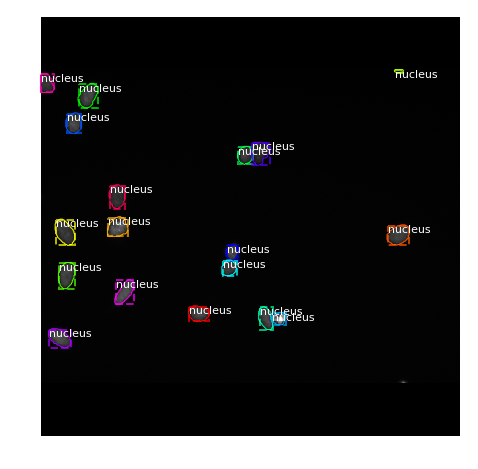

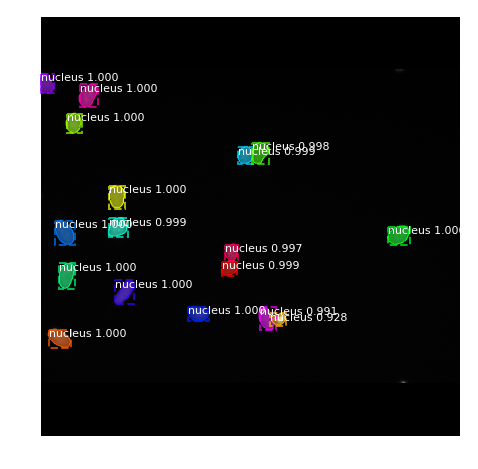

0.5 mAP: 0.9444444179534912, avg mAP:0.7988209972186731, instance_AP: [0.9444444179534912, 0.9444444179534912, 0.9444444179534912, 0.9444444179534912, 0.9444444179534912, 0.9444444179534912, 0.9444444179534912, 0.8202614188194275, 0.5371795078882804, 0.019658119804584064], shape:[520 696], lowest_score:0.928017795085907, id:2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2


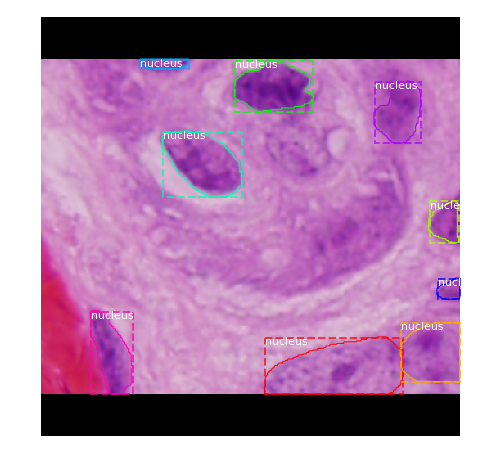

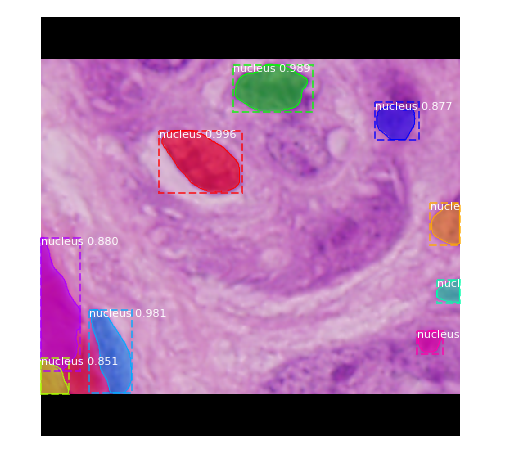

0.5 mAP: 0.6388889104127884, avg mAP:0.39722223915159705, instance_AP: [0.6388889104127884, 0.5555555820465088, 0.5555555820465088, 0.5555555820465088, 0.5555555820465088, 0.5555555820465088, 0.27777778543531895, 0.27777778543531895, 0.0, 0.0], shape:[256 320], lowest_score:0.8510679006576538, id:57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab


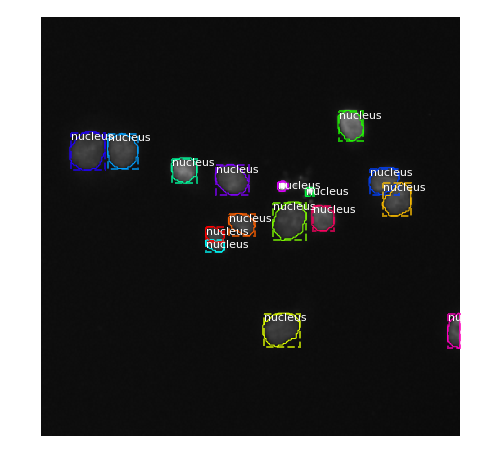

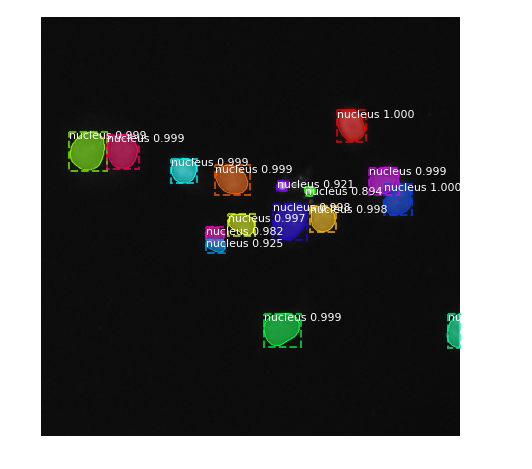

0.5 mAP: 1.0, avg mAP:0.8019097222222221, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 0.9375, 0.875, 0.6354166666666665, 0.5555555555555556, 0.015625], shape:[256 256], lowest_score:0.8939564228057861, id:0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21


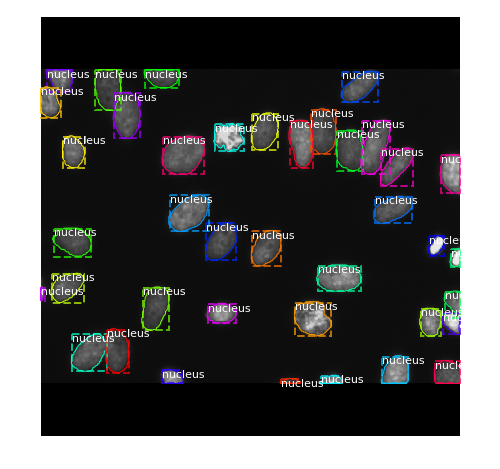

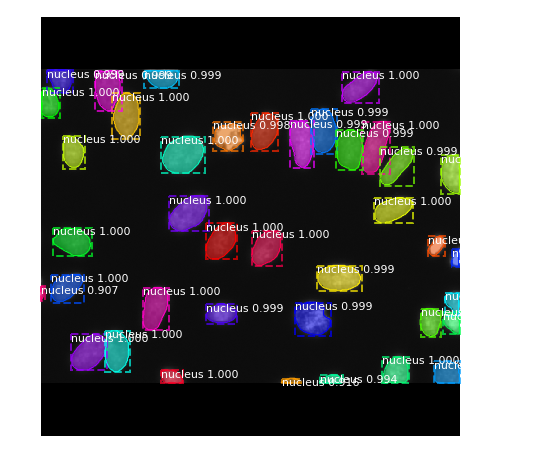

0.5 mAP: 1.0, avg mAP:0.8834185196695463, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.971729127260355, 0.8717948794364929, 0.771095582933137, 0.21956560706547865], shape:[520 696], lowest_score:0.9066207408905029, id:8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a


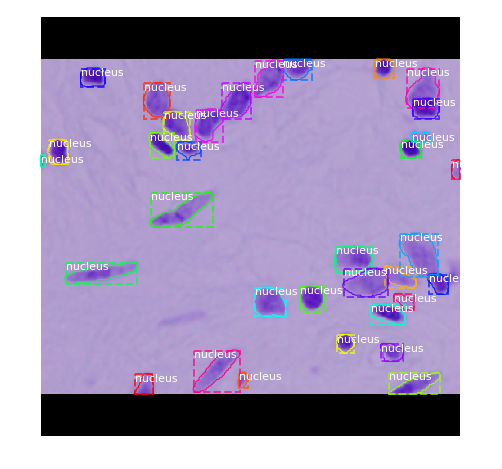

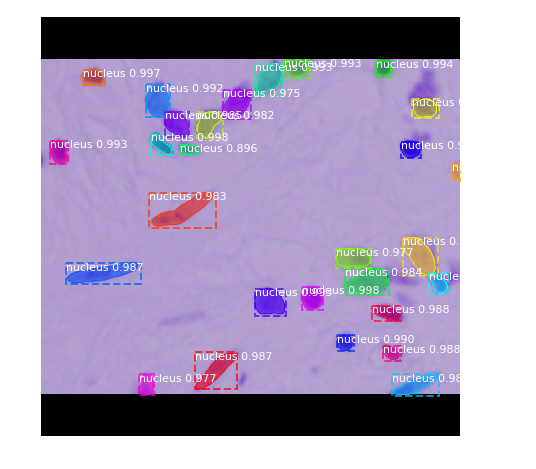

0.5 mAP: 0.7941176295280457, avg mAP:0.370954725203953, instance_AP: [0.7941176295280457, 0.7505446760742751, 0.7091503143310548, 0.5762527143513715, 0.4790933657533084, 0.3033936664462089, 0.0822890028681444, 0.014705882687121629, 0.0, 0.0], shape:[256 320], lowest_score:0.8957500457763672, id:136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261


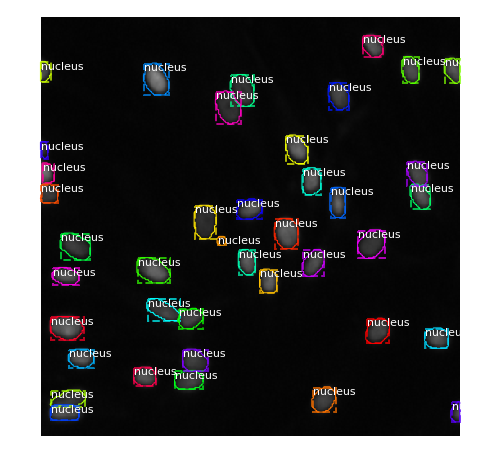

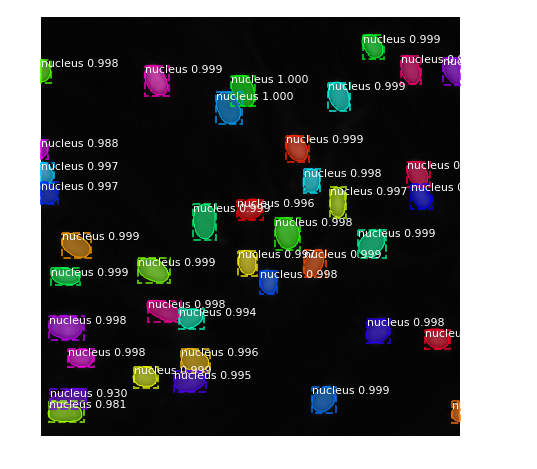

0.5 mAP: 0.9750000238418579, avg mAP:0.7181392138477773, instance_AP: [0.9750000238418579, 0.9750000238418579, 0.9750000238418579, 0.9750000238418579, 0.9750000238418579, 0.8701388885577519, 0.8331349431758837, 0.47591230969608217, 0.12720587783876586, 0.0], shape:[256 256], lowest_score:0.930244505405426, id:5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053


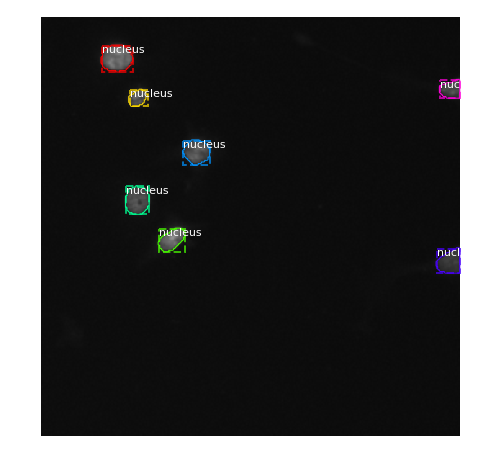

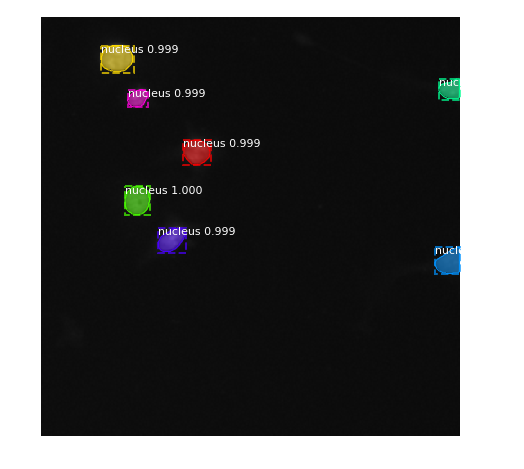

0.5 mAP: 1.0, avg mAP:0.8346938801663264, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.8367347036089215, 0.5102040980543409, 0.0], shape:[256 256], lowest_score:0.9990135431289673, id:08ae2741df2f5ac815c0f272a8c532b5167ee853be9b939b9b8b7fa93560868a


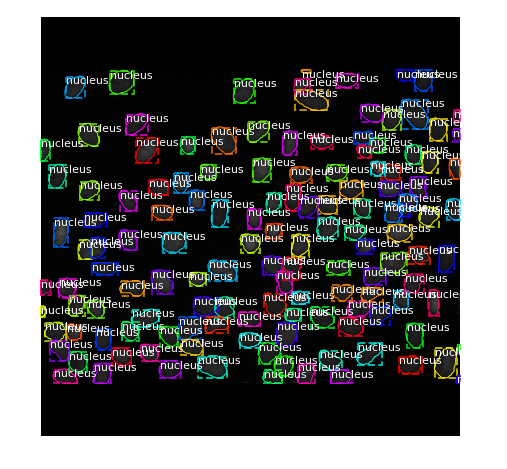

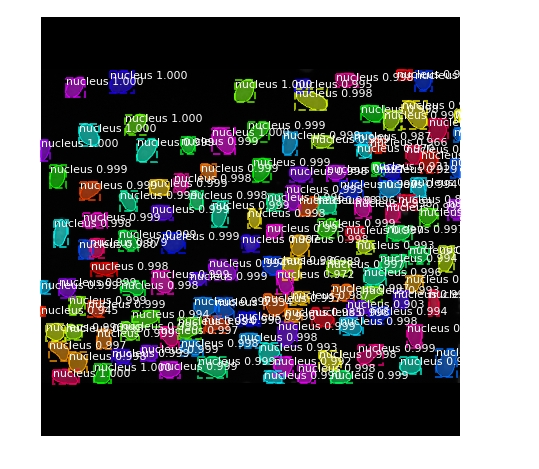

0.5 mAP: 0.970370352268219, avg mAP:0.752190242455059, instance_AP: [0.970370352268219, 0.970370352268219, 0.970370352268219, 0.970370352268219, 0.970370352268219, 0.9509502216601007, 0.8792442732925526, 0.6683537217948554, 0.16937722597895205, 0.0021252204830359135], shape:[520 696], lowest_score:0.8870800733566284, id:cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e


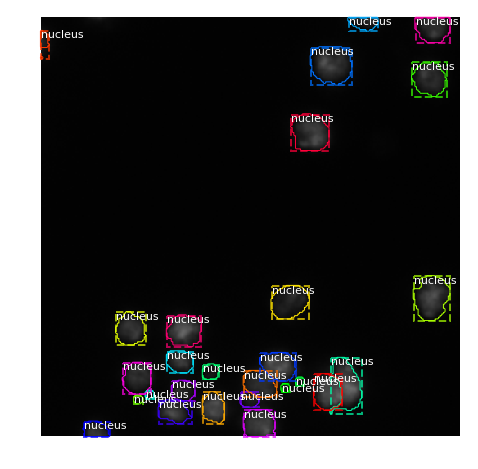

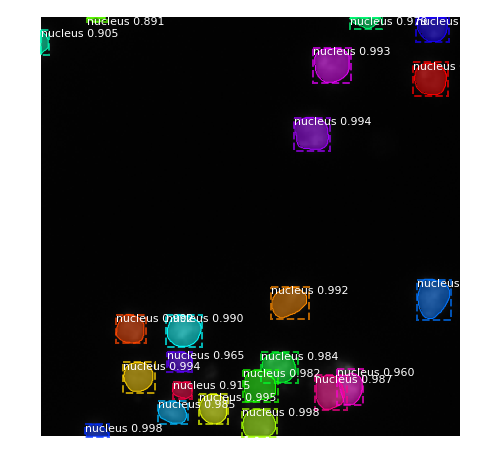

0.5 mAP: 0.7777777910232544, avg mAP:0.461971631518432, instance_AP: [0.7777777910232544, 0.7372133816991533, 0.7372133816991533, 0.7372133816991533, 0.6666666865348816, 0.5537551492452621, 0.32345679203669225, 0.06790123259027799, 0.018518518656492233, 0.0], shape:[256 256], lowest_score:0.8910872340202332, id:00071198d059ba7f5914a526d124d28e6d010c92466da21d4a04cd5413362552


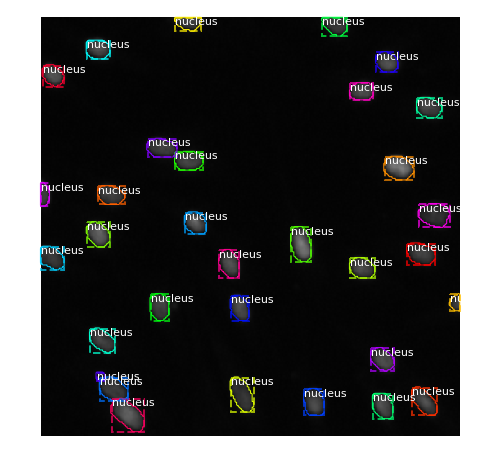

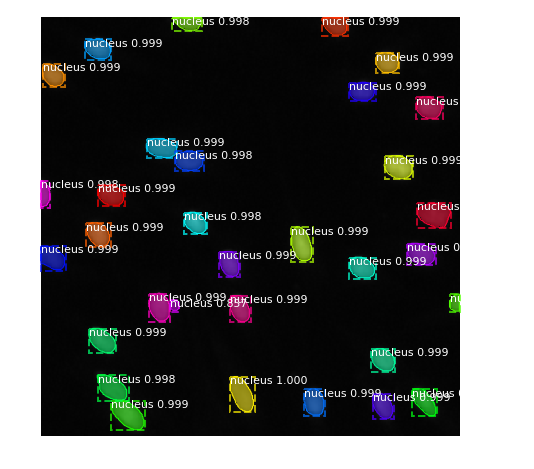

0.5 mAP: 0.96875, avg mAP:0.7762575431034483, instance_AP: [0.96875, 0.96875, 0.96875, 0.96875, 0.96875, 0.96875, 0.96875, 0.8210344827586206, 0.1602909482758621, 0.0], shape:[256 256], lowest_score:0.8571316003799438, id:f93ec5e683d81005ffc2a84a1c0299b2406ad14b764b824e013f7ca3a13833b5


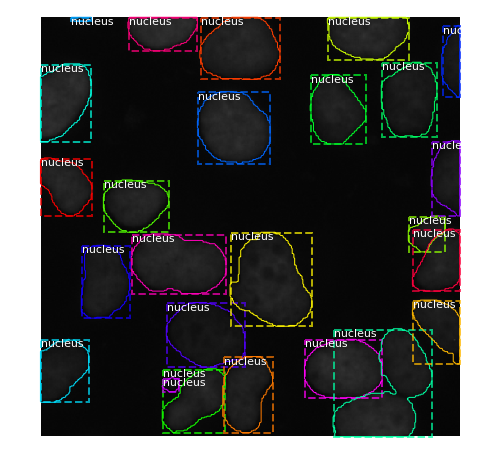

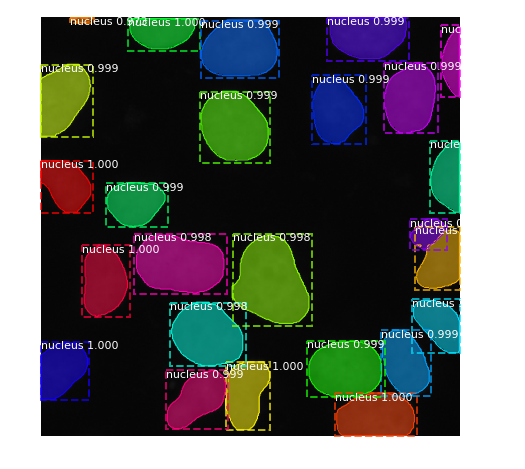

0.5 mAP: 0.8464000153541564, avg mAP:0.6501914760102179, instance_AP: [0.8464000153541564, 0.8464000153541564, 0.8464000153541564, 0.8464000153541564, 0.8066666622956592, 0.8066666622956592, 0.635279495060814, 0.5813664816181111, 0.2830020641564829, 0.003333333258827527], shape:[360 360], lowest_score:0.9728062152862549, id:66236902b874b7e4b3891db63a69f6d56f6edcec6aca7ba3c6871d73e7b4c34f


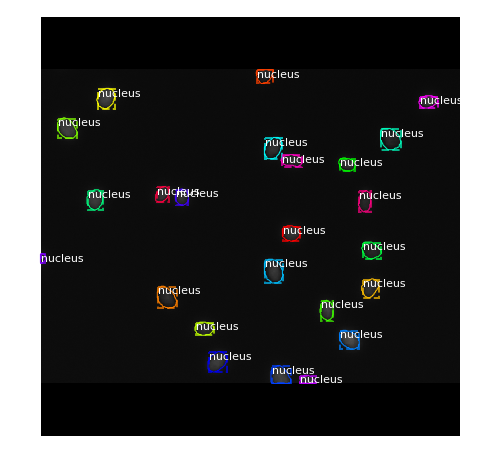

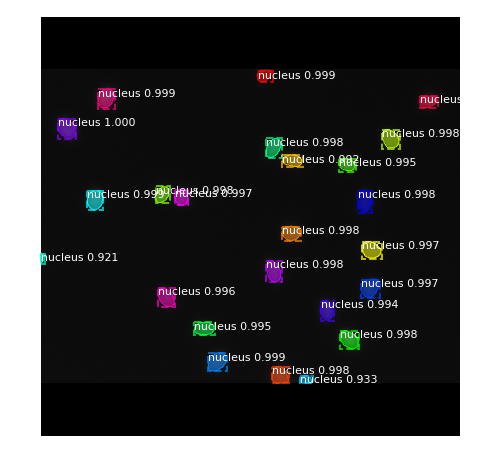

0.5 mAP: 1.0, avg mAP:0.7046030199031035, instance_AP: [1.0, 1.0, 1.0, 1.0, 0.9357638694345951, 0.7083333171904087, 0.6085227273404599, 0.47958754127224285, 0.31183861675007, 0.001984127043258576], shape:[520 696], lowest_score:0.9212962985038757, id:2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25


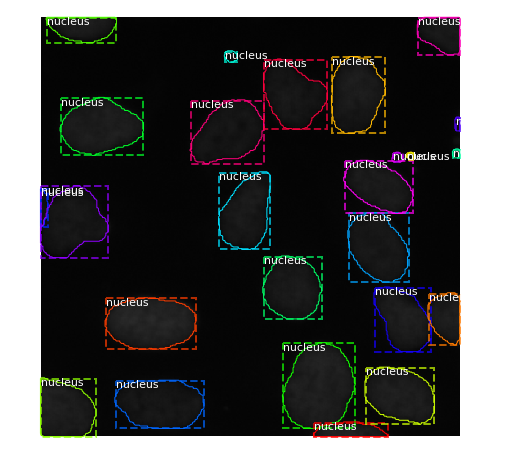

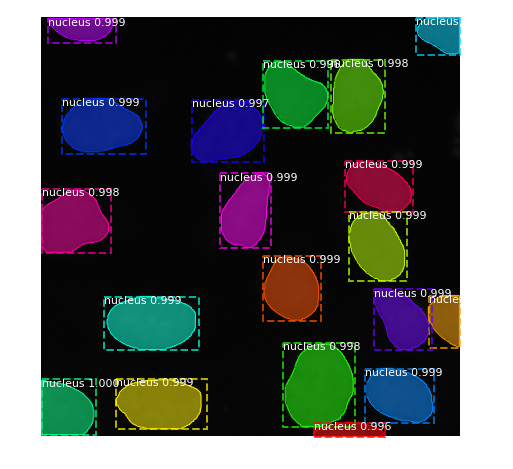

0.5 mAP: 0.7599999904632568, avg mAP:0.6671927229729119, instance_AP: [0.7599999904632568, 0.7599999904632568, 0.7599999904632568, 0.7599999904632568, 0.7599999904632568, 0.7599999904632568, 0.7599999904632568, 0.7599999904632568, 0.5735939730995132, 0.0183333329235514], shape:[360 360], lowest_score:0.9961491823196411, id:6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f


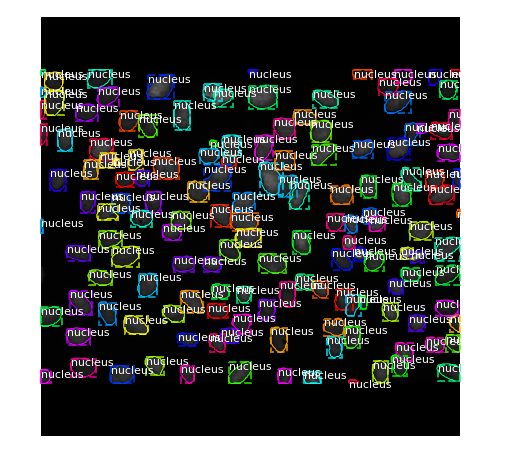

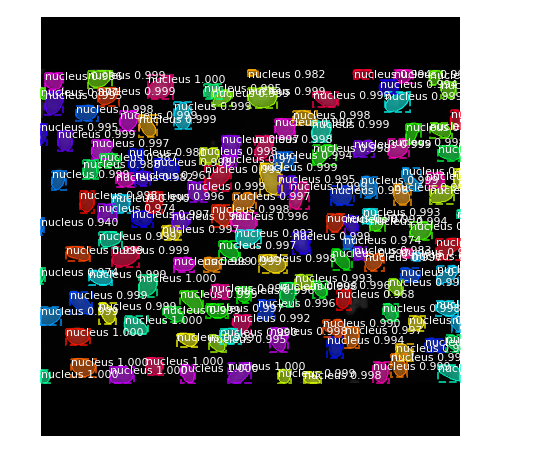

0.5 mAP: 0.9378598341043445, avg mAP:0.7253128790647345, instance_AP: [0.9378598341043445, 0.9378598341043445, 0.9378598341043445, 0.9378598341043445, 0.9234895944643153, 0.8960666317911495, 0.8240465825573111, 0.6266057080732388, 0.23136484725891054, 0.00011609008504172503], shape:[520 696], lowest_score:0.8765465021133423, id:1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8


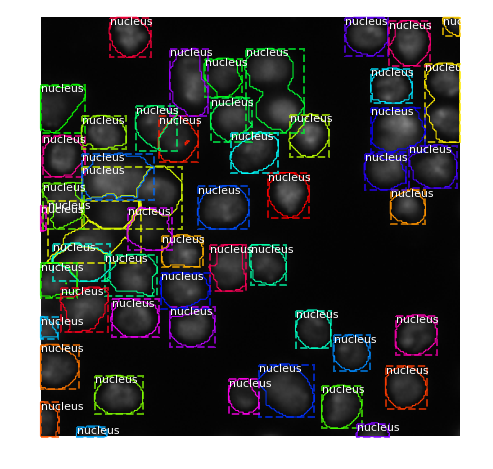

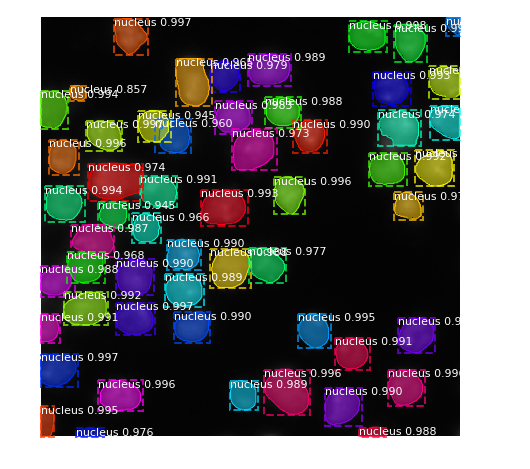

0.5 mAP: 0.8257365194689683, avg mAP:0.2558657244116701, instance_AP: [0.8257365194689683, 0.7329467700653014, 0.5731277766207918, 0.3340977131206867, 0.08118831934581491, 0.01156014549513784, 0.0, 0.0, 0.0, 0.0], shape:[256 256], lowest_score:0.85721355676651, id:2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d


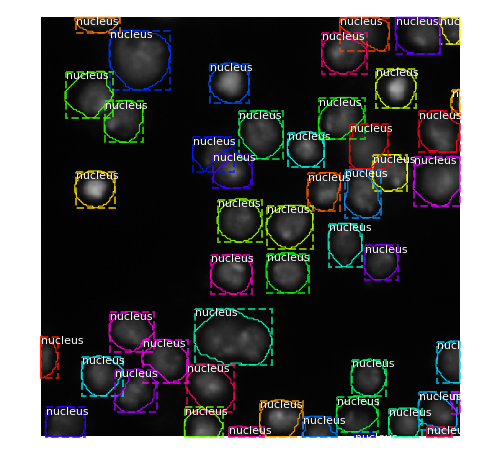

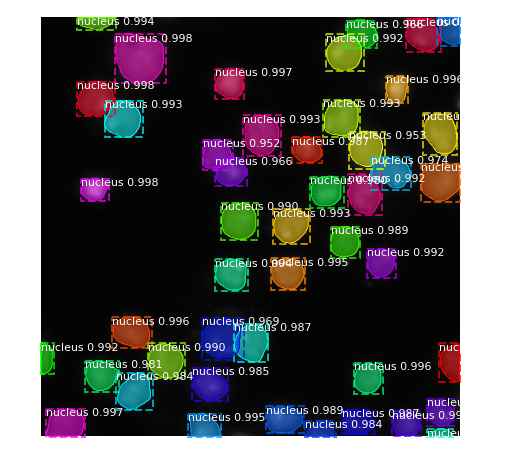

0.5 mAP: 0.6732063870356761, avg mAP:0.20728098718372906, instance_AP: [0.6732063870356761, 0.5938890142428342, 0.4689346530215759, 0.2577509703969156, 0.05550165894840444, 0.011811391001847249, 0.006613756478246715, 0.005102040711790323, 0.0, 0.0], shape:[256 256], lowest_score:0.9087470769882202, id:58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5


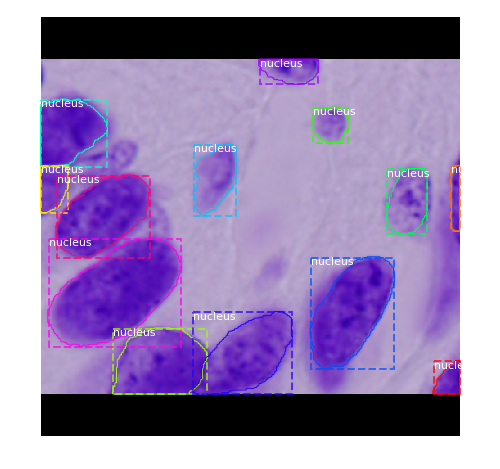

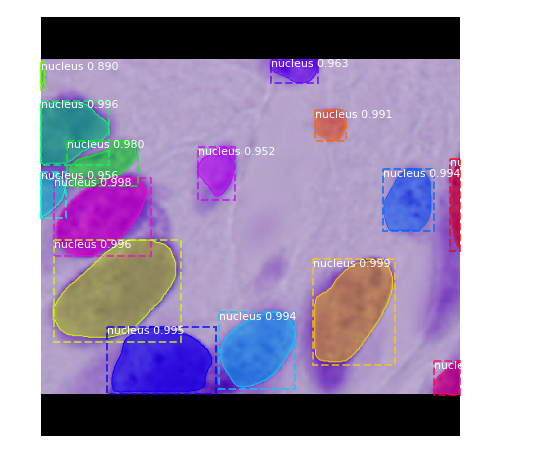

0.5 mAP: 0.9780219793319702, avg mAP:0.6409951236099005, instance_AP: [0.9780219793319702, 0.9780219793319702, 0.9780219793319702, 0.8992674052715302, 0.7472527623176575, 0.6562881767749786, 0.5384615659713745, 0.4615384638309479, 0.17307692393660545, 0.0], shape:[256 320], lowest_score:0.8897546529769897, id:c1afe66cd139f996fd984f5f2622903730ec2f1192d90608154f07f7ef6cdb4b


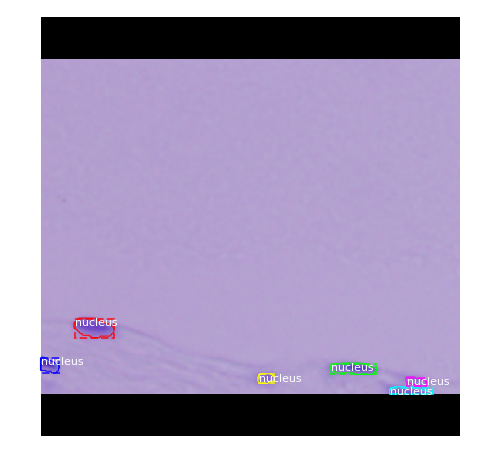

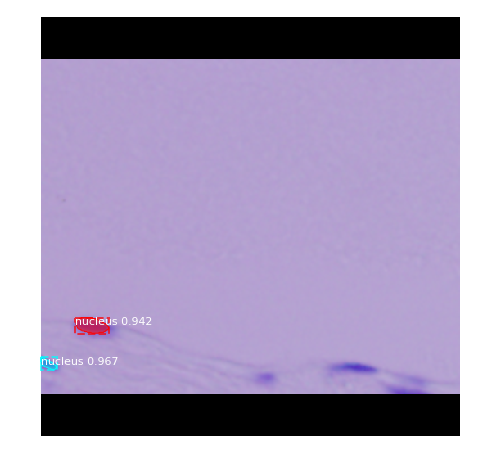

0.5 mAP: 0.3333333432674408, avg mAP:0.0833333358168602, instance_AP: [0.3333333432674408, 0.3333333432674408, 0.0833333358168602, 0.0833333358168602, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], shape:[256 320], lowest_score:0.9415537118911743, id:8e507d58f4c27cd2a82bee79fe27b069befd62a46fdaed20970a95a2ba819c7b


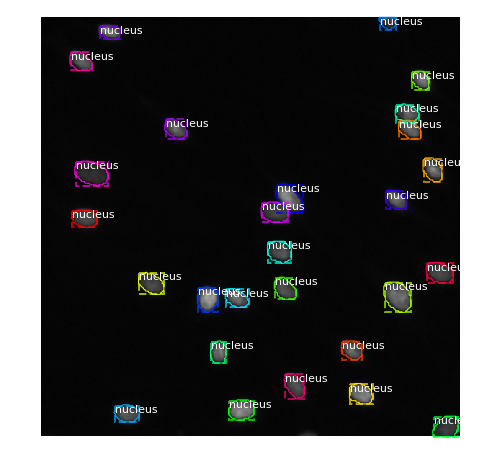

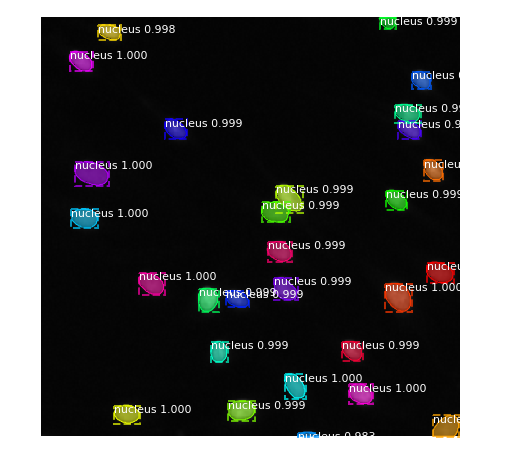

0.5 mAP: 1.0, avg mAP:0.8146633408155536, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.8829534739637986, 0.2636799341917367, 0.0], shape:[256 256], lowest_score:0.9829572439193726, id:1d4a5e729bb96b08370789cad0791f6e52ce0ffe1fcc97a04046420b43c851dd


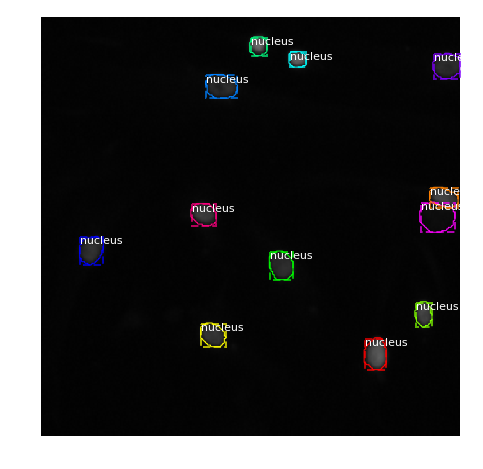

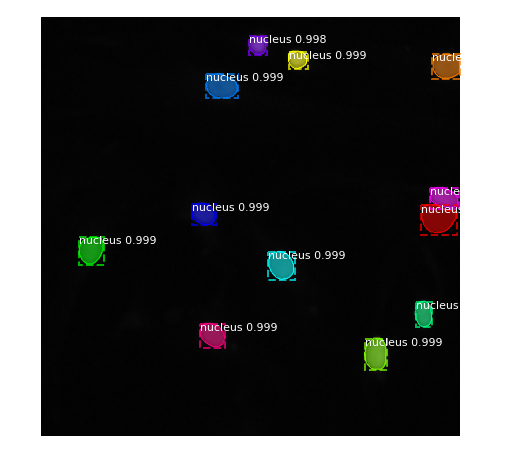

0.5 mAP: 1.0, avg mAP:0.8313888858093156, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.8194444278875986, 0.4944444302055571, 0.0], shape:[256 256], lowest_score:0.9695265889167786, id:f0a75e0322f11cead4219aa530673fe5eef67580fb6fccc254963c9fc6b58aa1


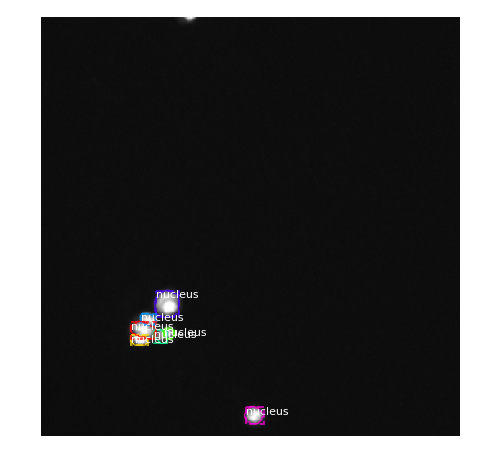

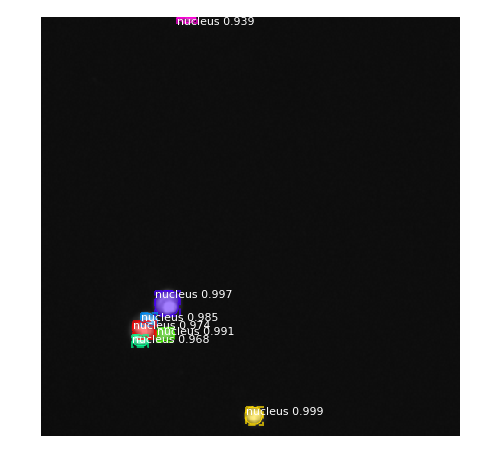

0.5 mAP: 0.6428571591774622, avg mAP:0.4871428693334261, instance_AP: [0.6428571591774622, 0.6428571591774622, 0.6428571591774622, 0.6428571591774622, 0.6428571591774622, 0.6428571591774622, 0.6428571591774622, 0.37142857909202576, 0.0, 0.0], shape:[256 256], lowest_score:0.9392834305763245, id:fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae


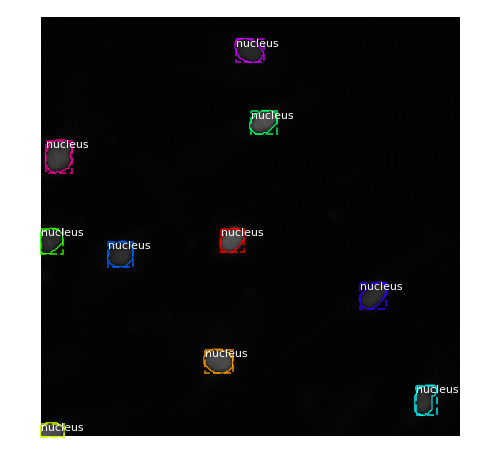

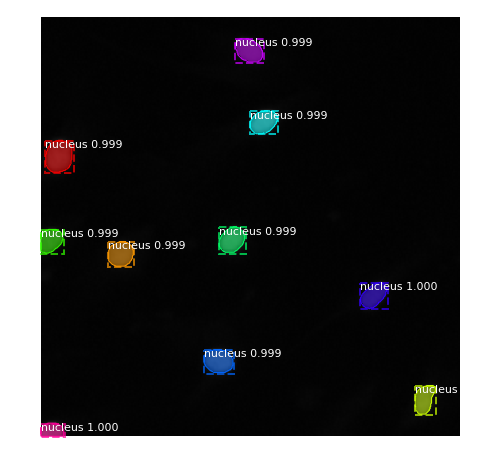

0.5 mAP: 1.0, avg mAP:0.864999993890524, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.8499999791383744, 0.8499999791383744, 0.8499999791383744, 0.10000000149011612], shape:[256 256], lowest_score:0.9979985356330872, id:b2c23ddb04531158da6a0abcaca78fec0ae5c6f64f60166e4f36f4a161efd76f


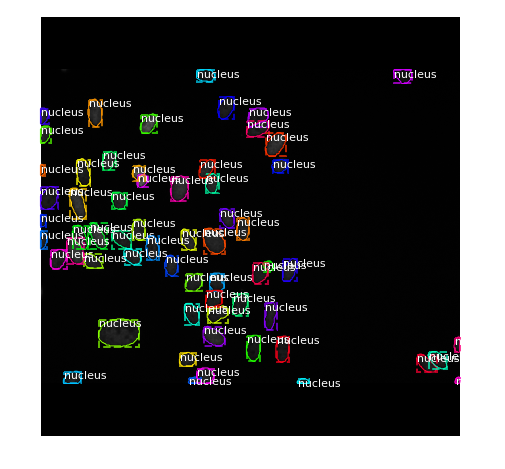

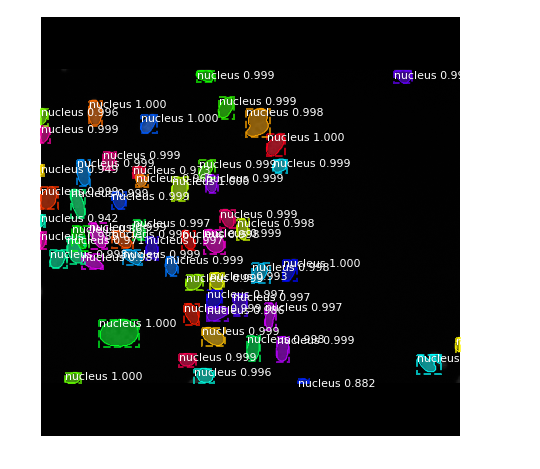

0.5 mAP: 0.9180327653884888, avg mAP:0.6917487336692356, instance_AP: [0.9180327653884888, 0.8951990615044321, 0.8951990615044321, 0.8747889722304487, 0.8747889722304487, 0.857742455571608, 0.7669635236351323, 0.6726187852493628, 0.16215373937800362, 0.0], shape:[520 696], lowest_score:0.8654404878616333, id:6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa


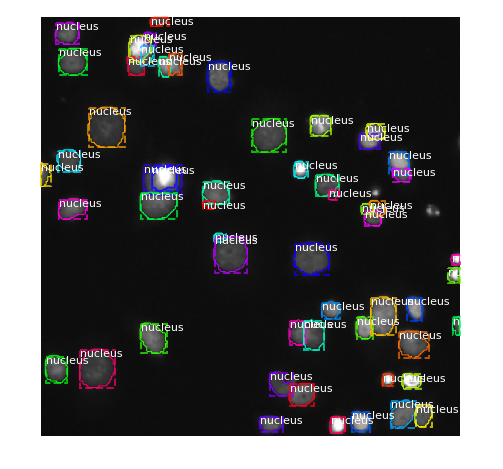

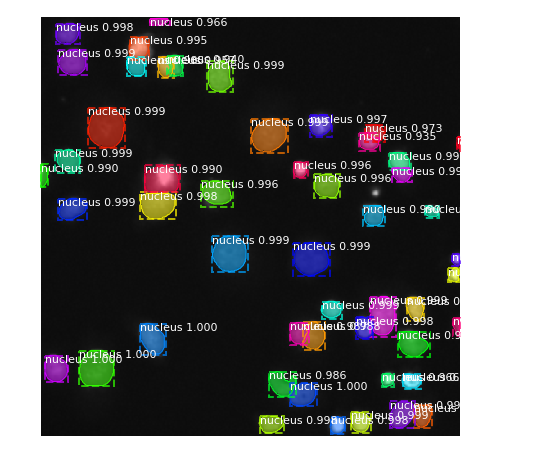

0.5 mAP: 0.8571428656578064, avg mAP:0.6006840039487182, instance_AP: [0.8571428656578064, 0.8571428656578064, 0.8348214452465375, 0.7896533387110514, 0.7714985852148017, 0.6993880696896311, 0.5895267332574319, 0.4105476963365906, 0.19574481328049373, 0.0013736264350322578], shape:[256 256], lowest_score:0.8631559014320374, id:c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f


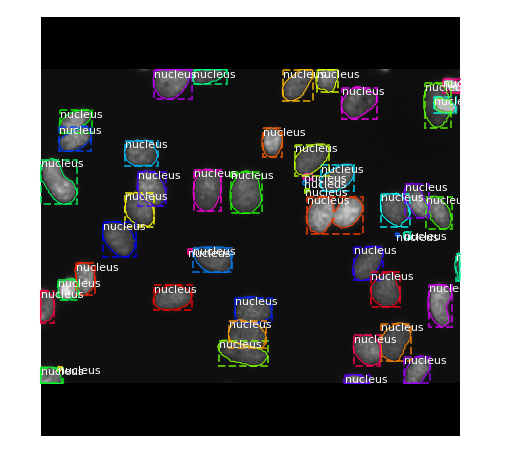

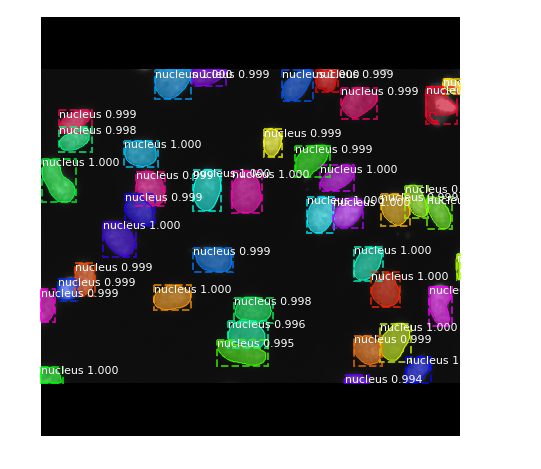

0.5 mAP: 0.7984374999999999, avg mAP:0.6624086916430196, instance_AP: [0.7984374999999999, 0.7562500189989805, 0.7562500189989805, 0.7562500189989805, 0.7562500189989805, 0.7562500189989805, 0.7562500189989805, 0.6987179489089893, 0.48786885585563183, 0.10156249767169356], shape:[520 696], lowest_score:0.9506128430366516, id:4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149


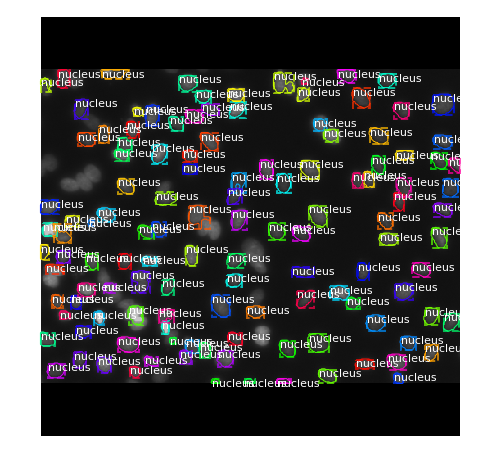

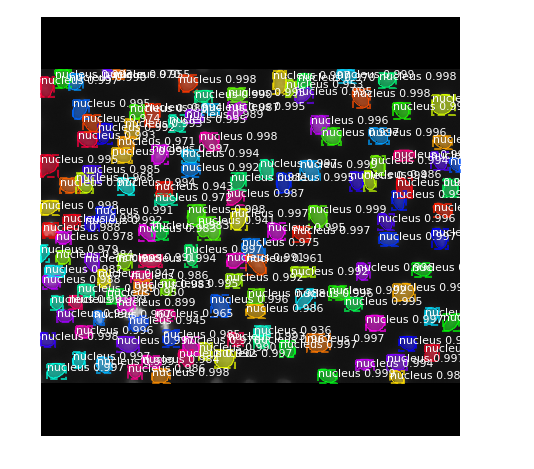

0.5 mAP: 0.8109676597933815, avg mAP:0.5194587065155312, instance_AP: [0.8109676597933815, 0.7804051193049122, 0.7224857984660855, 0.6989533775291372, 0.6139986073316455, 0.5380804563477907, 0.4461807318890916, 0.37178430069529206, 0.19992122048530264, 0.011809793312673096], shape:[520 696], lowest_score:0.8989989757537842, id:12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40


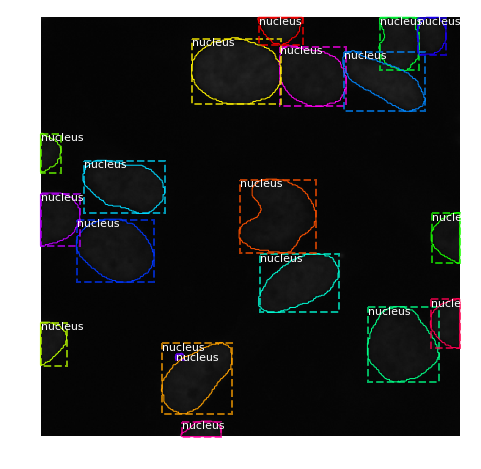

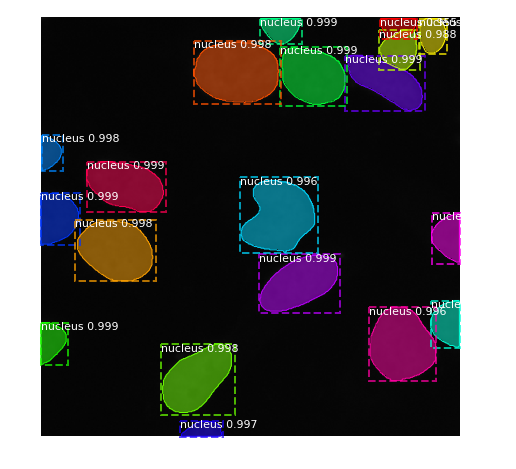

0.5 mAP: 0.9473684430122375, avg mAP:0.7928571448528341, instance_AP: [0.9473684430122375, 0.9473684430122375, 0.9473684430122375, 0.8947368264198303, 0.8947368264198303, 0.8947368264198303, 0.8947368264198303, 0.8421052694320679, 0.6052631679922342, 0.06015037638800484], shape:[360 360], lowest_score:0.9546058177947998, id:89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d


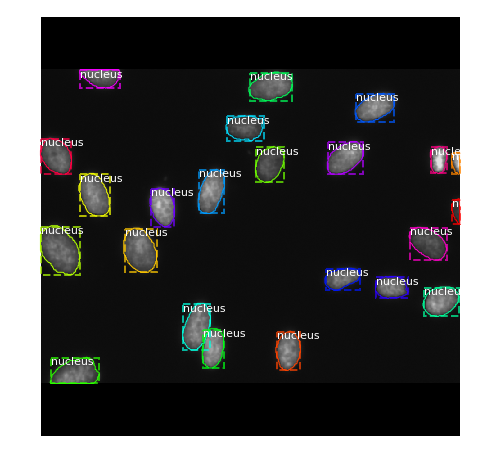

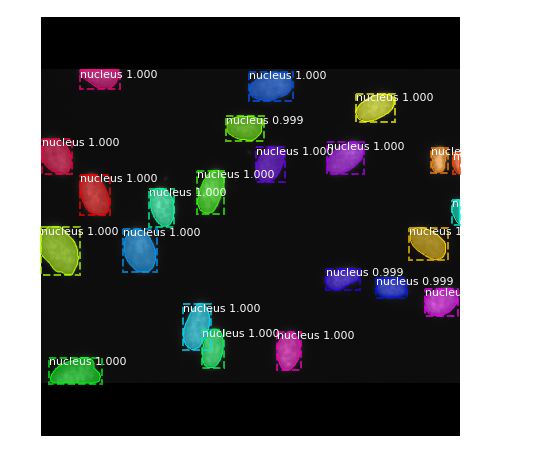

0.5 mAP: 1.0, avg mAP:0.9415928235797516, instance_AP: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9090909280560233, 0.5068373077414917], shape:[520 696], lowest_score:0.9850383400917053, id:3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51
0.5-0.95 mAP:  0.6159296951998473
0.5 mAP:  0.8399726953739979


In [19]:
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

from skimage.morphology import disk
from skimage.morphology import binary_opening,binary_closing,binary_dilation, binary_erosion
# from scipy.ndimage.morphology import 
# import skimage.morphology.disk
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
# image_ids = np.random.choice(val_data.image_ids, 65)
APs = []
half_APs = []
for image_id in val_data.image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(val_data, inference_config,
                               image_id, use_mini_mask=False)
    
    visualize.display_instances(image, gt_bbox, gt_mask, gt_class_id, 
                            val_data.class_names, figsize=(8, 8))
    
    
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)
    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]
    visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            val_data.class_names, r['scores'], ax=get_ax())
#     print(r['masks'].shape)
#     print(r['masks'].dtype)
#     for i in range(r['masks'].shape[-1]):
#         r['masks'][:,:,i] = binary_opening(r['masks'][:,:,i], np.ones((3,3)))
#         r['masks'][:,:,i] = binary_opening(r['masks'][:,:,i], structure=np.ones((3,3)))
#         if np.all(r['masks'][:,:,i]==0):
#             print("all zero")
        
        
        
    # Compute AP
    # Compute AP
    instance_ap = []
    for iou in [0.5, 0.55, 0.6, 0.65, 0.7,0.75, 0.8,0.85, 0.9,0.95]:
        AP, _, _, _ =\
            utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                             r["rois"], r["class_ids"], r["scores"], r['masks'], iou_threshold=iou)
        
        APs.append(AP)
        instance_ap.append(AP)
        if iou == 0.5:
            half_APs.append(AP)
    print("0.5 mAP: {}, avg mAP:{}, instance_AP: {}, shape:{}, lowest_score:{}, id:{}".
          format(instance_ap[0], np.mean(instance_ap), instance_ap, image_meta[1:3], min(r['scores']),
                 val_data.image_info[image_id]['id'].split("/")[-1]))
    
print("0.5-0.95 mAP: ", np.mean(APs))
print("0.5 mAP: ", np.mean(half_APs))

origin_size:(256, 256, 3)
Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  121.00000
molded_images            shape: (1, 512, 512, 3)      min: -122.70000  max:   17.10000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000
(512, 512, 11)


/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel_launcher.py:38: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


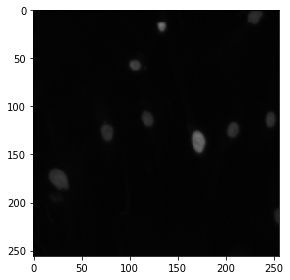

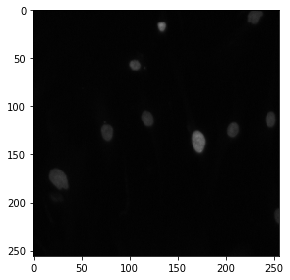

(512, 512)


/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel_launcher.py:33: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.


In [7]:
i = 0
# testing revert_resizing
img_data = test_set[i]
origin_img = imread(os.path.join(base_dir, 'images', img_data['image']['pathname']))
origin_size = origin_img.shape
print("origin_size:{}".format(origin_size))
resized_img,_, scale,padding = resize_image(origin_img, min_dim=512,max_dim=512, padding=True)

results = model.detect([resized_img], verbose=1)
masks = results[0]['masks']


revert_img = revert_resizing_3d(resized_img, origin_size, padding)

assert(revert_img.shape == origin_img.shape)

print(masks.shape)
imshow(revert_img)
plt.show()

imshow(origin_img)
plt.show()
print(masks[:,:,0].shape)


for i in range(masks.shape[-1]):
    mask = masks[:,:, i]
    reverted = revert_resizing(mask, origin_size, padding)
        
        
# for i in range(masks.shape[-1]):
#     print(masks[:,:,i].shape)
#     print(revert_resizing(masks[:,:,i], scale, padding).shape)
#     imshow(np.squeeze(masks[:,:,i]))
#     plt.show()

origin_size:(512, 640, 3)
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  138.00000
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   34.10000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


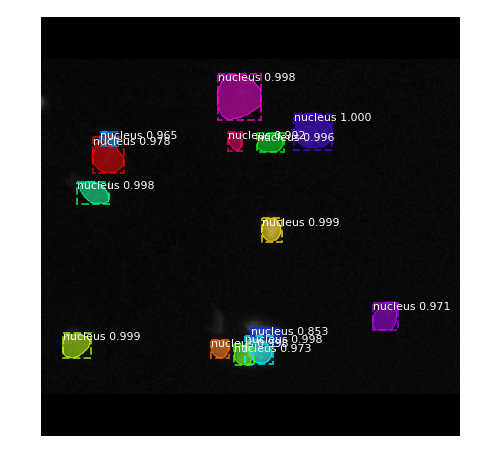

/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel_launcher.py:40: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel_launcher.py:34: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
/home/keven/miniconda3/envs/tensorflow/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:74: UserWarning: Low image data 

14


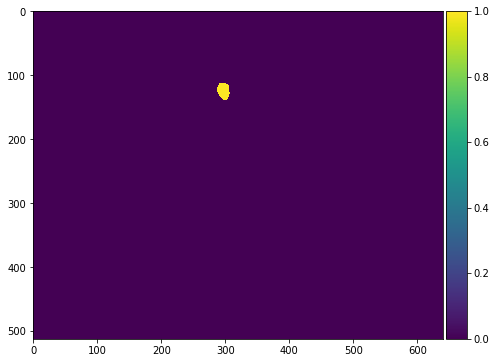

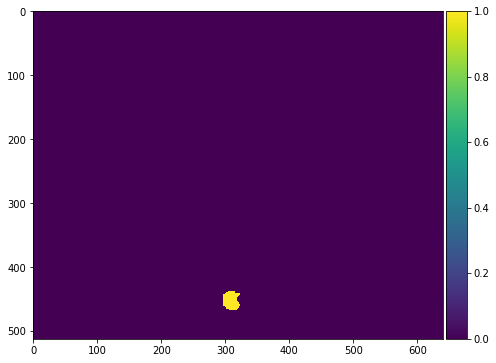

(array([], dtype=int64), array([], dtype=int64))


In [11]:
# debug image
i = 2
# testing revert_resizing
img_data = test_set[i]
origin_img = imread(os.path.join(base_dir, 'images', img_data['image']['pathname']))
origin_size = origin_img.shape
print("origin_size:{}".format(origin_size))
resized_img,_, scale,padding = resize_image(origin_img, min_dim=512,max_dim=512, padding=True)

results = model.detect([resized_img], verbose=1)
masks = results[0]['masks']
r = results[0]
visualize.display_instances(resized_img, r['rois'], r['masks'], r['class_ids'], 
                            train_data.class_names, r['scores'], ax=get_ax())



revert_img = revert_resizing_3d(resized_img, origin_size, padding)

assert(revert_img.shape == origin_img.shape)

reverted_masks = []
for i in range(masks.shape[-1]):
    mask = masks[:,:, i]
    reverted = revert_resizing(mask, origin_size, padding)
    reverted_masks.append(reverted)


# inter = reverted_masks[2]*reverted_masks[5]
# print(np.nonzero(inter))



print(len(reverted_masks))
plt.figure(figsize=(7,7))
imshow(np.squeeze(reverted_masks[8]))
plt.show()
plt.figure(figsize=(7,7))
imshow(np.squeeze(reverted_masks[10]))
plt.show()

inter = reverted_masks[8]*reverted_masks[10]
print(np.nonzero(inter))
row, col = np.nonzero(inter)
if len(row)>0:
    reverted_masks[8][row, col] = 0
# for i in range(len(reverted_masks)):
#     for j in range(i+1,len(reverted_masks)):
#         print("i:{}, j:{}".format(i,j))
#         inter = reverted_masks[i]*reverted_masks[j]
#         assert(len(np.nonzero(inter)[0]) == 0)


In [7]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [8]:
def unpad(img, pad):
    y,x = img.shape
    top = pad[0][0]
    bottom = pad[0][1]
    left = pad[1][0]
    right = pad[1][1]
    
    startx = left
    endx = x-right
    starty = top
    endy = y-bottom
        
    return img[starty:endy,startx:endx]

def unpad3d(img, pad):
    y,x, _ = img.shape
    top = pad[0][0]
    bottom = pad[0][1]
    left = pad[1][0]
    right = pad[1][1]
    
    startx = left
    endx = x-right
    starty = top
    endy = y-bottom
        
    return img[starty:endy,startx:endx, :]


def revert_size(image, origin_size):
    result = scipy.misc.imresize(
            image,(origin_size[0],origin_size[1]))
    return result
    
def revert_size3d(image, origin_size):
    return scipy.misc.imresize(
            image, (origin_size[0], origin_size[1]))

def revert_resizing_3d(img, origin_size, padding):
    unpadding = unpad3d(img, padding)
    return revert_size3d(unpadding, origin_size)

def revert_resizing(img, origin_size, padding):
    unpadding = unpad(img, padding)
    try:
        return revert_size(unpadding, origin_size)
    except ValueError:
        print("error img, shape:{}, unpadding shape:{}, scale:{}, padding:{}"
              .format(img.shape, unpadding.shape, scale, padding))

In [9]:
### stage 2 prediction

import warnings
warnings.filterwarnings('ignore')


# Run-length encoding stolen from https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# convert single mask shape (h,w) into a list, 1: foreground, 0: background
def rle_encoding(x, total_pixel):
#     total = x.T.flatten().shape[0]
    dots = np.where(x.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

from skimage.morphology import binary_dilation
from skimage.morphology import disk
def refineMasks(mask):
    return binary_dilation(mask, disk(1))


def single_image(image_id, path):
    lines = []
    image_id =  image_id
    origin_img = cv2.imread(path)
    origin_img = origin_img[:,:,:3]
#     print("origin image shape:{}".format(origin_img.shape))
    resized_img,_, scale,padding = resize_image(origin_img, min_dim=512,max_dim=512, padding=True)
#     print("handing img:{}, scale:{}, padding:{}".format(image_id, scale, padding))


    results = model.detect([resized_img], verbose=0)
    
    scores = results[0]['scores']
    masks = results[0]['masks']
    if len(scores) == 0:
        print("no mask predicted")
        return [image_id+",1 1"]
#     print(scores)
#     print(masks.shape)
#     visualize.display_instances(resized_img, results[0]['rois'], masks, results[0]['class_ids'], 
#                             train_data.class_names, scores, ax=get_ax())
    s0 = 1
    for s in scores:
        if s< s0:
            s0 = s
    print("{} masks detected, lowest score is {}".format(masks.shape[-1], s0))
    
    reverted_masks = []
    for i in range(masks.shape[-1]):
        mask = masks[:,:,i]
        reverted_mask = revert_resizing(mask, origin_img.shape, padding)
        assert(reverted_mask.shape[0] == origin_img.shape[0])
        assert(reverted_mask.shape[1] == origin_img.shape[1])
#         reverted_mask = binary_opening(reverted_mask, np.ones((3,3)))
#         reverted_mask = refineMasks(reverted_mask)
        reverted_masks.append(reverted_mask)
    
    for i in range(len(reverted_masks)):
        for j in range(i+1, len(reverted_masks)):
            interaction = reverted_masks[i]*reverted_masks[j]
            row, col = np.nonzero(interaction)
            if len(row)>0:
#                 print("before, {} pixels overlapping between mask {} and {}".format(len(row), i, j))
                reverted_masks[i][row, col] = 0
#                 print("after, {} pixels overlapping".format(len(np.nonzero(reverted_masks[i]*reverted_masks[j])[0])))
                
    
    for i in range(len(reverted_masks)):
        assert(reverted_masks[i].shape[0] == origin_img.shape[0])
        assert(reverted_masks[i].shape[1] == origin_img.shape[1])
        rle = rle_encoding(reverted_masks[i], origin_img.shape[0]*origin_img.shape[1])
        lines.append("{},{}".format(image_id,' '.join(map(str, rle))))
    return lines

with open('final_35_0.7_final.csv', 'w') as f: 
    f.write('ImageId,EncodedPixels\n')
    stage2_test_ids = next(os.walk("data/stage2_test"))[1]

    
    for i, id_ in enumerate(stage2_test_ids):
        print(id_)
#         print(id_)
#         if id_== "3941e8ee13e676eaac15787fd9c4bfe49480fa29afd6a27c0fdc3494117b181f" or \
#         id_== "6f4a97442f9f1291f7121defb3efecc2d33806818162ac1dd8356a2ec94ebeff" or \
#         id_== "af04bfee62b59bb1af5a37917b0043dcd5f78dd85f158cdf8513f059a32e44ac" or \
#         id_ == "9e5d66bbeed4bb8b498484b9495297508875cc793f5d8b527efb4fb746157a1f" or \
#         id_ == "db81b3fb021bac52ba3d95335653a1eb9d5f64eef22d6f8f8e006eb815d5c2dc" or \
#         id_ == "e4774e75cc7f088dfc9f6cf2f7edafcee8978de0bf9aa0a5d90338331d0bccc2" or \
#         id_ == "aefb2b9e189340821de0d5b9a0e603308e1015e314ab279be26130ddbbbf1ba2":
#             continue
#     for id_ in ["3941e8ee13e676eaac15787fd9c4bfe49480fa29afd6a27c0fdc3494117b181f"]:
        path = "data/stage2_test/"+id_+"/images/"+id_+".png"
        lines = single_image(id_, path)
        for line in lines:
            if line.endswith(','):
                print("no pixel in mask:{}".format(line))
                continue
            f.write(line)
            f.write('\n')
    
print("submision file completed!")

3afbb19787ad9881de4612d7f5ea2142abc3489b68754d06d2ea7eb95cb11974
4 masks detected, lowest score is 0.83244389295578
044f134c2689f632f98a722b6c3894ae5828069239365cc5fb6bb502c6ea5b96
32 masks detected, lowest score is 0.7282692193984985
3941e8ee13e676eaac15787fd9c4bfe49480fa29afd6a27c0fdc3494117b181f
no mask predicted
24928d37f8e4704fed57eb9521248f6e6680f581d487f8aae44491d8ac52d01f
37 masks detected, lowest score is 0.909098744392395
3e17cf9afa9de40568081516c9d1559db925db3f85bb7e1a507d8cfcd66cfce2
8 masks detected, lowest score is 0.761549174785614
0d544ac6367dbfa5aae67f2b4de15f647a2cb47368de4e596b4c770178db7693
20 masks detected, lowest score is 0.7480538487434387
c16fd5e4a08ca43464402e51193baa5fdeab2094b80462d3ed9026cc106d60a7
8 masks detected, lowest score is 0.7073574066162109
011cf78028a792b25416d03720aa170e9afd3c08e132f10ce6a08fd7806db9d9
3 masks detected, lowest score is 0.8066686987876892
f3af8683023899660a437a86676d83e3a2ecf5ff33dd3e7519844859569369f7
23 masks detected, lowest s

36 masks detected, lowest score is 0.7256374955177307
44dfb5d39157bef09971788299c077ffe9d66c4b920e08b2ce91a6898fd4e04c
15 masks detected, lowest score is 0.8475466370582581
bbd3e33a0d986860bb0a9840d3e485db5c567a8e94e2113ecfe4958f4facc1c9
1 masks detected, lowest score is 0.9708650708198547
062f4c594159fde85688687b6153d789ca649419e5728f9a198e52f7d4d540aa
14 masks detected, lowest score is 0.7225174307823181
e4d0c5aeba41c45502606c369134302dcf45afc523be02ebc9386cf33cdca71c
20 masks detected, lowest score is 0.7525196075439453
39e7718914b1b900025267be2fa4bab0db932c52c98545a25c2ac41ac7d64c38
56 masks detected, lowest score is 0.7370356917381287
d94442da5c5373e6cf65f1106863b0affedac80e73ac821bc8911b6d6facff6d
126 masks detected, lowest score is 0.7191660404205322
e4ee832f382208df2dece4b4a5dd8a45576ce1e792734f38b0bd12e2e1a4dda9
80 masks detected, lowest score is 0.7292281985282898
4d5641a258739bdfc3f1934b823157fe26f9b3dabb62e6373cb9f97d1e896262
no mask predicted
6c7bfc868f271c2cc5ef8faebce0cb

545025f2f36c1fa26e8bec38a117560800e557689653e931c13d3141b4018d56
3 masks detected, lowest score is 0.9475635886192322
ff6bd41cbb8c7666eb6c3c375b97c69d7d09ba121fe1c1e9b85b70c33b3c14d5
no mask predicted
8dbf971f9f33aed6e1444961511d42ad539a0dcd6611b2f14bc2ef6701c96175
15 masks detected, lowest score is 0.723565936088562
b73790fc8716fca1c8d1a173f903fbf39bae878704fd5da86823b7fd9c96b98d
18 masks detected, lowest score is 0.7286332845687866
f77e0a7408802b56ad0d44915a882003dc048a8c04baf531b8280f8c3d804e07
229 masks detected, lowest score is 0.7003297209739685
8b80aca225c1dd0aa5637229f0e0bec0dbd7b5313b462effd768da2bb5a56a06
54 masks detected, lowest score is 0.7057626843452454
3256845310ed88c59805c285b46519848203263bbe7dce67c3f2a27e27b9c17e
no mask predicted
4283c79c62edaecac482d0c146bac57b332fd179c294b9972e95901766abde68
3 masks detected, lowest score is 0.9658822417259216
77981e76692a8bc12cf419daa1afb7933224f121e57fe37c708e128a011d6df4
no mask predicted
04a27d1c538475fd8588b10898c334bd0c22b89

202eb43e191b025fea05a51cee63fd9bc969a65a34e86ac84dde59c3287ebd26
no mask predicted
f95b1128aea15019e4aafee22a07407f5b56c51ea483a5ce9d6968ab564f5c0d
11 masks detected, lowest score is 0.7680304050445557
30bb020e2520ebb21f107d541aa269dd86af1eca08ee2a45196a87dd4c490d7e
13 masks detected, lowest score is 0.7021277546882629
cbce341887726e1876190b8d50fe12225abd7d0178cc25ae8952d055b74b60a5
no mask predicted
cae6a300a13d08dd1e740f517b350e91bddde76b99022acf57ce7173d40691a9
3 masks detected, lowest score is 0.8006631135940552
1518fff146a77fa6b0f0ee5ece61ea526f4c0767ddcfe680095560415ba0c78d
114 masks detected, lowest score is 0.707143247127533
25674d257bb438bdece878aa89e5cf3cd702e6e6fef1f2d00a4b1bdf5c5d893d
8 masks detected, lowest score is 0.7283642888069153
4f6b8ba63c0f51654242b78818e0ce6228e46317cb93ead2b0e4e8f162d59d0b
37 masks detected, lowest score is 0.712378978729248
7b9c0a511554796ef3a8c3186e43aca1fb5f683e13f93e5278fb2a9f4ccfdb40
6 masks detected, lowest score is 0.82438725233078
c58bec0

2 masks detected, lowest score is 0.990862250328064
4af0113a8c14708f2d2507403cac3dc078b848f37b81dd8c35b1d9e726e5d82b
1 masks detected, lowest score is 0.9611631631851196
6e70ea1962d32accac341b9f31a1ba03fa1ed64923ff0b3975eca34c4cdc4983
36 masks detected, lowest score is 0.9972183704376221
ec54bb85006c1a4ebfcc87aa0d369c6ce1bf85ef898c613b490c9dcce379e096
8 masks detected, lowest score is 0.7165554165840149
1edd67f41a030b1c04828e2f58581751b960b5941e6d39239b5cb57653f6b0a7
153 masks detected, lowest score is 0.707595705986023
fc42ec97c6a0a90cb7bc4935592d8889040dd472f149676aa94bd1ba51f5ffbc
43 masks detected, lowest score is 0.7867915034294128
c72cc16ed3fa458c56e28cad533b2a8850b36007b41d0357fccdb35251133781
111 masks detected, lowest score is 0.713959276676178
28cd702f96c9d3956683efba84f9d8f82fe60dfc9c15f429178104d8a0b6d743
4 masks detected, lowest score is 0.764823853969574
4c9f76aa783818aa1c3506820b995391afb06a36fd034de44311364e6e161bc0
33 masks detected, lowest score is 0.7861942648887634


13 masks detected, lowest score is 0.7102228403091431
8163466977a478105c35d0ce0cf4ffe5e46dced77f91287c6a3b77a67c52f316
10 masks detected, lowest score is 0.7067336440086365
d565b03be7d28d4b0fdca0ed9ab79479ec58eb14404241ffaa0fd7cbace83ac6
1 masks detected, lowest score is 0.9809191823005676
dece54c462ad74149f3d55431258c98494bf236be1f42c8b5b3f5a360da9db5c
8 masks detected, lowest score is 0.7537305951118469
682bdb6fdfec6076b0cb1a40f95a2b87c6b2a3221ceafdad01b0a150233e5d67
15 masks detected, lowest score is 0.7495180368423462
096fd2d21b5c093bafd71c5fd34a84fc91e78d16d5275a21ee3a4f81ba7ff697
42 masks detected, lowest score is 0.7496890425682068
08827cf8e293ff3d644763aa6b6b7e745d3129c74dcc5bdb385a2ae34a4f7b87
5 masks detected, lowest score is 0.9983304142951965
d497cb7652f3f179e0c91bb422c4df92dd8e9ea413f1b58eda52fe807297afbc
97 masks detected, lowest score is 0.7060743570327759
56f18b5fa2acb19ee19482808ce9532ed3429fde292f2adbc00f30effcc7d1e0
17 masks detected, lowest score is 0.72552251815795

5 masks detected, lowest score is 0.7437816858291626
9969c14820252f240d05f3a652ae2d9d69b575625e4012ebd5d151ec5227ad65
99 masks detected, lowest score is 0.7043913006782532
6dd1dd0e5c49f42f160abdf4a5d329d3995daf669253a053c52bf23f51dce89a
no mask predicted
9079897a543f209c7272e854882037747a0d49f274a6e1ece18b04d23062757d
no mask predicted
062853fcb3bdbb8c3910b102e6d12c0e823b06b39cba0efa5d506ffb1caadda7
7 masks detected, lowest score is 0.7168357372283936
538c81fdd5f388774e8779c5842574ced039febb74339378b1b6593871754299
115 masks detected, lowest score is 0.7135170698165894
03c2082dbb453f17e874c644bc9e88bec92a79af41c9111a4d52a9554bc417a0
22 masks detected, lowest score is 0.8205695748329163
bb086ece18e1f3ebfff2234ed29fb4d06d051be9377ce0bddb38a238798bf3e7
1 masks detected, lowest score is 0.7871553301811218
97433bfa5f66fe153e2aec712f2dd7feae7a47c69b46d2943d6315bd54bd0e02
9 masks detected, lowest score is 0.7175620198249817
8914f2d812d2efc27ff0dc62ed95954ff5887bb20977ca0fb5d0f95b04d7e32a
no m

11 masks detected, lowest score is 0.871722936630249
60253db0ed7504e07ffadf7ecc724a2ce6a10e387f4260af5f0744c1330281bb
58 masks detected, lowest score is 0.7098250389099121
4502f3aa3e955dd3732058af637357aba37a16f26875c33b586955d15ae90df8
5 masks detected, lowest score is 0.9245063066482544
0cdef02317b299e41d2a01f1339e062882b988728f6071b035adec3aec8544f1
6 masks detected, lowest score is 0.8056278228759766
4dc5a931b6c19f595a080a6bd2c3a83ad9b77c3fa22acdc2f5c85c9b81946b0b
21 masks detected, lowest score is 0.7068007588386536
72781a4e2470e38f7d70d32ba2a93408d9a8b0b21c40734a54813daf6bfddeac
47 masks detected, lowest score is 0.9434711933135986
f7c60564c8da0a484eb81b011f8fcc46c5749d20b012d02fce365b850f0397b1
95 masks detected, lowest score is 0.7184810042381287
826d3421c938de4764af6737fce6a4f9d91af4ca4b7731b0630679726759f13d
57 masks detected, lowest score is 0.7003718018531799
e40196bc514419e8474157bdab146c1ab1492bf33f0411b8f9fd0a39065c6cb1
6 masks detected, lowest score is 0.730915963649749

98 masks detected, lowest score is 0.7093170285224915
f66aca8304edd0154b5c0af9bed65503e62a15152e985fc7c0b09549c99a3618
2 masks detected, lowest score is 0.8126212358474731
8faafa0a4b2c8e072f7c84c6ec4edb758ea3bc3b8a8424019fd67cf22b985923
24 masks detected, lowest score is 0.780935525894165
471f53debb240580a6227ce4e32d77756cfe76b3b504e4fafef2aab39f92ba08
103 masks detected, lowest score is 0.7134562730789185
b083e597b2cd3f7fe8f8ae24b0e38f569314b36a4c7c10442a2e5225d757e1af
24 masks detected, lowest score is 0.7035863399505615
c9aa5f44b7eea30b42314f104f497605e4c19aadfac13e79a9af9c83b34ff419
23 masks detected, lowest score is 0.7359277606010437
21046851361692aa11b65e7f92fe45d68480d949929a848687b30629a0252eb4
86 masks detected, lowest score is 0.7000595331192017
dfa7b7f1d4da24fa16e3c1dfbf6135fdf529f1ec21850dfae1b560e00ae29b66
51 masks detected, lowest score is 0.7829799652099609
6d9facf21108870819ebf0d649194337b109f4fae58d757e3819e309640f9b39
23 masks detected, lowest score is 0.772503614425

no mask predicted
d186c0dc0b94728da6c6db076a8658641b44f99f69b8c382560ba439181d3ab1
44 masks detected, lowest score is 0.7243240475654602
6a44347fdd69a71e6c473730f0b5d9b75b2c5feb781f75f5ebe9c630d6c3fa8f
45 masks detected, lowest score is 0.7001510262489319
1038a04bb677b66ad80a1a981aadf2085d6945c2a1849d68859f7816e80313d1
31 masks detected, lowest score is 0.8000476360321045
1a065fce169338fb5e02ff37c4480c7f88864aa8a03ffa671d3e5c266596ebcc
14 masks detected, lowest score is 0.7405986189842224
d04d0f17869a71b9bf87b838802e69fd260dfa170ca4f5f7d9876a193e6d51dd
14 masks detected, lowest score is 0.7276668548583984
9000dea896a65605a8b44903bc68c1e3efda49fd789b08f3b8631a8d812744c2
no mask predicted
50664b1805096e83717f86b4713c4d8f77b2a32bedaee607bbebc26de42e5504
9 masks detected, lowest score is 0.9970787763595581
679775509a6746bbe7c2cc7bd3900517373108945a74a95d27fd6d4900b3841e
2 masks detected, lowest score is 0.7980057597160339
c0ad76701f7fe05cebc7832d625aedca1f40a2a088e56a2c0f1a59503e30952c
17 

52 masks detected, lowest score is 0.7173091769218445
e2bcba9d083fa5bf5003c20b2029f9923a1c39a34c6a922f25dca057eb0c548c
10 masks detected, lowest score is 0.7173643708229065
4f2e6bdb552be0d6062cff925ab430c6dd60461fe9c893f70bb59a5fdc9125bd
no mask predicted
383d8ad7069bf55cc2e40f638c10565d9967d25dd38258afb048ab8d012d72ce
24 masks detected, lowest score is 0.706577718257904
c484bd9e79cf5e3b40c9be060804c41455e2089561adc5ea630cf24f37d5d11c
79 masks detected, lowest score is 0.7006053328514099
04301c58a7f4a4860dae496292661d09c2c5265ae4df3f7819eeae4a3d11f310
71 masks detected, lowest score is 0.7066647410392761
ce9af2c0c220c4121e8a8bfc691e27fd765be57315e86fa90eb43ba08405b29c
69 masks detected, lowest score is 0.7418989539146423
c794c0638726711c35daa5c396b22b9bdc650b031bd182c9472b4d2f91e289c9
1 masks detected, lowest score is 0.9310329556465149
3c22209bc0a8eef985f9d02400ec65815d2a068ba3e9caf61ba748668a4c8466
1 masks detected, lowest score is 0.9918984174728394
364fb54d8bcbf2d67da60c3c1f6bade82

72 masks detected, lowest score is 0.7153430581092834
7e23ad482f74d9410eb280c7d8f99f9855651f4253dd61fa92f658b4eb074883
no mask predicted
43db90aa201fdd722138d1b4ebd4ef45c060c9ab349556344054e496a0216b46
38 masks detected, lowest score is 0.7004612684249878
16b078d49301dec3368b349132db22b4657767875eef06cdc7982ebd19027d5b
23 masks detected, lowest score is 0.7101988792419434
e1b5075b350a3df6f167d1eb64fa0e1b67f2a88f14e9f07cdf04d500a5fd33ac
1 masks detected, lowest score is 0.7804940342903137
1c538f81e11b8b48ef927acdfd171f00ee7909bd6d0bd6d57c28d3277d26935c
1 masks detected, lowest score is 0.9973377585411072
c2e1a82db069dc316a1337c3134265869df9f0edcc67435865b73c46ab5b9fd6
76 masks detected, lowest score is 0.7112279534339905
8ec9eb21df93346fc1c6f72751c727cb78d17d351003df8e0812afccbaa95aaf
2 masks detected, lowest score is 0.9195245504379272
50db7a83843f2724c44c1a1938a83d04fc1288a409d67668aa8a8daa81b028ae
no mask predicted
caed4673752c9da3913464383bae15ac15a9a56e854f3918ded2c27132c41e5d
6 ma

51 masks detected, lowest score is 0.7017279267311096
0b2f4d4fa83fe59d3e15c35352a5b865ba5c451a4d043ac95af6afba41a53d81
no mask predicted
262e29525be36732d89a219bbf9d1891b4e404ac5f55915b320248d4cc4a661b
6 masks detected, lowest score is 0.7092020511627197
cccb24911ab796f773d36bc5966c092a30231cb6c6c1ac295b696c97d5a01a1a
24 masks detected, lowest score is 0.7120813727378845
899157acf8b8ed9bf6e227e3b3a1f2212a9772b62b42a502d0415326dd86dd82
1 masks detected, lowest score is 0.8459540605545044
e85088d00c22ff75722a86d8ce73ce1ae4f17b9b826c4d2160e1e49d848c1635
7 masks detected, lowest score is 0.7397087812423706
810ba443399b33cbb3b8441bbac3ab608cb95e9df0b022f0646844eff1c4417f
no mask predicted
11ef794d62ef47d62bc712171353e5223c5e8ff0308e76590a2523f855180441
23 masks detected, lowest score is 0.8678703308105469
1e7e055f4e8e3ba34d32d41f2ffe90fb16bdc421120e7050fac94594cac9315c
3 masks detected, lowest score is 0.7902991771697998
de6133ad5aa02f7544b16628616b44392da660511965b93ac7dacf00ea35df61
18 ma

7 masks detected, lowest score is 0.7012264728546143
42cf4869e304d7d993878da9452ecde91457d7bcacc974d4295f2d120e3e06ef
no mask predicted
47e9b4d19791ad074a26e613a923843b9c3db2d865b46f0f7306734136206671
32 masks detected, lowest score is 0.7043348550796509
130d8f3da79cba72ba5a1efbc8f3a956005770bb0d996461e45724800a56f913
6 masks detected, lowest score is 0.719662070274353
4d2ab894eeef95d18aad2e3d686831b2d30b5b98037f3dc67967c45cc55674ba
2 masks detected, lowest score is 0.9763979911804199
b8284c831aa08dd5ede5fd89734045a297bd19559bae998f93ca01a1529abbed
89 masks detected, lowest score is 0.734220564365387
c780f49e4e9ccc7dd5b7dbd37acfb204b197466c8ab68902666bed4104733340
13 masks detected, lowest score is 0.9844405651092529
646f5e00a2db3add97fb80a83ef3c07edd1b17b1b0d47c2bd650cdcab9f322c0
108 masks detected, lowest score is 0.7024519443511963
3cb61770e7afaa3c524689880aaab78509861a9c4d46da051d799e3f381afbd3
1 masks detected, lowest score is 0.7108813524246216
126423a74d505a5e773cbfb72605d68ba2b

e8951ba6901cf907c8e1ff8c03cb8a6f912e3206cb2afd812c51f07a5f6303ef
135 masks detected, lowest score is 0.7330752611160278
661d18ea6b1883f346fc9041ab0b19cf515b8b3d72c9eb36e24da385420da6ce
36 masks detected, lowest score is 0.705433189868927
4c6669f35af2a6e34e3db658d67079c20b9ddfaa5062d728c95ae810b5a5bb79
4 masks detected, lowest score is 0.7151963710784912
ae259989aa693d811b8730eeff0313ee64aea7576e43bc61cec8ca4e8a284e23
10 masks detected, lowest score is 0.9037205576896667
dbd9dce0aed27ec69f7a47c8b715ad52e1dad472d82f9bf050470007dc1af94e
5 masks detected, lowest score is 0.7308472990989685
afb1720a9eff5f5f2100cd4f2461545d3a6619803f148fc94f4d8f37d3319677
12 masks detected, lowest score is 0.7261154055595398
cabc4710c40674336297c24bcd134f0b7bb0ba9b53315263117bfdf99ac41dca
88 masks detected, lowest score is 0.7072758078575134
56d84a8adbcbbce78fd3ebf30203512a4369640cfe5e8e2bc8f9ddfc211d9afb
69 masks detected, lowest score is 0.7101567983627319
39b6ed3e0dd50ea6e113e4f95b656c9bdc6d3866579f648a16

26 masks detected, lowest score is 0.7044506669044495
d52fb230ee924a519236d8484a2f4e92e108089f191b9a1ced991e015969cea9
59 masks detected, lowest score is 0.8919679522514343
77ef066a8dfd7962d0f0a9914923f0e342777908ada9f0cdad2fb319f264434f
8 masks detected, lowest score is 0.7143632769584656
5969fbc7518f1b1de201177204e3f98d80df2b1efc5d50b99496707ee53b8eb5
no mask predicted
522ce42064ddfc4a0e6469ba6384b3b052da41ba26ce59f06560f9204e86bee8
3 masks detected, lowest score is 0.9123144149780273
c211e034610f159b0d824be86d88be3d3a41b5118a31cf66d3d89324908c84ed
9 masks detected, lowest score is 0.8552587628364563
7f6f479d50008a4e7dbdd28e30e42596c4c90adbc0b0b7c8f78a79517a80f4d7
54 masks detected, lowest score is 0.710095226764679
6c1bf9d44a59807d58193234d98eeaabb7deeb6293b0562663bf2786a45a589a
31 masks detected, lowest score is 0.7749039530754089
439913d0deb39e4491e4e6d56e3de51c6f4cd5909f978fc04f9a306908c0f1cc
13 masks detected, lowest score is 0.731184184551239
5d0cbd240272ee88a41715cbfa7b4febfff

21 masks detected, lowest score is 0.737993061542511
7b65cac8e559de50fa2b64d621c5bc0f28308d6ec2effefd1df31f794301c441
13 masks detected, lowest score is 0.8982651233673096
20e13e489ebd23f7ec90c67101e07a7c6196c7dbd6c79b680397dca5b3ff05f2
99 masks detected, lowest score is 0.7024872899055481
40d15d4e63851b35abc686ca61b1328e8b90391eefbd5f4c4a0eef0cbf8f3fbf
62 masks detected, lowest score is 0.7080820798873901
7fdc1f8bddaec9d8024a5c2491f911859d50a6f2b3366a65f3e50e7ae844c43c
7 masks detected, lowest score is 0.989620566368103
6dfaabce62b59fe3d5c6372a9adc6eb9ade8840cb1c928851f49d4485004b203
1 masks detected, lowest score is 0.8866615295410156
0f0536b658a471141ffbd901fb579e01ae6bd9c85cf80dbef605783036f091bc
50 masks detected, lowest score is 0.71445232629776
c670e03f4b6e3dddbd15b78f7ed7c79c53dc215575daa1c35a2b2902ea56a98e
132 masks detected, lowest score is 0.7081406116485596
4ff0c001197ff04b8bc902cb0023d43b8a0ffd4685f7328d9092476aec95f36b
1 masks detected, lowest score is 0.9930703043937683


28 masks detected, lowest score is 0.7564929127693176
fc40ddb37a7c3b9dd58f78ff59533792adf746387f82914477d00a0661276342
40 masks detected, lowest score is 0.732401430606842
f6cbd00141b5067c7ebf95e22a0d4fc89be8fa8851a7fbb4a922e2d5a53ca262
no mask predicted
a03a8b38411cc62d0c6575dc33e2f98642e8a67880ca05799b4fabc76fabd1fe
89 masks detected, lowest score is 0.7138862013816833
5ce34806317fdd3b7d38ff07a067e739db4ec7a5e050df093474b0c825938a5e
7 masks detected, lowest score is 0.8106138110160828
5167324c328ab6bda48f02b204d548c91202e5b2e3007eb32c28277a885cbbe2
30 masks detected, lowest score is 0.7059666514396667
01ca6877c2c98369b40946563a4d90372fb86b3699dc0ccf860d74935339efa7
3 masks detected, lowest score is 0.8213965892791748
195d4331bb0c91b82c42d5fe39c237c383109d52e47c17b5c324a73d68efbaf8
19 masks detected, lowest score is 0.7025400996208191
a1078a2bf136f069120e5b696e63a2f8eb901e5f144676456bc6afa8b5a18025
54 masks detected, lowest score is 0.7027906179428101
56bafc25bab7259f932f2500b1194b6d9

13 masks detected, lowest score is 0.7233718633651733
55d34eebcb437f5370232ed6a0c69c4fce5c1ba26ed7c53c86fda3daf019a2b7
10 masks detected, lowest score is 0.7409254312515259
16e5f3f89ae463d087b2f2dec239f0dabfaca9226b18e90dc3511b53efd457ec
64 masks detected, lowest score is 0.7026448249816895
7b58698b0ae67487db98e3478a30a596f5417a371771e10e2dac28baecf90abb
45 masks detected, lowest score is 0.7092400789260864
a18985a2397df0cb26da53500399591baadd4271c7463c66d0186657ed2a5fdf
29 masks detected, lowest score is 0.7557142376899719
ecc237bb5e3eb2398abc7922e45291c9a963c15d9f86ff8019a5b25319958a70
9 masks detected, lowest score is 0.7944164276123047
4b16ef562cd41c4205a9202a26fa712e730e44d2362abe14f3f3a88338758c97
22 masks detected, lowest score is 0.7108016014099121
e519382bf2f2e9bcd64082a580ef841a7d3d8d1ce918c8bc3e531596f1d9b1fd
4 masks detected, lowest score is 0.9229379296302795
51c141845c8ee40c5bb4cda2a7e5926fcc4956b66d5118c481528b79f5366d53
1 masks detected, lowest score is 0.78837323188781

30 masks detected, lowest score is 0.9863167405128479
882349e99a7232c0d0313119fc94cda0f986f9fe5d65a65d1711ae3bd25cb1c4
10 masks detected, lowest score is 0.740270733833313
1464ec86594f7fffec318577f7ecaee8f10d203dacfe808aa1d89d013f886f40
4 masks detected, lowest score is 0.9430948495864868
no pixel in mask:1464ec86594f7fffec318577f7ecaee8f10d203dacfe808aa1d89d013f886f40,
26c1d69c426023b9051721d68bd079ef627443c764b6faf91d790a133d595c4a
28 masks detected, lowest score is 0.7332849502563477
b57ae10da2fe82b83874d51f18d9a76f2e374759c754734a5dddf812a50a1317
39 masks detected, lowest score is 0.7019356489181519
1c08acfac6e7f3dd378f673ef694b3a230e272c7159d54943dbc5bbb050d5dc9
9 masks detected, lowest score is 0.7528330087661743
dc2c73ae5d8655abd4b4ccb5d7318e1d36657026abcf7dba036dbb08e4909d6f
25 masks detected, lowest score is 0.7067355513572693
f467b31e6470e27743d31d5df0fcba33d01cd930342fa25ef25a2d1a5bff7f14
8 masks detected, lowest score is 0.8206749558448792
d8cfb5b1cab2ca009f63b89dfc8cc05571

no mask predicted
521f61eac4c483489912c4e233ee47ec3b4d255e29ffbbb58c92c19ab7235073
2 masks detected, lowest score is 0.862977147102356
28a165948c0e3c7d0610951cc29a67c52842fc95e631a63a756c30ebde94eb28
32 masks detected, lowest score is 0.7111318111419678
d89fe943912888b15bcb94971abe1526f833d25847bcf2d088f68f171b039434
31 masks detected, lowest score is 0.7485191226005554
ef7fe0e385fe9ced4a3386da03f6006f9ca476a31acacf3a30d444a59ad764c2
8 masks detected, lowest score is 0.8026542067527771
eb11f6a98fe5b611d3f3836a5c4a6fa6eeb853587b83ee07b66c39b92fc0e1e3
no mask predicted
ed7fe4d266acc1d97f88d569446bc4ba7b3e2786334ec11288f73a0bd90c2efa
49 masks detected, lowest score is 0.7685837149620056
bd03179d6b1d6623f972f9c5fa01456ed30a5ffdcb6a91e36a422b45b9be787c
no mask predicted
2ac1e92c749e54b5bad111be1220d0ea07dd176a48c51fac4c212f2b7aeec8af
2 masks detected, lowest score is 0.975197970867157
50618bbb33b113822cb06921e213768dc2bfef72e200931b21c4a3a0e97cb4f3
57 masks detected, lowest score is 0.70289

50 masks detected, lowest score is 0.7137427926063538
4acb5d3104939f317afcec22feea5768bd008d38a99319f51ad3d89ec0eaf887
8 masks detected, lowest score is 0.7360150814056396
5662665ab4b6341818f74b029f5f997f81320312ea34bb8d2b4c55dcb8cd84aa
44 masks detected, lowest score is 0.7007713317871094
5b033e0f7a2b6c8e42491752c47a87e2d60cc3360310b523ed5e39a6bcc7844f
43 masks detected, lowest score is 0.7054373621940613
459a21a6862bd0c8694cc21c90a66306ac5f2a25473ddb0c38280cc798d20685
3 masks detected, lowest score is 0.8616288900375366
3885a5fd09669cf5fcf19fab18708197cf67aaaa971fa67fb1f86d44f047a87c
8 masks detected, lowest score is 0.9967771172523499
36d1e5cf9afe49cf8b116645d41ce926ff462c025694041bc835c50093aaf393
18 masks detected, lowest score is 0.7019158601760864
13c94436227572f52ffa3a8d721a423d287f5437d1d5c273dcc4d4a6970bb73f
8 masks detected, lowest score is 0.7185223698616028
406b4c2e9610ef28f5167e7d995be83785a36b6b3323a2a9f82a23c90a5e68e8
17 masks detected, lowest score is 0.723726570606231

2 masks detected, lowest score is 0.9457117319107056
89d105b40aad570b910dd70a8ebf6cac8c9b96f67ddd5442696347515c23b8bc
3 masks detected, lowest score is 0.8858880996704102
f1a400a26267c45ad4b88571522d1657fc4aad568f785bc24631741328dfc583
3 masks detected, lowest score is 0.9820842146873474
182e7af5aa80d7a44e0864e0dcfcc2be1fc48f672a4c8a5c29bbca8e0116512a
5 masks detected, lowest score is 0.80707848072052
8d4f480d1f78dfbbd5ba0cea23ee4245fd4809e32f405d47d0a631763da98440
1 masks detected, lowest score is 0.9913546442985535
251615447f0a1e706cc5148189bc32222fb638fd09d55357e8fe3da6400ca179
7 masks detected, lowest score is 0.7240068316459656
1457b924eb3dfe311906ed2c9caf2d09d9c534410997d4afa5f0a32de3aa07c6
36 masks detected, lowest score is 0.7310529947280884
fac5068b5f17c8ee88ecf97b94baa6330fb4cd4034225f73c46e106edc971882
175 masks detected, lowest score is 0.7133070826530457
8b91f7929b02827f1c7e0c7998973e68659dc0d382ba02a450cff2dbc2155765
11 masks detected, lowest score is 0.9318113327026367
c

8ff1a54840bd0eedd0da17dadd9c315a9e616feb33fef9d987221bebc12476bd
7 masks detected, lowest score is 0.8678337931632996
c1c482edbf4a5522e6122b3b72d6bc43b51c3bffab4c3304a78561c6269a753d
no mask predicted
45134296c18e03abe9322b8848b80b7400d846f76d9e314401b4185d57826f33
8 masks detected, lowest score is 0.826195478439331
no pixel in mask:45134296c18e03abe9322b8848b80b7400d846f76d9e314401b4185d57826f33,
no pixel in mask:45134296c18e03abe9322b8848b80b7400d846f76d9e314401b4185d57826f33,
7273d0c28fa21fdbed19b79e952d6229eb7f5d88d0ac3d05e21054fe99ebc3ae
115 masks detected, lowest score is 0.7200335264205933
d3d79bbfaeb8828e01df87f0fb8acb153d66b62315e5ff979d7a959f0af58c6b
3 masks detected, lowest score is 0.7588727474212646
d4ebeb43283fb436f5e4f1cc3d586645f0567100989dcad62e090e0c2f5c6ce7
10 masks detected, lowest score is 0.996190071105957
dca198e6d78a05db2aaf835e7fd8972915c76b334a3bc65cd96a76b866a1401b
7 masks detected, lowest score is 0.9963002800941467
132c14db1900135283be3bf3116545d98633a0f4b3

7 masks detected, lowest score is 0.7298069000244141
9a1e4913c07b3026c8a5fd16b8537524f4f22ac04658b1198b1db2098d0a96cb
40 masks detected, lowest score is 0.7136449217796326
8aa050b5751fdaa5c145f6846dd03eb7a0202f506b34605c9d39d4f19fa5840f
89 masks detected, lowest score is 0.7242363095283508
89bf7bc700f191fa87f1a6f4ec261c8b73a61eec2174caabfd92bc61297cd776
126 masks detected, lowest score is 0.7009985446929932
3d95e0ceb751ef6e81b87c5fbfed90dba4c0b82c7a4e29b3ff492aa59dc3e4aa
1 masks detected, lowest score is 0.9607800245285034
78a0fb84f913c4cb8c101c7b195bc5b1d538a19e9f243a9698379d77854cdd14
3 masks detected, lowest score is 0.8878480195999146
e4ee382ce0d8773894bd602d99215e363d3c0368daef4b5e872c42a0a984f44b
39 masks detected, lowest score is 0.751666784286499
b953f9adc0ab292fe27fe61524401ad5e19dc599766653e63269af6d9a02b4c9
15 masks detected, lowest score is 0.7192353010177612
ba0a338be62257f198d09ec507de16299008ee8ff9bdddbf36f67a5e63f563c9
79 masks detected, lowest score is 0.70287781953811

4 masks detected, lowest score is 0.8922349214553833
e15c40dd9254c2c123a840b9d111785d0013a73011a536b3c205a3bcd6d7243c
no mask predicted
1403d75f675461a028e9dc14807f403888cabc26f6ca11e7d8678417c1142595
19 masks detected, lowest score is 0.7587818503379822
1f63d8051fc448fa27b22fbc0097dfd1accb518cc258f6ae6be1383c9aa45681
1 masks detected, lowest score is 0.9398898482322693
436143e3e70422c13b70eca769e7e7784a89b6c6264cc9d553af65fc20b16937
105 masks detected, lowest score is 0.7142777442932129
1c1067f297fa0d77411edf6e66a5c9fa5a9467ad75a8d297e848e6801ccf61c3
8 masks detected, lowest score is 0.8709686994552612
cb8328b601071c1d16873b8704df0abcbd45a2a71299e446a87777b8aab16bc6
4 masks detected, lowest score is 0.886730968952179
1d98735f3f98dc680a45a352c4c2e9aad36112604d847c27c4a58a88807808ba
1 masks detected, lowest score is 0.7313646674156189
223214408b7edfe174ee0c6969d0a3b81328e6df38680c0a7a5365b8824a2876
11 masks detected, lowest score is 0.777819037437439
ad64787bcd259f97446eea8cf1ffa96722ec

7ca39e0f7ebf108d88d41c379addeee16a7e6f4451b0ddbdc439cd668c9ab3b8
15 masks detected, lowest score is 0.7350472211837769
861a0fa08ceacdc6372728920d313a9b80257086e8e733e92d9c18c257ec9e93
57 masks detected, lowest score is 0.7002556920051575
3c9215e760cfd70ee251275e397bb11342dc1f4b941f78ddc28e6cb468d322db
101 masks detected, lowest score is 0.7023923397064209
86a1214137cbd14a418ee24a9a2707cb40635514f6646ed8295d5853ff4653a0
no mask predicted
251c5e8d9e369ead90872eb281de73e70ce4888ee860bce13bf60fddb7f50bf4
no mask predicted
c46605561d59b6d38fc7439c3c433f12e799da06f777e0584617496fd25d53a2
16 masks detected, lowest score is 0.723200798034668
3844e6dadd3af9112e276c2b9cdc323e8761ce035eb10f475117a718d129ea01
105 masks detected, lowest score is 0.7459340691566467
a79cce6f7fa76bb36507947455b2f080b4ff2ad9b8081fe0428bb1091cf42f4f
2 masks detected, lowest score is 0.7167426347732544
ee9a871729614a575fdd557bdb2c1a6bc95a2ec43cf4d7f7238d46131675a8d1
4 masks detected, lowest score is 0.8920009732246399
39

e21d22c7d85bec0de3ad16573e72cc858c3ada5dd43f55efb62269fe8dbd7241
2 masks detected, lowest score is 0.9350711107254028
091618a19ff292da97d476f33993a82d9cb7915c1781a57e2de482c93fa44fd7
23 masks detected, lowest score is 0.7410522699356079
1f39f641a895becba2fe7bd8e0cd5a94983f81a7b010c5c225a0d06ee0d2ceb7
62 masks detected, lowest score is 0.7242254018783569
7cea9656837be65f1af29ba4b479fea02963f52815f769930b5f34c1c3e67f9f
no mask predicted
f7a6b7d515d1dc27915128663085998f978bdc5e9917f9529a44a69d09162b6f
26 masks detected, lowest score is 0.7189470529556274
f22874c8fac3c7c39297796cf8e03f1b5c18a1a2497973ae9338f7f7dd46d36b
56 masks detected, lowest score is 0.7094232439994812
60c5401718c9647d653f1ec9433271b596109d6b747271393d400dabe069900b
3 masks detected, lowest score is 0.7521724700927734
c5c99626ebcbb57805379a35ed74b107935b5a284182b892ad6e2eef827ce45a
23 masks detected, lowest score is 0.7332515716552734
197dbda2b0c71db095db6cea4a0ca425432a663f997dfb3d26f3b63955df3ba6
9 masks detected, low

72 masks detected, lowest score is 0.7003535032272339
ecfe3a321320e08f55774286286fd20a73ef834297723b0539e4ced54bc42730
no mask predicted
7a73af437abf7889f1cfb38a18161ec19bd2ee214220f9bb631d7a38f9f68ec4
32 masks detected, lowest score is 0.9623810648918152
3f2a069bb6d0c41f76300c52a5f55e4770515f822bd1bd07d6233dc2dfcf49bc
17 masks detected, lowest score is 0.7865121960639954
a15801d1dc15d7849ea6165aa1a3391a788b455ca22c40a99632b3657fd3f790
no mask predicted
c2b00ede2d2e1bb8726ba8a6e3e36094a5f4b9240f7f85ed75ac6e2e6ceaf264
4 masks detected, lowest score is 0.9163501262664795
e02485af2e958500d9f2fa70f6fa2d33920a91f911d649efa1f531213505ab66
1 masks detected, lowest score is 0.8821951746940613
ba9fe9ec2a3ccac464ce1a3157be97a15b528ed696b34cacd2738a7ec430bdc1
12 masks detected, lowest score is 0.996075451374054
592c9ca8c1a93cfdd0ee563f30f6613c5db30c72c636eaac2db1f5301845f287
13 masks detected, lowest score is 0.7172617316246033
5e03f7e5cc8d1c64c3787276a2ce7d4d623cc4044e216148026f023420835a75
1 ma

6574c07b2d76854605ec61c47dc18549110c4f20a3299f0ce8a0f2b5331f6a44
no mask predicted
9ca78582ea536253dee08002a6e70f397fac022ffa55618a9fde6eb7ba2490dd
no mask predicted
4c38f790a311767a2a3df68dce28b60694dcde88e499f55cef8a626ccf106714
6 masks detected, lowest score is 0.8248618245124817
ce1c5cfb37e9713682f9f9bdeac157a3824452d624c3c741afa09f32fdb2c941
1 masks detected, lowest score is 0.9940423369407654
1907f24bef48f502ea978aaf363ba5489bfbd974b87599291b31b1265db43cd8
no mask predicted
0c8566896f9975845f37f9df6db33aee61b569a8c7bae5c47c0084e9af8a3bba
30 masks detected, lowest score is 0.742897093296051
b2e01a63750eb3c46f8a8181c7a6fa7b2e6861bcffd8b1f60a9e0c4d8f6076b4
26 masks detected, lowest score is 0.7236230969429016
db20c87a5d8c3d5086a611eb887c85700e16387248cee1271a5c582ffe2d8174
7 masks detected, lowest score is 0.8148706555366516
fa5bed46d74f3b5bd58ef1bd5ff1dfebc30c3a9ce82fee19e56785322b107887
6 masks detected, lowest score is 0.7054253220558167
5e03841f3bd8edb3a734a202dabc29de4a3ce6e985

30 masks detected, lowest score is 0.9766679406166077
c4a42e4a87f08c44c7886092afa89ea5aeb9f3c17f066669a20add75c0bae267
126 masks detected, lowest score is 0.7011916637420654
f920dc5b27c57acc4bd451baa709c414898e50e326314de21a0fe7c62a8b3921
81 masks detected, lowest score is 0.7210191488265991
fb11432e1637804c44c66fa7a02c28886ebcfc4ae2bb9c139fd8cfea20890840
11 masks detected, lowest score is 0.7275494337081909
50d11dd0e53dffd61017ad9f053a45df1940988474b8dcd2682504c5ca4f4309
7 masks detected, lowest score is 0.7269682884216309
83cdc64f0fbad9df9656635bc1928ca36c9b6ba87e8fb35817cf2bae5e8939c4
42 masks detected, lowest score is 0.7091698050498962
de1ab8c5b2e1f2f1824328e903f24f397a32bf497ed60715bc7e54fa67267ee5
5 masks detected, lowest score is 0.8574119210243225
no pixel in mask:de1ab8c5b2e1f2f1824328e903f24f397a32bf497ed60715bc7e54fa67267ee5,
6c94ebd5d698f084ba04c99c006273db6c2e3a6a26c5d693071f3a195c1f2ec2
22 masks detected, lowest score is 0.8462514281272888
e1517d7b2861b04070cf6d78b271611

34d910b9b98a31c534d8458e8bc99b9901c696f276a2a6cdfeeb6cabcb54af75
48 masks detected, lowest score is 0.7711254358291626
5b9e3920b8b112b54e46f3f0326cda2f43f5d1f0a3ddd1c3bbd5f21917f90bd8
111 masks detected, lowest score is 0.7021125555038452
a40a42bc95b8f444010be403d12a350f2013e798a68c45e5a6d4324a0871494d
1 masks detected, lowest score is 0.9998002648353577
4c68676a9c53c685790835bf4a3e85d4b2ea3a90d7a930809960a29e48d6b612
7 masks detected, lowest score is 0.753861129283905
871b1729c8b68afa85a42502ecc90356cb546d93a63e45e5bc384465d0e9d512
127 masks detected, lowest score is 0.7006282806396484
89fd0b4dcb88b843cfe92353abc87aeb47d38404613e2c794b546f6ed3e2da12
5 masks detected, lowest score is 0.7004997134208679
326101fa54d31e473db11eb5e88f4bbd71bfc4c73eb8fa7c81f9c3992585ad74
10 masks detected, lowest score is 0.9021864533424377
c3caa8c50a4ef70fc35e00a29f21324713e2f3e33fb63d6c6f42695794ee336a
55 masks detected, lowest score is 0.7193365693092346
ef6322553fffa6bc0bda473a5188293f4b3b52a4a7764d9ddc

22 masks detected, lowest score is 0.7648269534111023
e7fe532c66b0a2f49ed09a7a8aa5bf4662185c6b2b4654c1f70edbe4c316ff34
17 masks detected, lowest score is 0.7119787931442261
541b559c1d99bf0222aec9c2b44c29afac4504ca297d1088c257cbde53594d55
24 masks detected, lowest score is 0.7179805040359497
d8f40dacc07fd1351f3f1db8ffd4a5ce0635c84e91a6b6ed6785fc84514478bd
74 masks detected, lowest score is 0.7290580868721008
c90115cb97b97e7d531a7e87c9b9337744528c39de3166476c041289f39969f5
13 masks detected, lowest score is 0.7751107215881348
5b7cb150ad87603304e4d8f89ddc953b5135e4b6dd3cedb0f67a4d6d4ab99345
no mask predicted
7268cda19cc95ebeb27f3e161bd08d4841b118d93a64aec3a3cfa8dbf2a60fdb
1 masks detected, lowest score is 0.9818001985549927
9876cfe9db24353a7eed529d7bcbca9d1e2ec2f8945fed30a039aabe7f0c672a
5 masks detected, lowest score is 0.8766019940376282
3f3ef6449fe24832d61021365eabfb6ce21fbb17c63de03714e7dea2941193b2
24 masks detected, lowest score is 0.7065182328224182
9cc822e11ff7573c9a4360264890f3de

9 masks detected, lowest score is 0.732010006904602
945473b7f5f88ddf34e7e8d39deb1a435caefbc2c32df5c134da524236d87fa6
6 masks detected, lowest score is 0.8285598158836365
fcd5cf4810bcc01fdb863941c8a2991e16810cfc18e6e1ca67a057f25e94ebbc
22 masks detected, lowest score is 0.7278975248336792
36f84da0b506dc4a5eb3d1af5697e57c4782db9788667ede959a8dbe7914c16d
2 masks detected, lowest score is 0.7052778005599976
a4ecaac44fdb672bc18a21fcfa481640045ed6121bcef2a0aba1c22a523b6138
2 masks detected, lowest score is 0.855717122554779
4bc160a7039d615209f59d9364493332de338e00f8a2c8b8f2573d5c3f57ea07
32 masks detected, lowest score is 0.7248812913894653
5b1c7434258c05b8e72845aa3aa8d3d8d95c6f2b3242461692d4e6966a927609
18 masks detected, lowest score is 0.7294742465019226
778e109d5b6248abadc32f96b8a8c34a73e70c7931cee144f69ccc58f2a07a45
103 masks detected, lowest score is 0.709933340549469
5171307b70da8e144e5ace020a85a985af8c11360297cc2982e05c5312174e6d
1 masks detected, lowest score is 0.7247555255889893
2

51a6d3bf97c16e9fcad08422c9bedcd6398bf31916e7974917ac06a7509b9182
26 masks detected, lowest score is 0.7603996992111206
4f8089b39b27804a5a9471f0bd763fb3106e757368ebdfbf3c368e8a9bb69b98
79 masks detected, lowest score is 0.702664315700531
76d2bed48079cdb6721eb906da6451bcbd205c1c28f3be8b1cfde31e65834a74
39 masks detected, lowest score is 0.9326273202896118
e2ea9bec85551a1551c731b97cbd7563a03c21e4acb15f6e01addb91ef6e706e
4 masks detected, lowest score is 0.7288714647293091
dc43ed87d4d7440dfa4fe7bfc508cf1294c1891a34e56724eee672139ad88c4b
32 masks detected, lowest score is 0.7172434329986572
c2d36bd0202a94a004b93c5d53a17ab129881482a428f4064e7184e610a215de
53 masks detected, lowest score is 0.7385616302490234
48cd571ab05fbc8e46f5b3f8a1bf4d1257414ad898012ba9eaa258f231ab5814
78 masks detected, lowest score is 0.7052150368690491
39162f1d36f1d068fe5c5bc82abd396f833c8abdc6a4e47f5a9153cd59fbb4b1
9 masks detected, lowest score is 0.7287247180938721
37eac1ecb0360822cdfd38423b623e2980e576bd6e8db280cb3

11 masks detected, lowest score is 0.7537267208099365
8e8d29305b4e1ced6f5039057d4bfe7d1caa0c1de3c665f40c8238d5a32b7066
1 masks detected, lowest score is 0.9993395209312439
3a2b37c46f1e291ca4be81e5955f3902884ea52ba97590a3e271a92165668d41
57 masks detected, lowest score is 0.8118128776550293
31e5fb8458150fb0e10c263abe56b7f43639ce7428dd45943537c502fc398938
no mask predicted
f8771dede575152dc5d196ce644b26237dbebab42dc2f703534777b180681a92
8 masks detected, lowest score is 0.7097558975219727
513b16d3e6f2c41f420349074f17fd096c0c05e63068fa5ca6459fa9ab9a91f0
8 masks detected, lowest score is 0.9316379427909851
c9c04595325856464e597c9602c90855c83d98e8295e24d5b3ae55546be17870
3 masks detected, lowest score is 0.7047178149223328
ad3979a3675fd65ef68731dfe2c059d18642401ab9119e5108ca787c7d2e9649
85 masks detected, lowest score is 0.7049026489257812
b3226472a3857b84946e5c79f70f5046e05ab49db365143d478300fd8b976aff
8 masks detected, lowest score is 0.7306575775146484
107e00f2ad180c41352e5124a1ebbdc0f51

no mask predicted
d1b00aacb6a53132a70fde43fbba8fec4fc01c1c313cf6b7d5f4b78cf5dd2ff2
no mask predicted
163b13a74bac3081db4163d2cfe24509bc0d870968c694b881656c700e2b95fa
no mask predicted
885258a57100fec45a461a90fcdbb24421c6e28406f87f9869ab0df1cd91d754
16 masks detected, lowest score is 0.7518035769462585
e253161e9d74e15f28a4057ad710431924d16b209df84961ccc1c3ae6c9a2e6e
11 masks detected, lowest score is 0.705435574054718
56a199305863d9f2f2df5b5f181ccb13dbc72b418f9da6ba3cdc6680af74cdfb
3 masks detected, lowest score is 0.8399982452392578
410e8adfdfe305bc088a131d954e4b2f38e6db70a7037dd11f14fa41ca0f0cb4
2 masks detected, lowest score is 0.7278793454170227
33d6d8e9d74f9da9679000a6cf551fffe4ad45af7d9679e199c5c4bd2d1e0741
96 masks detected, lowest score is 0.7008678913116455
4ace3379ec15fbbc0987e3c2893821a55e8319defdbb0d15f2c2e961310f1164
18 masks detected, lowest score is 0.9406123757362366
b5b7750f89dd821e64fbff4a4eeac07c4f5057fee16626fd7ec93984447606c2
36 masks detected, lowest score is 0.743

2873987398c64d9856b8969ece75b34f4c258de70a20da503db140b408432f92
4 masks detected, lowest score is 0.860832929611206
5133c02e3b237590d9362f104323ed96541b1ca64a8041c6b29cefca9c2d0e70
no mask predicted
23e52189978351d8057ef2efda5c33fbb378f7fa815cbe51dc2f0d55ef306acd
no mask predicted
25844c49c88eb92e115ad03de96bf4154e2867a24a73d70fc8edc5275d089cb4
51 masks detected, lowest score is 0.9703885316848755
36dac2ace4f3c79b683d0bad0c2de03b9b01f762f7f4df0e7f009d9fcc599972
3 masks detected, lowest score is 0.9206017851829529
253a7a726223cc1b49deda11fb40bbe9a448a29bfde282c790eab083e0d55b9c
52 masks detected, lowest score is 0.7194032669067383
b77074dec47dc912e3b7037d8ec415a2d4abdf25e95554f06d68b21280cdb9d8
19 masks detected, lowest score is 0.8580328822135925
166f7225e962e0d602d098c2bc452452baa2fa7c4bd60dfea2db6e4a68335496
65 masks detected, lowest score is 0.767982006072998
0cd04a87847fc63f113cfd8a2c965f37e0cb01fd8ad645de567eb3ce2d2972b3
5 masks detected, lowest score is 0.8796221613883972
9f7fcd

3 masks detected, lowest score is 0.8166254162788391
126c8fa0dffb36a03e2a67b95c8953cf35567037c0e4545b93909d5403a959b4
62 masks detected, lowest score is 0.7192942500114441
0d1f9760758ed6fc9f2b7bda7c708510c66551f715f99356c3277c375bb510e2
50 masks detected, lowest score is 0.8277183771133423
3e1eb3d99b6e1187c6691334f877e234c728da1768c4d8cf4dae916552d58f29
27 masks detected, lowest score is 0.826037585735321
80cb3d68a89f4733af81ea323c8e4d9cc2f36f4fe0288d8ce42afcfa6f13e549
25 masks detected, lowest score is 0.7043992280960083
15cdf102276bc0edc7491e15e6960e74f7bb47e1f0d7685cb7cbdc3f914c56c5
no mask predicted
68c96dd222645106b0e47d9abaaaf7baba31854dc7b4857cc70247ababe7e3c7
3 masks detected, lowest score is 0.726872444152832
df7b1dc8e2ceb5c61e4abb7fca4d1748e2d30756fd8304b34fe4ea258900b860
11 masks detected, lowest score is 0.7065158486366272
586ae899bdb480f7a3e7216b3a5e4a2f96eef69b2de1332d5ce5e7df4103d64c
no mask predicted
287369353e973f3fde6a058e9b293ec52de084bc4cd336f9acd77c65cf5d24a7
108 m

0c14d74f31b6bbeea94e9937320c5c42602377ae3605f8a044f13b8b716dae6b
69 masks detected, lowest score is 0.7054258584976196
2ac8c30ea34b42554c2289de1087b650439fc8d4fae6e56ac93258879c099697
15 masks detected, lowest score is 0.7043069005012512
3948d4723417cce9b458a667afa4ce1ab82e1149f6dd0edaf9580730ca28230f
no mask predicted
caa37e7290616a433b8b497fefbdc5fb764fd215e188495d3dceb45d240f5142
3 masks detected, lowest score is 0.8962029218673706
9aabf8306b5654b0d9237a81ae56e3202ca36e6288f512f343445e4d268b0674
25 masks detected, lowest score is 0.7416530847549438
dec2275fe4e68df20adea24e334a12eed0ae13eb84a93ba686d452501e42ee76
5 masks detected, lowest score is 0.7427892684936523
a00d266b6e4e8fb6d42d0c514ea05a80cc29033a48716b4ed13310e9a7619513
39 masks detected, lowest score is 0.7411085367202759
554c6db944fddd06ef2dd58d9f3932495dcb358e37544ebee7c3277485ac0d6a
65 masks detected, lowest score is 0.7144566178321838
51cba4ac04a99ff754fac640431a33712cc14621765e8b06eb4a6721dbf3775a
5 masks detected, low

ea966d918f720dda4aa8c751f34203d2d90d0e6866c9269bb5d61f1e81dff639
2 masks detected, lowest score is 0.9383032917976379
25c0c20f3df6940f02dfa14907d782bd10c55d648da3d0af3c057e6607019b45
2 masks detected, lowest score is 0.8546383380889893
92752a1fa77b19e8a86416459abe0eafb49ade7ac994d706844ae9f6fbf65d06
no mask predicted
b0e671eb59dc3b26da4fb4bb73d9643cfb8a80157fd996171f98e6b20b5273a0
29 masks detected, lowest score is 0.7090111374855042
8bf8167860b7068ca9ef0696a206703fc697b064021b759ce15a2f172494e2dc
6 masks detected, lowest score is 0.8127841353416443
c24ae3d5407b462763d86329d9946d84bd096d46fd038c875a06f96ea2f216f0
24 masks detected, lowest score is 0.7049984931945801
3519538e6c59a4a1f0c98b0428af30c2b222a7f247baaed67bc3a428a4f74471
18 masks detected, lowest score is 0.7805678248405457
80eddb8c2e9938ac737d7ace2a6e25e445efb7a5c161c0ec1aa86bb30322b2f4
20 masks detected, lowest score is 0.7113416790962219
bdb801facd78cf4bab0bbbebb1b7b89a680ea7ea9aefc75af27975451be7c55a
46 masks detected, low

b2a046016f7a19d75aece646e4cc4f401f1637ffc53284aa3f8ef935d1ff9e0c
10 masks detected, lowest score is 0.8147431015968323
1cd3c42f113c91b646714300237c9aa711c4a78aa041c9c29ce2c7d86883e03a
73 masks detected, lowest score is 0.7027068138122559
bab3d79a7eed524945a08b2c7a7a8fd3dd3e747a2c64b4e1acb3ffe1c4e7b4dc
4 masks detected, lowest score is 0.785223126411438
29024f82e64c0f0574d00c69ac90158533d8ac29dc81fb8ac49679569d9f879b
no mask predicted
2f9d69888b5fce6e61be849fcfe924043069c4a435e1ca2cde9d0b9a668acdbf
17 masks detected, lowest score is 0.7039692997932434
c60287b8ec737e575091be3a606e3f184756df0bb5c26999babc643cb5faa7be
114 masks detected, lowest score is 0.7012556195259094
706fbb106e62b3abb7652d02ffd61700c33609505b9612c156043234007a8443
136 masks detected, lowest score is 0.7006060481071472
ecbcccb5ab5c2d743090b45c7a695882da5671efd480d7e6213f57afb5c7cb7b
49 masks detected, lowest score is 0.7043906450271606
436143e5d97baf798f375b79b63f820093a3b8bf6c33560daf91b0fa45a34841
20 masks detected, 

In [ ]:
import warnings
warnings.filterwarnings('ignore')


# Run-length encoding stolen from https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# convert single mask shape (h,w) into a list, 1: foreground, 0: background
def rle_encoding(x, total_pixel):
#     total = x.T.flatten().shape[0]
    dots = np.where(x.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

from skimage.morphology import binary_dilation
from skimage.morphology import disk
def refineMasks(mask):
    return binary_dilation(mask, disk(1))


def single_image(test):
    lines = []
    image_id =  test['image']['pathname']
    origin_img = imread(os.path.join(base_dir, 'images', test['image']['pathname']))
    #drop alpha channel
    origin_img = origin_img[:,:,:3]
#     print("origin image shape:{}".format(origin_img.shape))
    resized_img,_, scale,padding = resize_image(origin_img, min_dim=512,max_dim=512, padding=True)
#     print("handing img:{}, scale:{}, padding:{}".format(image_id, scale, padding))


    results = model.detect([resized_img], verbose=0)
    scores = results[0]['scores']
    masks = results[0]['masks']
    visualize.display_instances(resized_img, results[0]['rois'], masks, results[0]['class_ids'], 
                            train_data.class_names, scores, ax=get_ax())
    s0 = 1
    for s in scores:
        if s< s0:
            s0 = s
    print("{} masks detected, lowest score is {}".format(masks.shape[-1], s0))
    
    reverted_masks = []
    for i in range(masks.shape[-1]):
        mask = masks[:,:,i]
        reverted_mask = revert_resizing(mask, origin_img.shape, padding)
        assert(reverted_mask.shape[0] == origin_img.shape[0])
        assert(reverted_mask.shape[1] == origin_img.shape[1])
#         reverted_mask = binary_opening(reverted_mask, np.ones((3,3)))
#         reverted_mask = refineMasks(reverted_mask)
        reverted_masks.append(reverted_mask)
    
    for i in range(len(reverted_masks)):
        for j in range(i+1, len(reverted_masks)):
            interaction = reverted_masks[i]*reverted_masks[j]
            row, col = np.nonzero(interaction)
            if len(row)>0:
#                 print("before, {} pixels overlapping between mask {} and {}".format(len(row), i, j))
                reverted_masks[i][row, col] = 0
#                 print("after, {} pixels overlapping".format(len(np.nonzero(reverted_masks[i]*reverted_masks[j])[0])))
                
    
    for i in range(len(reverted_masks)):
        assert(reverted_masks[i].shape[0] == origin_img.shape[0])
        assert(reverted_masks[i].shape[1] == origin_img.shape[1])
        rle = rle_encoding(reverted_masks[i], origin_img.shape[0]*origin_img.shape[1])
        lines.append("{},{}".format(image_id[:-4],' '.join(map(str, rle))))
    return lines

base_dir = '../DSB2018'
test_set = load_testset(os.path.join(base_dir, 'test.json'))
print("in total {} images to predict".format(len(test_set)))
with open('crop_all_mosaic_0.493_large_minimask256_final_26_0.78.csv', 'w') as f: 
    f.write('ImageId,EncodedPixels\n')
    for i, test in enumerate(test_set):
        lines = single_image(test)
        for line in lines:
            if line.endswith(','):
                print("no pixel in mask:{}".format(line))
                continue
            f.write(line)
            f.write('\n')
    
print("submision file completed!")

in total 65 images to predict


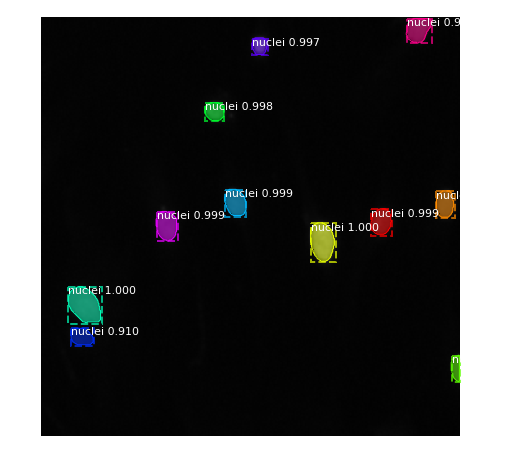

(256, 256, 11)


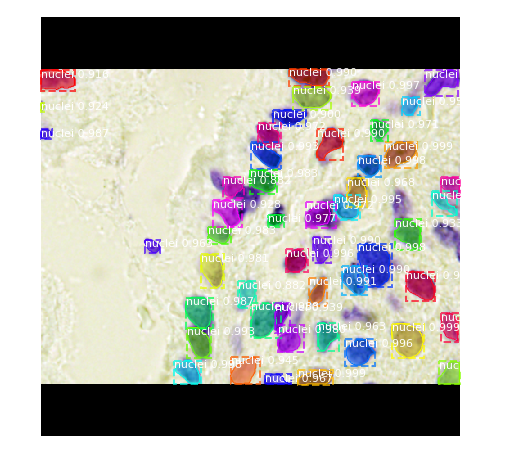

(512, 680, 49)


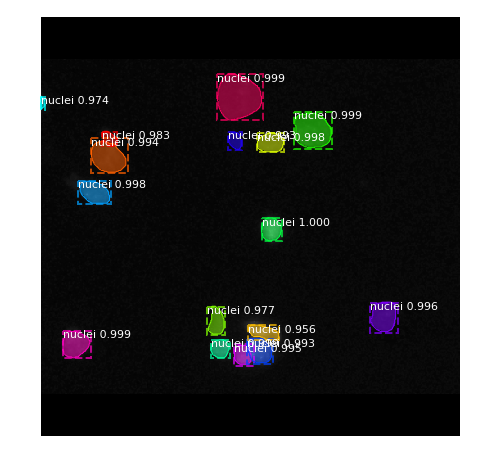

(512, 640, 16)


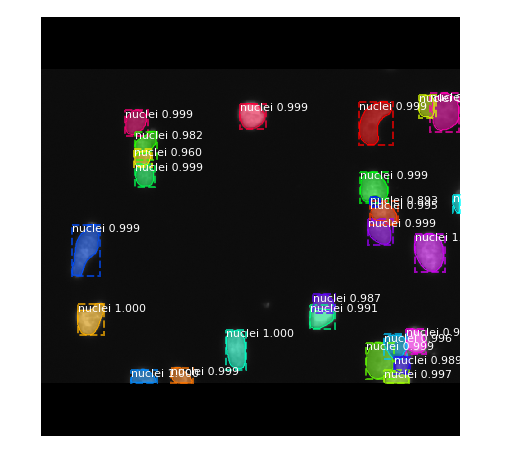

(520, 696, 26)


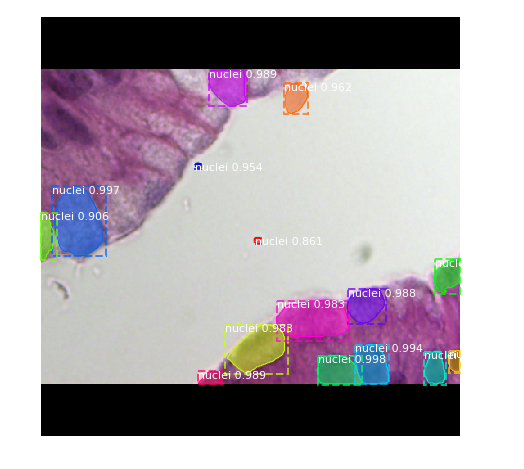

(512, 680, 15)


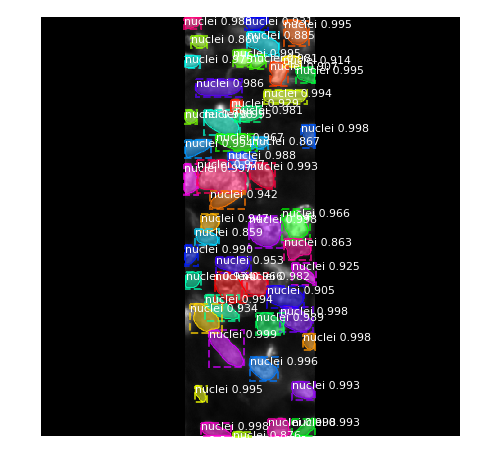

(519, 161, 51)


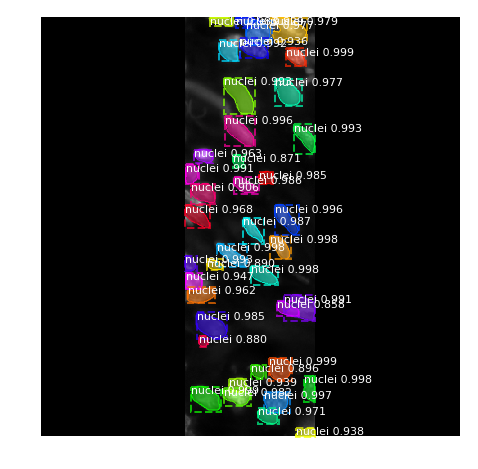

(519, 161, 40)


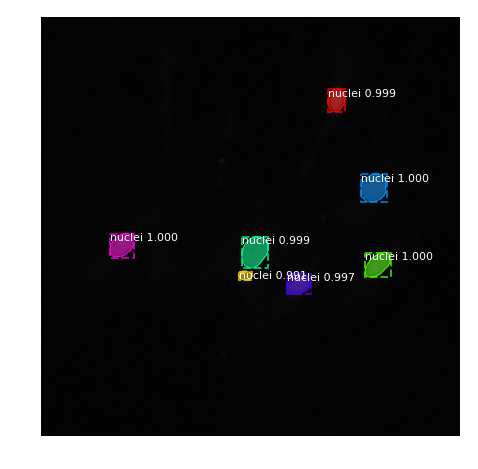

(256, 256, 7)


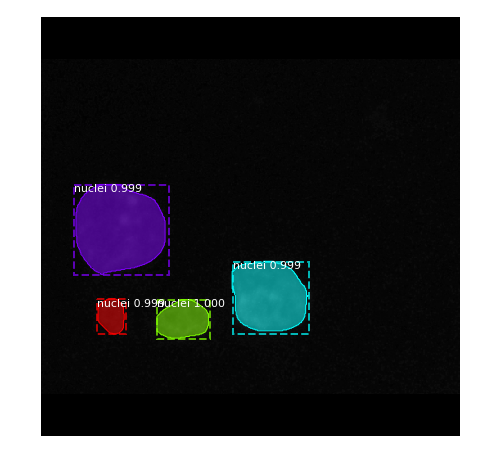

(512, 640, 4)


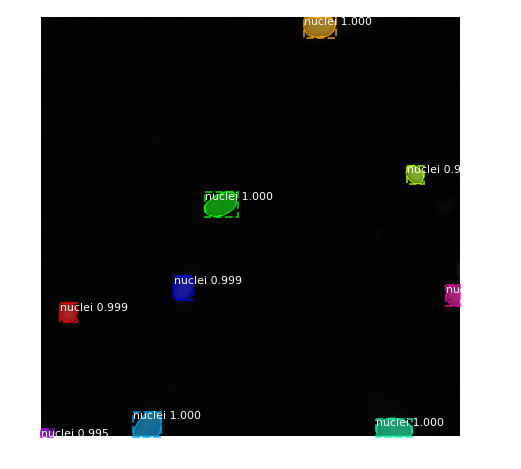

(256, 256, 9)


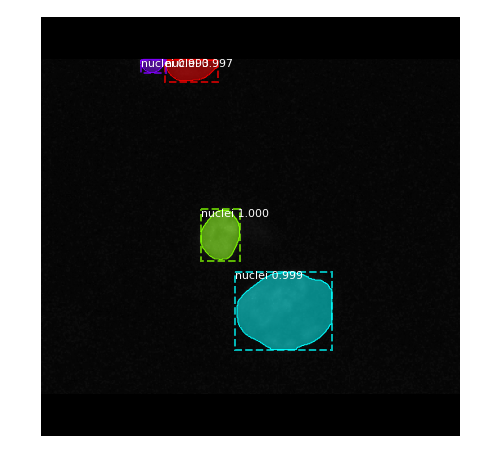

(512, 640, 4)


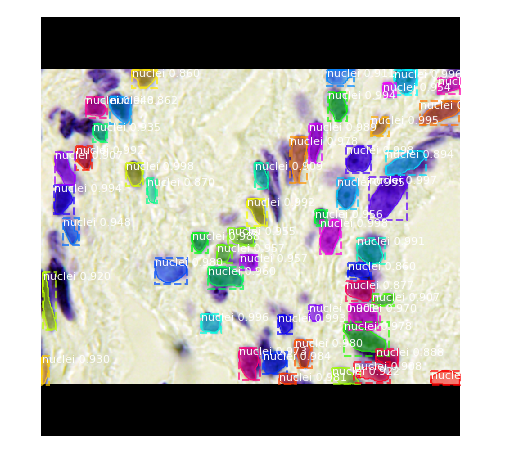

(512, 680, 52)


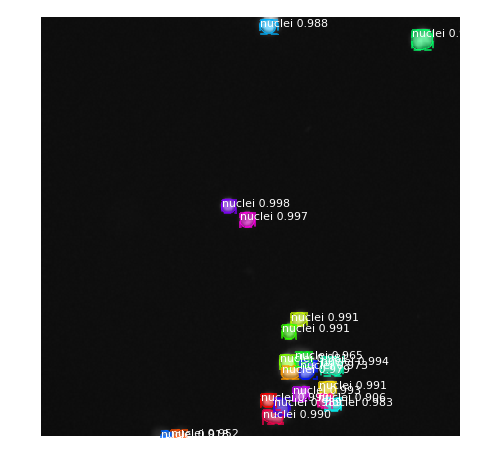

(256, 256, 20)


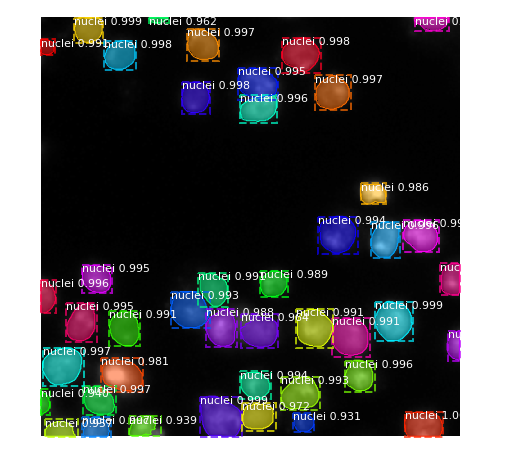

(256, 256, 43)


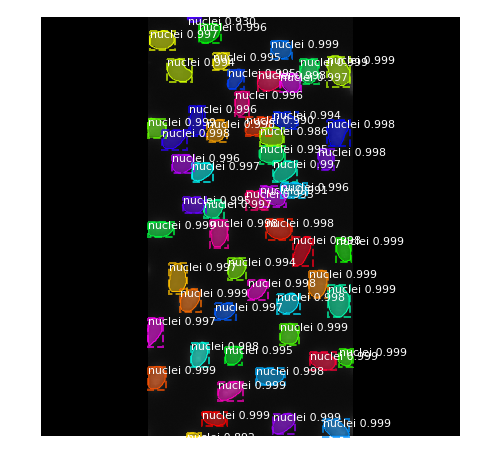

(519, 253, 56)


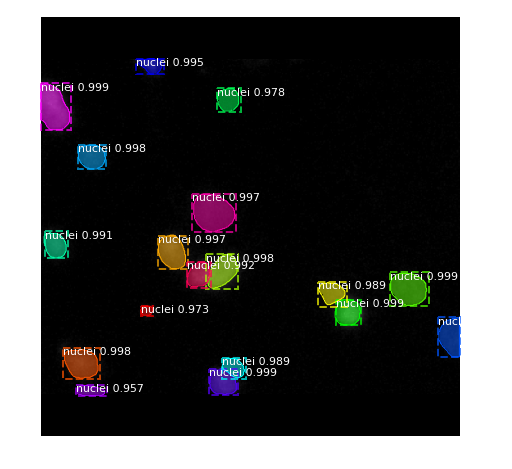

(512, 640, 18)


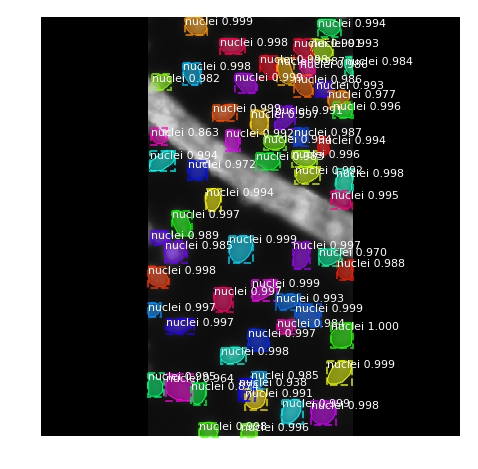

(519, 253, 61)


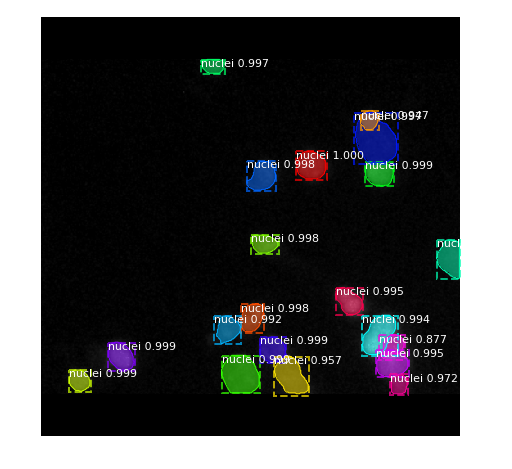

(512, 640, 20)


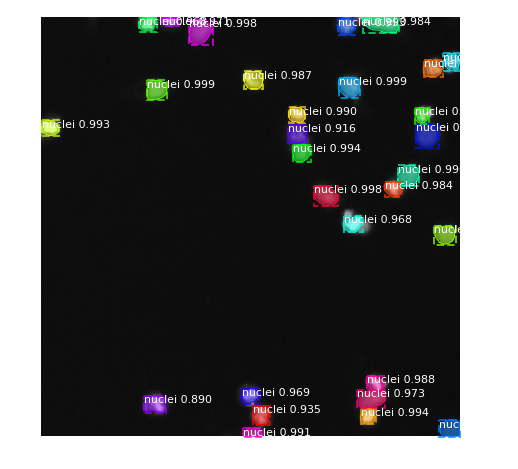

(256, 256, 29)


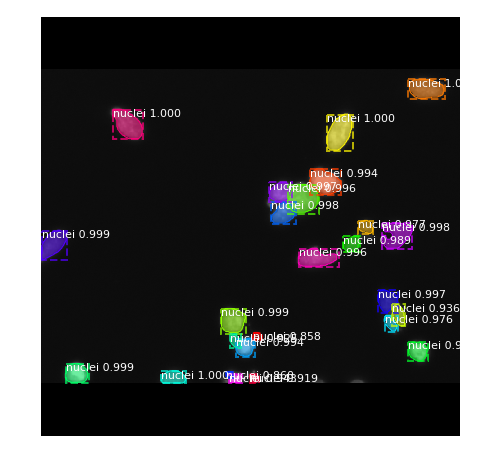

(520, 696, 25)


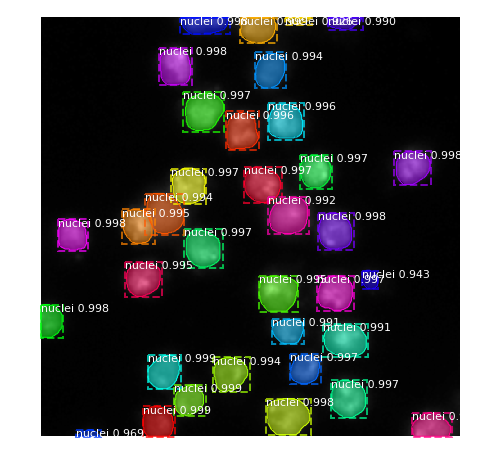

(256, 256, 35)


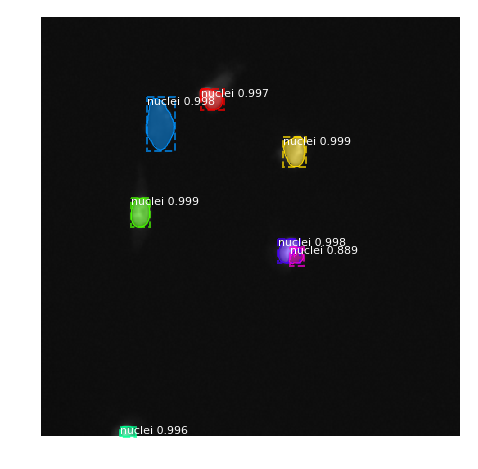

(256, 256, 7)


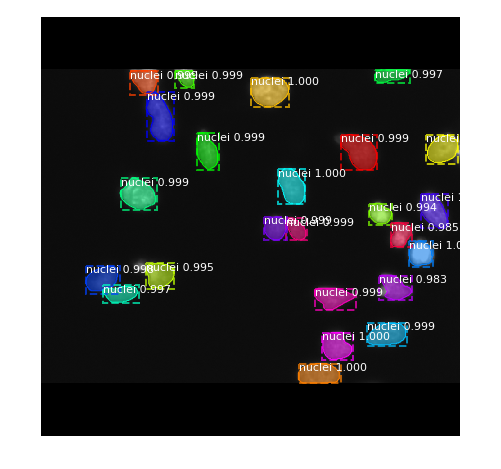

(520, 696, 24)


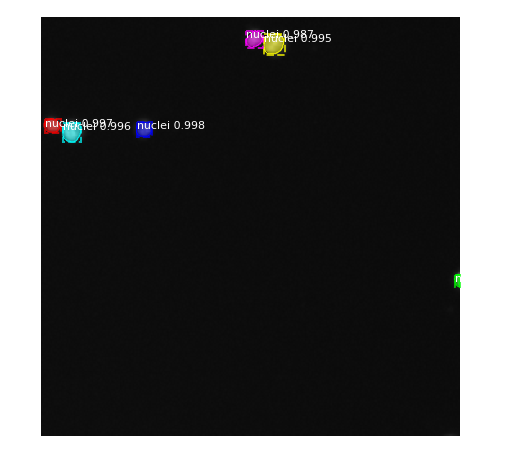

(256, 256, 6)


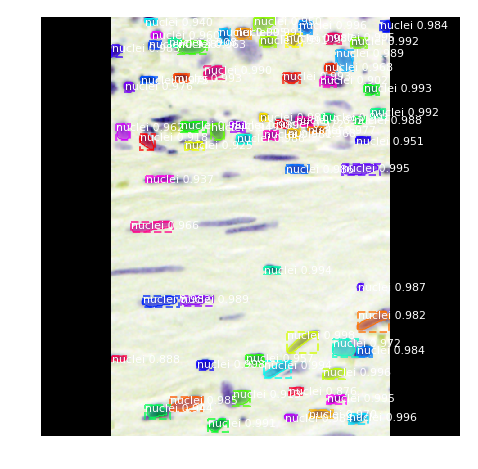

(524, 348, 67)


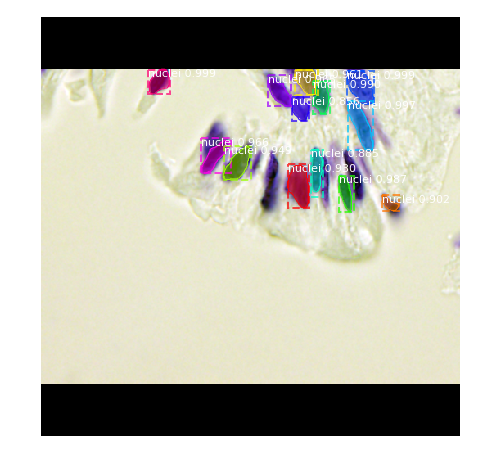

(512, 680, 13)


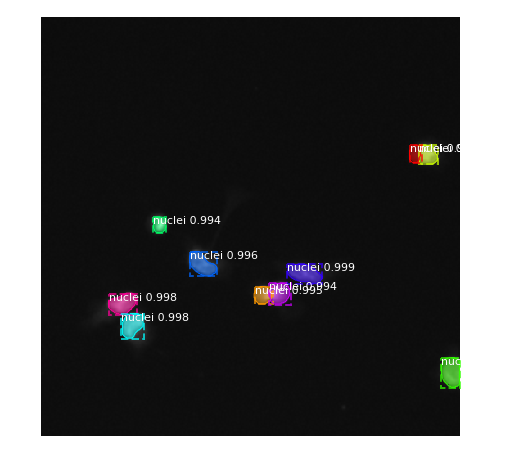

(256, 256, 10)


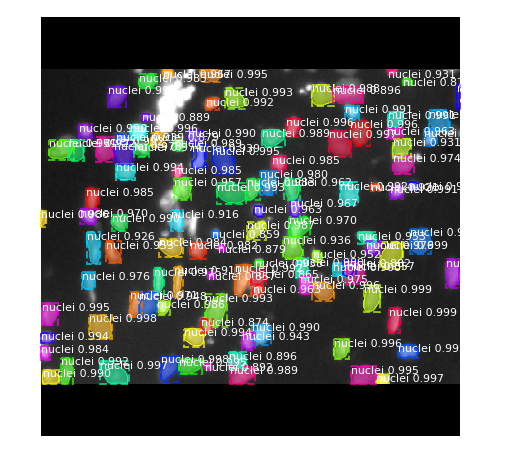

(260, 347, 110)


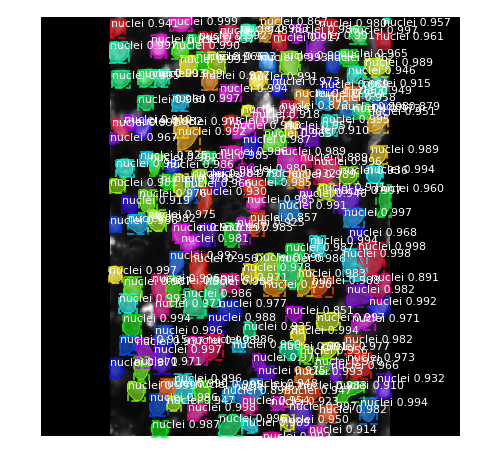

(520, 348, 179)


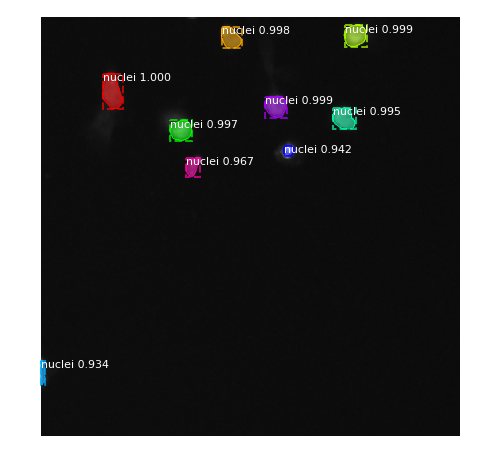

(256, 256, 9)


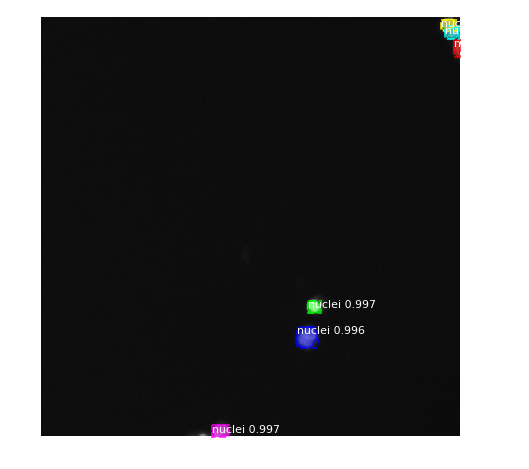

(256, 256, 6)


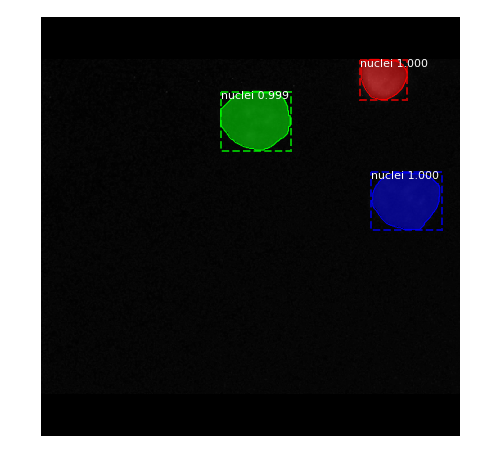

(512, 640, 3)


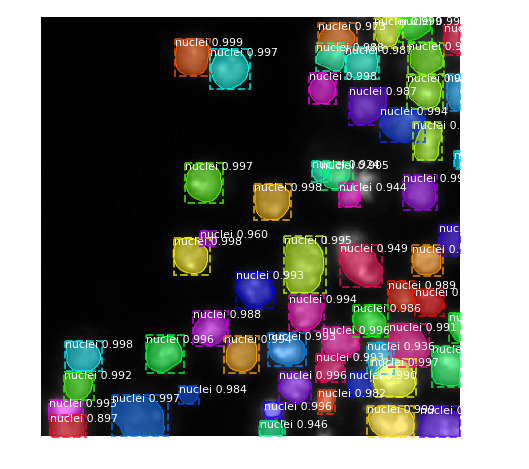

(256, 256, 57)


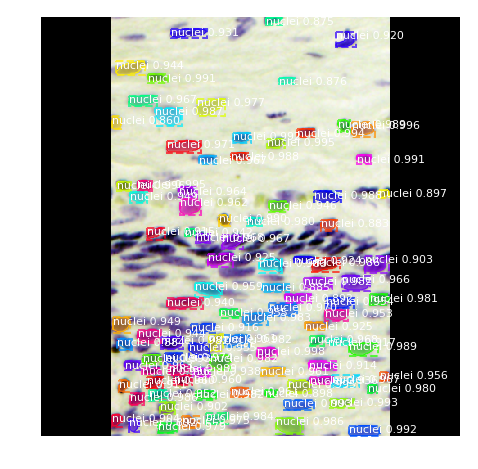

(524, 348, 96)


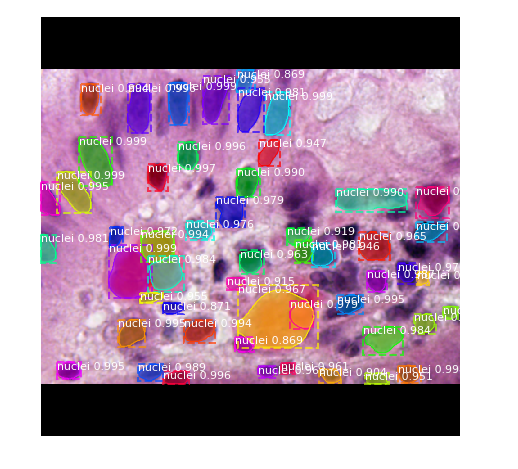

(512, 680, 52)


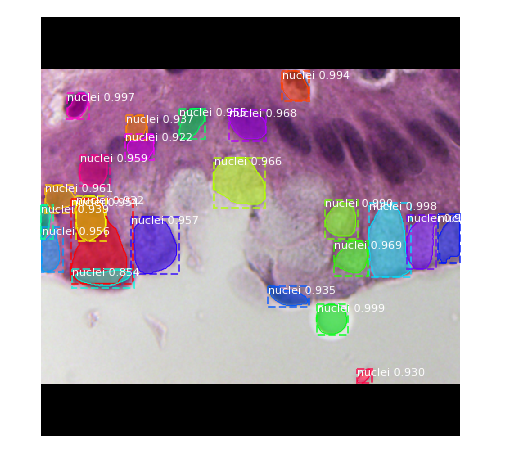

(512, 680, 23)


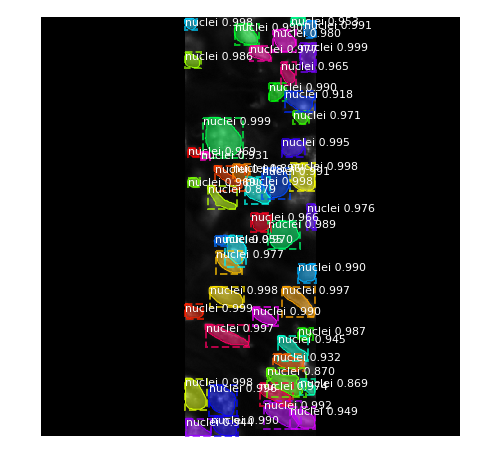

(519, 162, 47)


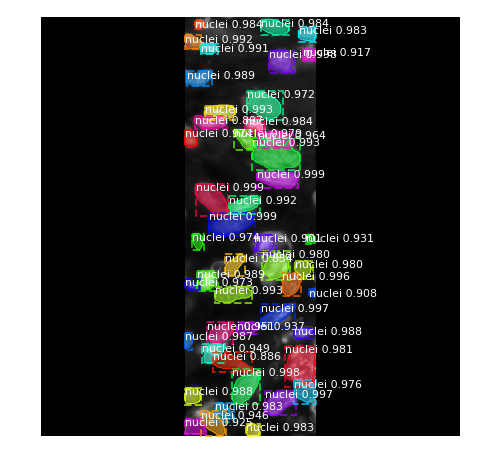

(519, 162, 47)


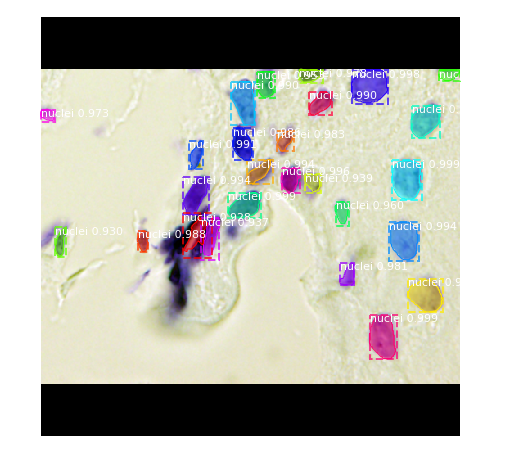

(512, 680, 26)


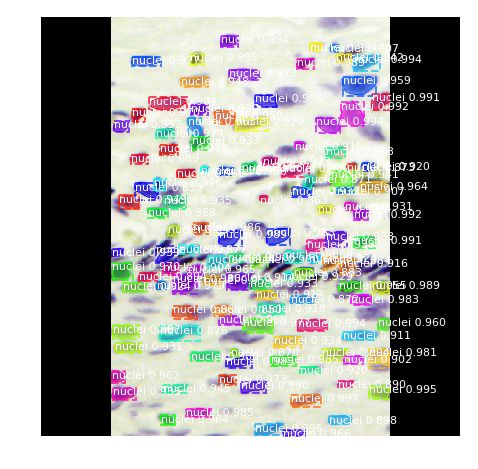

(524, 348, 117)


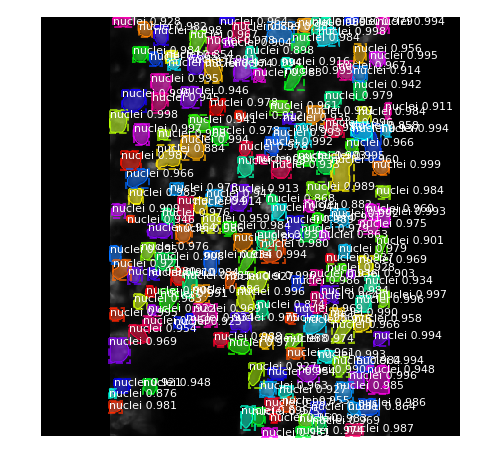

(520, 348, 177)


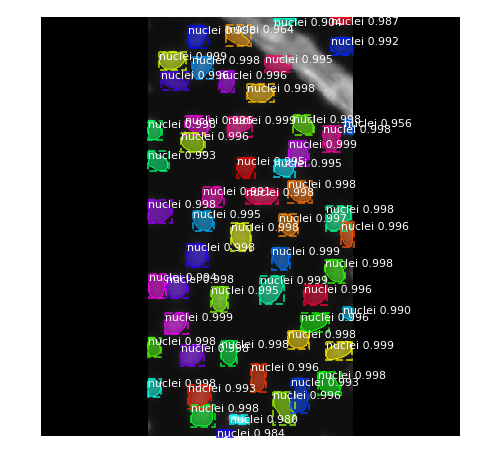

(519, 253, 56)


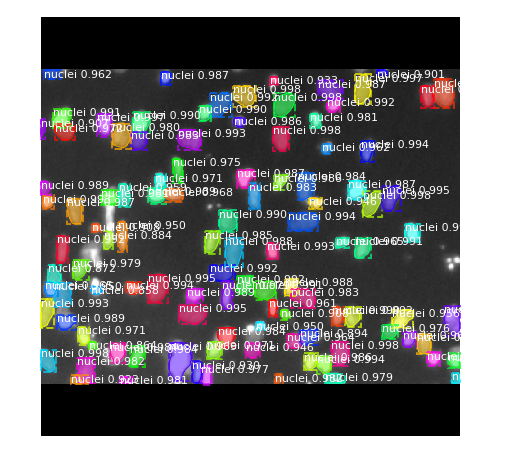

(260, 347, 106)


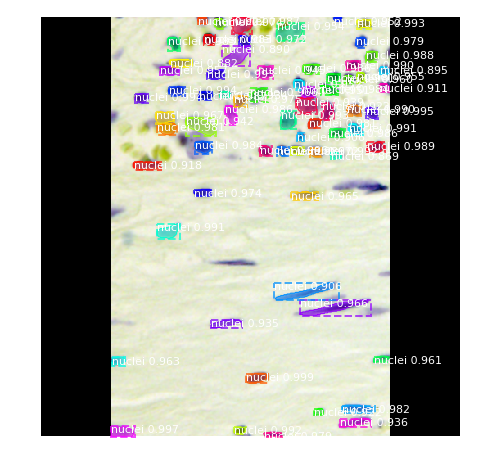

(524, 348, 68)


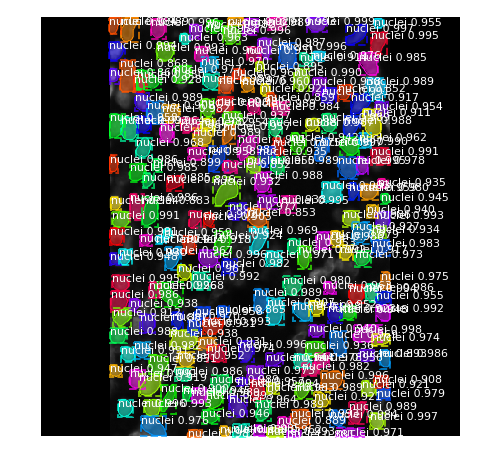

(520, 348, 211)


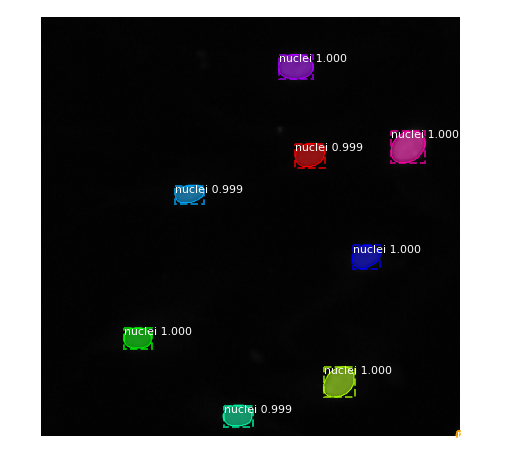

(256, 256, 9)


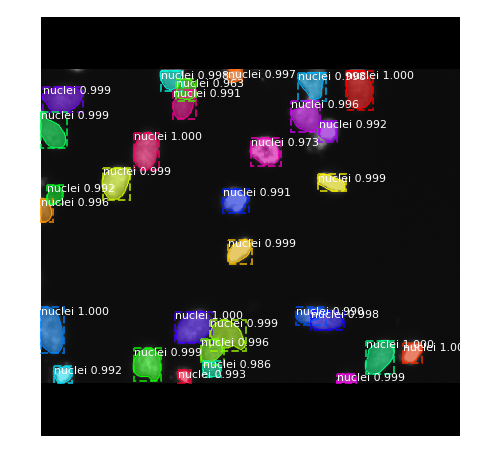

(520, 696, 31)


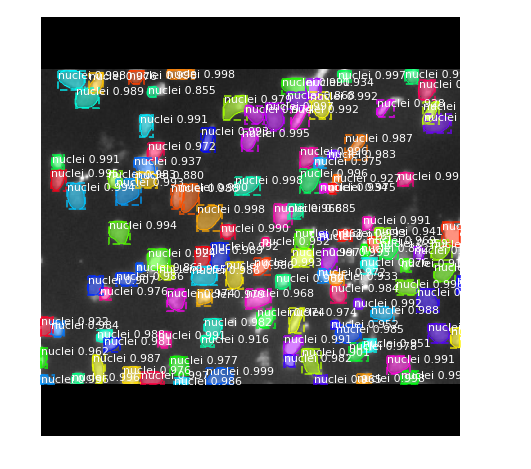

(260, 347, 119)


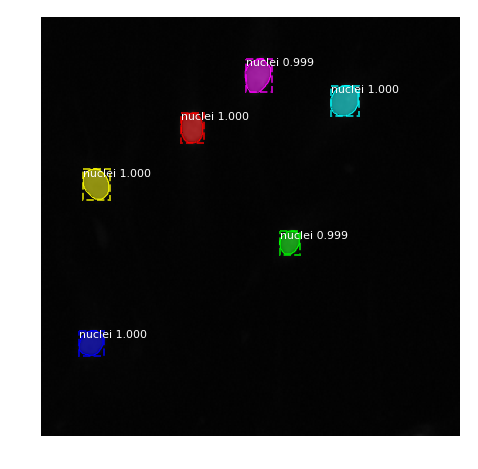

(256, 256, 6)


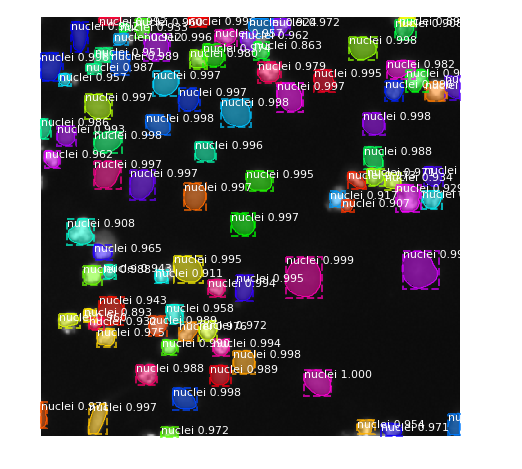

(256, 256, 87)


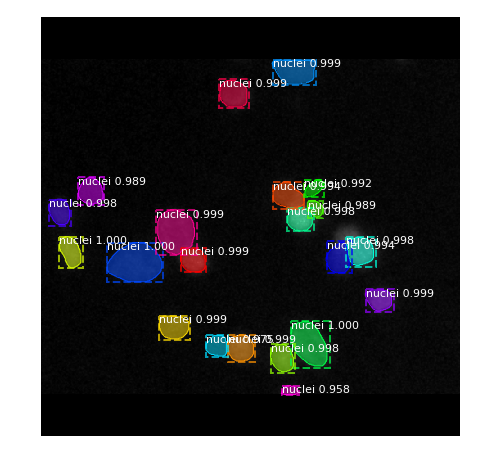

(512, 640, 21)


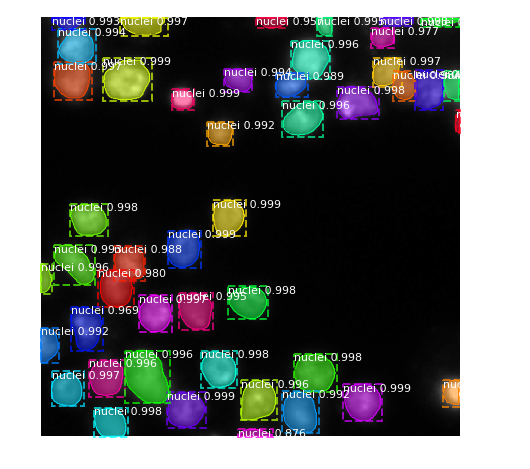

(256, 256, 46)


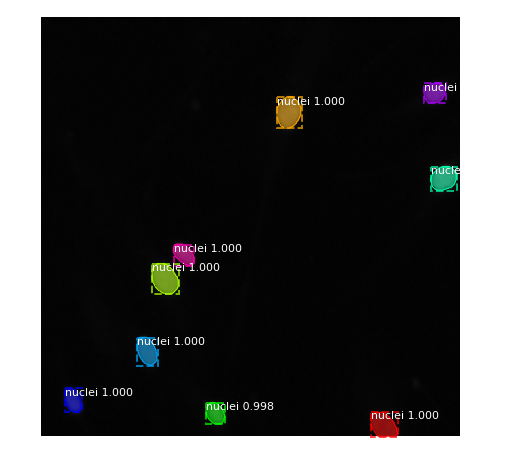

(256, 256, 9)


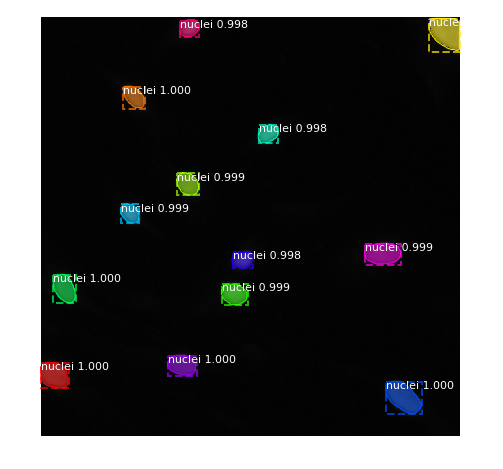

(256, 256, 13)


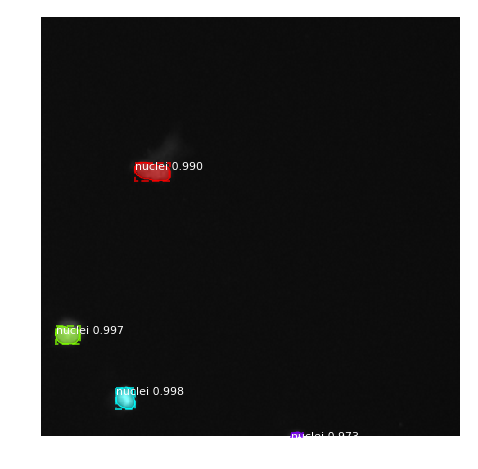

(256, 256, 4)


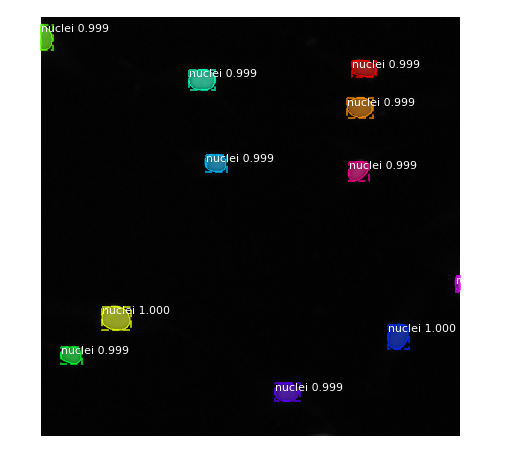

(256, 256, 11)


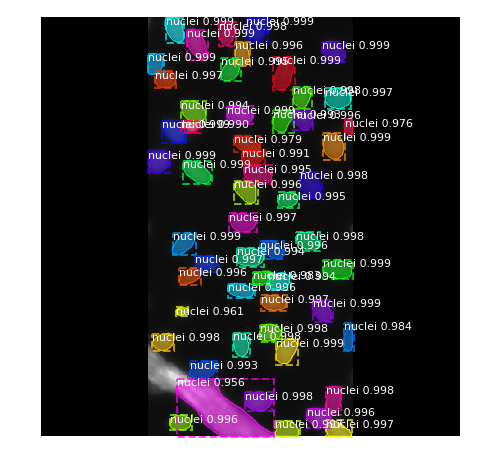

(519, 253, 55)


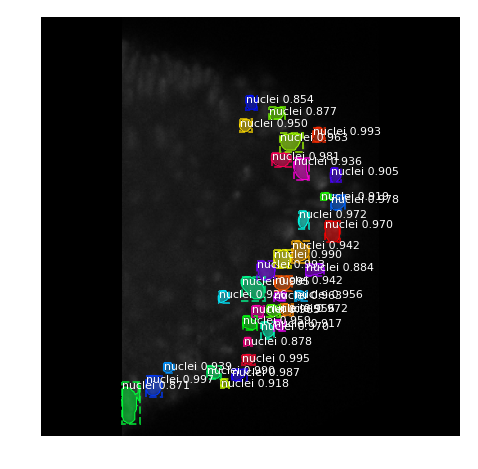

(390, 239, 35)


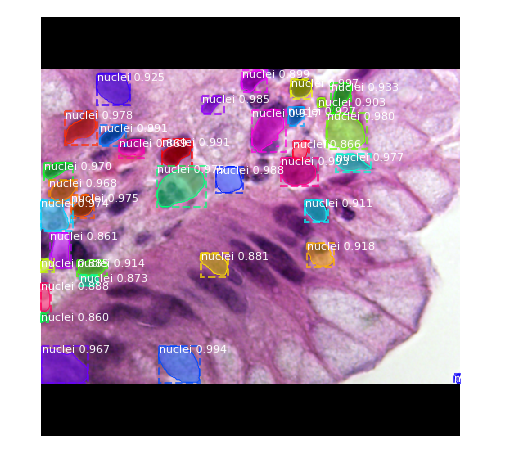

(512, 680, 34)


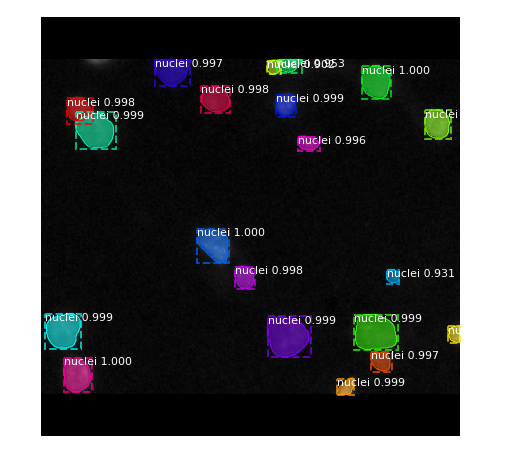

(512, 640, 20)


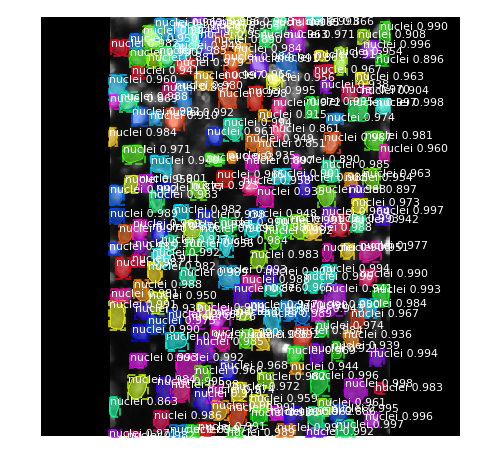

(520, 348, 198)


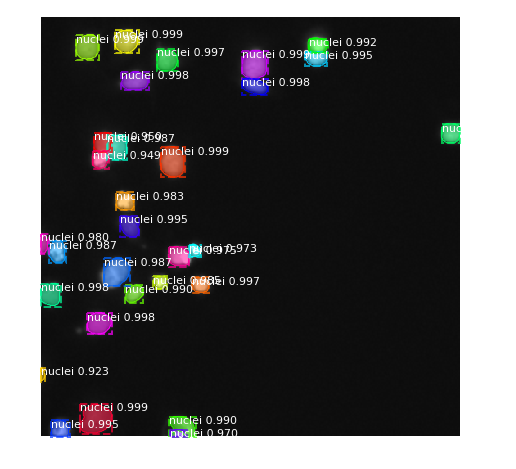

(256, 256, 30)


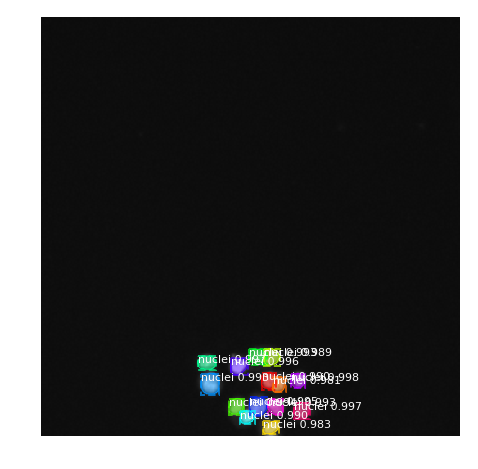

(256, 256, 14)


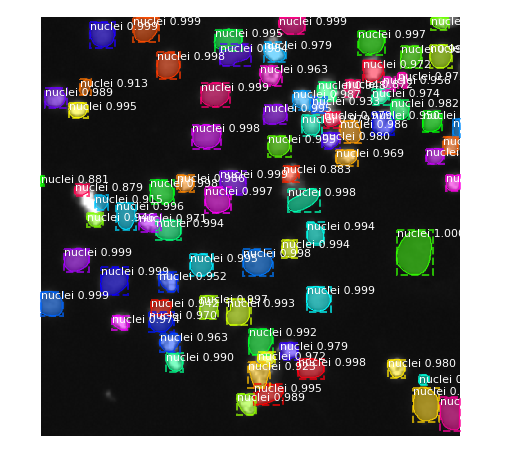

(256, 256, 80)


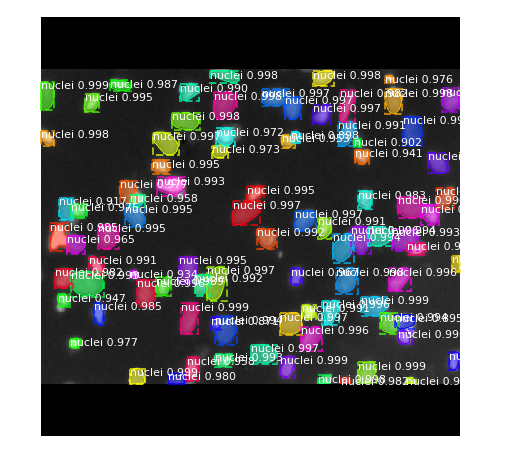

(260, 347, 88)
submision file completed!


In [25]:
import numpy as np
import pandas as pd
from skimage import morphology
from skimage.morphology import binary_closing, binary_opening, disk, binary_dilation

def run_length_encoding(x):
    dots = np.where(x.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    run_lengths = ' '.join([str(r) for r in run_lengths])
    return run_lengths


def numpy2encoding_no_overlap2(predicts, img_name, scores):
    """predicts: [H, W, N] instance binary masks
    注意： 中间可能有洞
    overlapping parts are given to the instance of highest score (i.e. DETECTION CONFIDENCE)
    """
    # refine your masks here !
#    predicts = np.apply_along_axis(refineMasks, 2, predicts)
#    for i in range(predicts.shape[2]-1):
#        predicts[:,:,i] = refineMasks(predicts[:,:,i])
#    
    print(predicts.shape)
    sum_predicts = np.sum(predicts, axis=2)
    rows, cols = np.where(sum_predicts>=2)
    
    for i in zip(rows, cols):
        instance_indicies = np.where(np.any(predicts[i[0],i[1],:]))[0]
        highest = instance_indicies[0]
        predicts[i[0],i[1],:] = predicts[i[0],i[1],:]*0
        predicts[i[0],i[1],highest] = 1
    
    ImageId = []
    EncodedPixels = []
    for i in range(predicts.shape[2]): 
        rle = run_length_encoding(predicts[:,:,i])
        if len(rle)>0:
            ImageId.append(img_name)
            EncodedPixels.append(rle)
    return ImageId, EncodedPixels

def refineMasks(mask):
    return binary_dilation(mask, disk(1))


def write2csv(file, ImageId, EncodedPixels):
    df = pd.DataFrame({ 'ImageId' : ImageId , 'EncodedPixels' : EncodedPixels})
    df.to_csv(file, index=False, columns=['ImageId', 'EncodedPixels'])


base_dir = '../DSB2018'
test_set = load_testset(os.path.join(base_dir, 'test.json'))
print("in total {} images to predict".format(len(test_set)))

ImageId = []
EncodedPixels = []
for i, test in enumerate(test_set):
    image_id =  test['image']['pathname']
    origin_img = imread(os.path.join(base_dir, 'images', test['image']['pathname']))
    resized_img,_, scale,padding = resize_image(origin_img, min_dim=512,max_dim=512, padding=True)
        
    results = model.detect([resized_img], verbose=0)
    scores = results[0]['scores']
    masks = results[0]['masks']
    visualize.display_instances(resized_img, results[0]['rois'], masks, results[0]['class_ids'], 
                            train_data.class_names, scores, ax=get_ax())
    
    reverted_masks = np.zeros((origin_img.shape[0], origin_img.shape[1], masks.shape[-1]), dtype=masks.dtype)
    for i in range(masks.shape[-1]):
        mask = masks[:,:,i]
        reverted_masks[:, :, i] = revert_resizing(mask, origin_img.shape, padding)
    
    
    ImageId_batch, EncodedPixels_batch = numpy2encoding_no_overlap2(reverted_masks, image_id[:-4], scores)
    ImageId += ImageId_batch
    EncodedPixels += EncodedPixels_batch

write2csv('crop_all_mosaic_23_0.85_rle2.csv', ImageId, EncodedPixels)
print("submision file completed!")

In [14]:
print(len(test_set))

65


In [12]:
import numpy as np
a = np.array([[1,1,0], [0,0,0], [1,0,0]])
b = np.array([[0,0,0], [0,0,0], [0,0,0]])
print(a*b)
len(np.nonzero(a*b)[0]) == 0

[[0 0 0]
 [0 0 0]
 [0 0 0]]


True

In [21]:
for i in range(1, 10):
    print(i)

1
2
3
4
5
6
7
8
9
